# ValueInvestor
## Introduction
**Background:**
- We are a portfolio investment company and we make investments in the emerging markets around the world.
- Our company profits by investing in profitable companies, buying, holding and selling company stocks based on value investing principles.
- Our goal is to establish a robust intelligent system to aid our value investing efforts using stock market data.
- We make investment decisions and based on intrinsic value of companies and do not trade on the basis of daily market volatility.
- Our profit realization strategy typically involves weekly, monthly and quarterly performance of stocks we buy or hold.

**Data Description:**
- You are given a set of portfolio companies trading data from emerging markets including 2020 Q1-Q2-Q3-Q4 2021 Q1 stock prices.
- Each company stock is provided in different sheets.
- Each market's operating days varies based on the country of the company and the market the stocks are exchanged.
- Use only 2020 data and predict with 2021 Q1 data.

**Download Data:**
- https://docs.google.com/spreadsheets/d/1MiunF_O8eNWIcfaOA4PVm668RN7FgLNA0a6U4LWf5Bk/edit?usp=sharing

**Goal(s):**
- Predict stock price valuations on a daily, weekly and monthly basis.
- Recommend BUY, HOLD, SELL decisions.
- Maximize capital returns, minimize losses.
- Ideally a loss should never happen.
- Minimize HOLD period.

**Success Metrics:**
- Evaluate on the basis of capital returns.
- Use Bollinger Bands to measure your systems effectiveness.

### Libraries

In [1]:
# Pandas configuration
import pandas as pd
pd.set_option("display.max_columns", None)
pd.set_option("max_colwidth", None)

# Basic imports
from datetime import datetime, timedelta
from numpy.lib.function_base import disp
from pandas_ta.volatility import bbands
from plotly.subplots import make_subplots
from prophet import Prophet
from termcolor import colored as cl
import math
import numpy as np
import os
import pickle
import random
import seaborn as sns
import time
import yfinance as yf

import matplotlib.dates as mdates
import matplotlib.pyplot as plt

from pmdarima import auto_arima
from pmdarima.arima.utils import ndiffs

from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, precision_score

import statsmodels.api as sm
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.ar_model import AutoReg
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.holtwinters import SimpleExpSmoothing
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller

import tensorflow as tf
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.layers import InputLayer, LSTM, Dense
from tensorflow.keras.losses import MeanSquaredError
from tensorflow.keras.metrics import RootMeanSquaredError
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam

In [2]:
# Warnings imports
import warnings
warnings.filterwarnings("ignore")
warnings.simplefilter("ignore")

### Helper function(s)

In [3]:
# Prints a horizontal line for delineating outputs
def barrier():
    print("\n <<<","-"*50,">>> \n")

# Emboldening text
def print_bold(*args):
    text = " ".join([str(i) for i in args])
    start = "\033[1m"
    end = "\033[0m"
    print(start+str(text)+end)
    return None

def bold(*args):
    text = " ".join([str(i) for i in args])
    start = "\033[1m"
    end = "\033[0m"
    return start+str(text)+end

# Underlining text
def print_underline(*args):
    text = " ".join([str(i) for i in args])
    start = "\033[4m"
    end = "\033[0m"
    print(start+str(text)+end)
    return None

def underline(*args):
    text = " ".join([str(i) for i in args])
    start = "\033[4m"
    end = "\033[0m"
    return start+str(text)+end

# Bold and Underline
def print_bold_underline(*args):
    text = " ".join([str(i) for i in args])
    start_bold = "\033[1m"
    start_underline = "\033[4m"
    end = "\033[0m"
    print(start_bold+start_underline+str(text)+end)
    return None

def bold_underline(*args):
    text = " ".join([str(i) for i in args])
    start_bold = "\033[1m"
    start_underline = "\033[4m"
    end = "\033[0m"
    return start_bold+start_underline+str(text)+end

# Print text center aligned
def print_center(*args, margin=110):
    text = " ".join([str(i) for i in args])
    print(text.center(margin))
    return None

# Display info for all countries with given dictionary
def display_for_all_keys(d):
    for key in d.keys():
        print_bold_underline(f"{key.upper()}:")
        display(d[key].head())
        display(d[key].tail())
        barrier()

## Data

### Import data
**NOTE:**
- Each sheet in `raw_data.xlsx` is structured identically with regards to features.
- Each sheet corresponds to a different country.
- Each sheet has a `Vol.` property that is of the `string` or `object` data type and uses `K` or `M` to indicate thousands or millions respectively.

In [4]:
file_name = "../data_raw/data.xlsx"
sheet_names = iter(range(8))

df_russia = pd.read_excel(file_name, sheet_name=next(sheet_names), index_col=0)
df_turkey = pd.read_excel(file_name, sheet_name=next(sheet_names), index_col=0)
df_egypt = pd.read_excel(file_name, sheet_name=next(sheet_names), index_col=0)
df_brazil = pd.read_excel(file_name, sheet_name=next(sheet_names), index_col=0)
df_argentina = pd.read_excel(file_name, sheet_name=next(sheet_names), index_col=0)
df_colombia = pd.read_excel(file_name, sheet_name=next(sheet_names), index_col=0)
df_sa = pd.read_excel(file_name, sheet_name=next(sheet_names), index_col=0)
df_korea = pd.read_excel(file_name, sheet_name=next(sheet_names), index_col=0)

dataframes = [df_russia, df_turkey, df_egypt, df_brazil, df_argentina, df_colombia, df_sa, df_korea]

- Display info on two of the dataframes.

In [5]:
display(df_russia.info())
barrier()
display(df_russia.head())

<class 'pandas.core.frame.DataFrame'>
Index: 312 entries, 2021-03-31 00:00:00 to Highest: 296.07
Data columns (total 6 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   Price     312 non-null    object 
 1   Open      312 non-null    object 
 2   High      312 non-null    object 
 3   Low       312 non-null    object 
 4   Vol.      311 non-null    object 
 5   Change %  311 non-null    float64
dtypes: float64(1), object(5)
memory usage: 17.1+ KB


None


 <<< -------------------------------------------------- >>> 



,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2021-03-31 00:00:00,291.02,294,294.42,290.26,47.00M,-0.0076
2021-03-30 00:00:00,293.25,294.86,295.72,291.5,38.81M,-0.0002
2021-03-29 00:00:00,293.3,289.72,294.09,289.26,43.68M,0.0071
2021-03-26 00:00:00,291.22,288.63,292.75,288.32,56.07M,0.0159
2021-03-25 00:00:00,286.66,286.5,287.03,283.85,35.22M,0.0030


In [6]:
display(df_colombia.info())
barrier()
display(df_colombia.head())

<class 'pandas.core.frame.DataFrame'>
Index: 304 entries, 2021-03-31 00:00:00 to Highest: 7,300.0
Data columns (total 6 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   Price     304 non-null    object 
 1   Open      304 non-null    object 
 2   High      304 non-null    object 
 3   Low       304 non-null    object 
 4   Vol.      303 non-null    object 
 5   Change %  303 non-null    float64
dtypes: float64(1), object(5)
memory usage: 16.6+ KB


None


 <<< -------------------------------------------------- >>> 



,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2021-03-31 00:00:00,5150,5100,5170,5100,212.44K,0.0098
2021-03-30 00:00:00,5100,5010,5100,5010,583.70K,0.0109
2021-03-29 00:00:00,5045,5020,5045,5015,117.54K,0.0050
2021-03-26 00:00:00,5020,5085,5085,4980,203.46K,-0.0020
2021-03-25 00:00:00,5030,5035,5045,4950,317.06K,0.0010


### Processing

In [7]:
def parse_vol(raw_x):
    x = raw_x.replace(".", "")
    if x[-1] == "K":
        x = x.replace("K", "0")
    elif x[-1] == "M":
        x = x.replace("M", "0000")
    try:
        return float(x)
    except:
        return np.nan

In [8]:
countries = ["russia", "turkey", "egypt", "brazil", "argentina", "colombia", "sa", "korea"]
data = {}

for country, df_ in zip(countries, dataframes):
    tmp_data = df_.copy().dropna()
    # Set the Date as proper dtype, and set it as index
    tmp_data.index = pd.to_datetime(tmp_data.index)
    # Parse the columns
    # Price
    tmp_data["Price"] = pd.to_numeric(tmp_data["Price"])
    # Open
    tmp_data["Open"] = pd.to_numeric(tmp_data["Open"])
    # High
    tmp_data["High"] = pd.to_numeric(tmp_data["High"])
    # Low
    tmp_data["Low"] = pd.to_numeric(tmp_data["Low"])
    # Vol.
    tmp_data["Vol."] = tmp_data["Vol."].apply(parse_vol)
    # Set the frequency of the DataFrame to b = Business days
    tmp_data = tmp_data.asfreq("b")
    # Set frequency to business days and fill the resulting na values with previous value
    tmp_data = tmp_data.fillna(method="ffill")
    # Sort the index
    tmp_data = tmp_data.sort_index()
    # Stored the processed data in the Dict
    data[country] = tmp_data

In [9]:
for key in data.keys():
    print_bold_underline(key.upper())
    print(data[key].info())
    barrier()

RUSSIA
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 324 entries, 2020-01-03 to 2021-03-31
Freq: B
Data columns (total 6 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   Price     324 non-null    float64
 1   Open      324 non-null    float64
 2   High      324 non-null    float64
 3   Low       324 non-null    float64
 4   Vol.      324 non-null    float64
 5   Change %  324 non-null    float64
dtypes: float64(6)
memory usage: 17.7 KB
None

 <<< -------------------------------------------------- >>> 

TURKEY
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 325 entries, 2020-01-02 to 2021-03-31
Freq: B
Data columns (total 6 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   Price     325 non-null    float64
 1   Open      325 non-null    float64
 2   High      325 non-null    float64
 3   Low       325 non-null    float64
 4   Vol.      325 non-null    float64
 5   Change %  325 non-null   

In [10]:
with open("../data/data_cleaned.pkl", "wb") as handle:
    pickle.dump(data, handle)

### Visual inspection

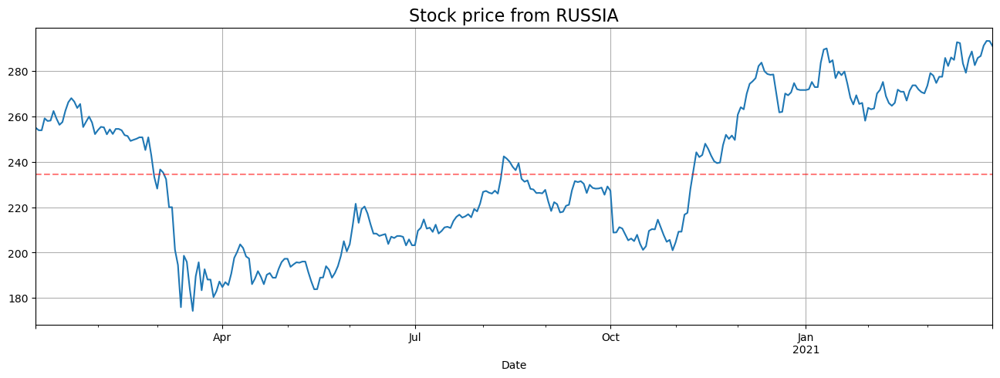

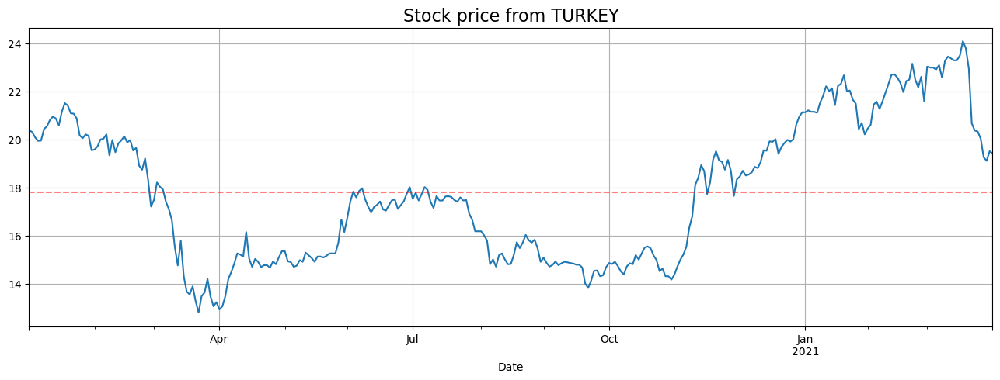

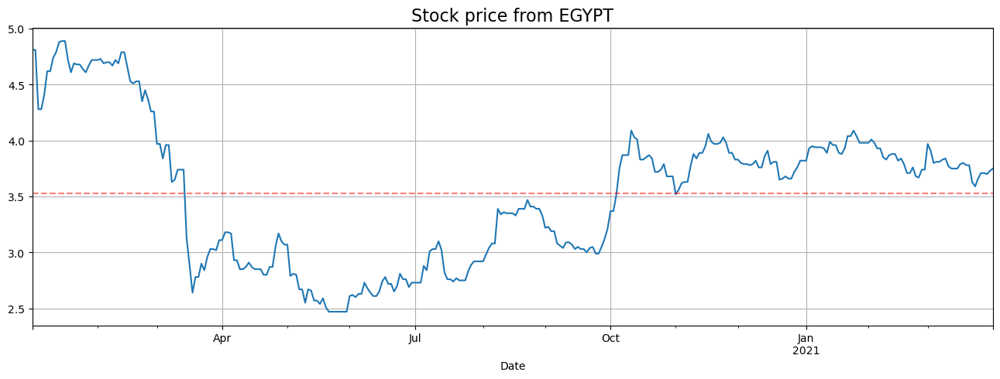

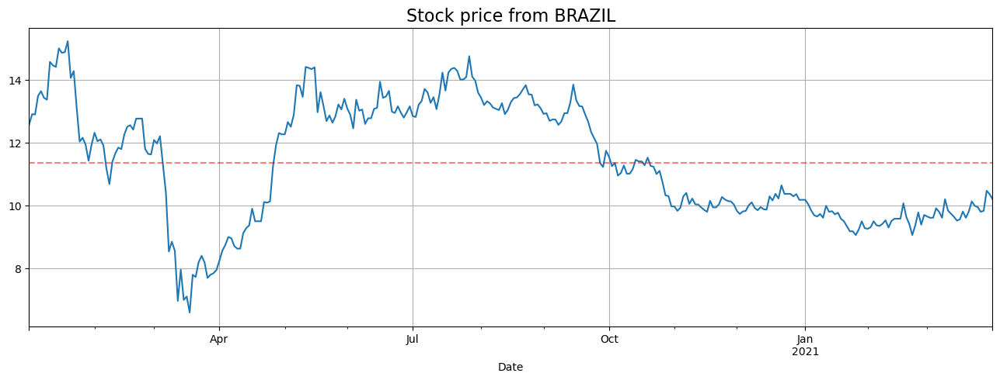

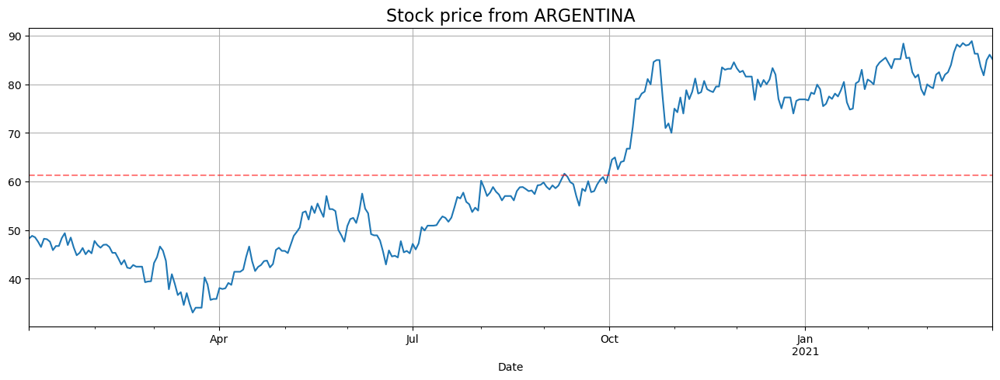

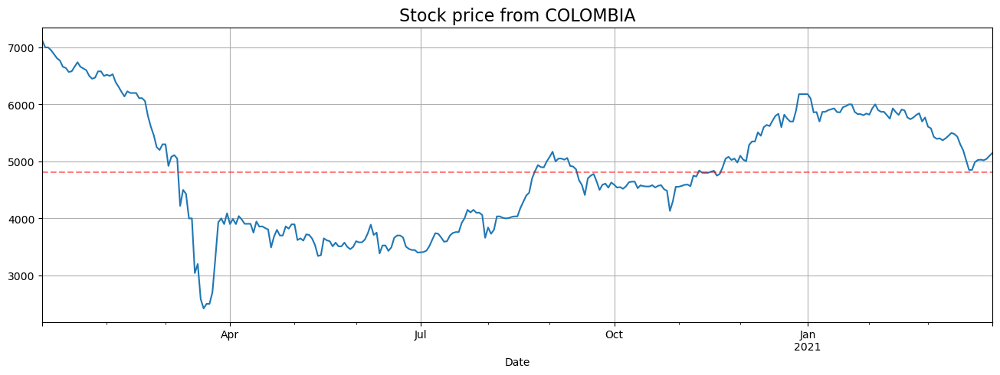

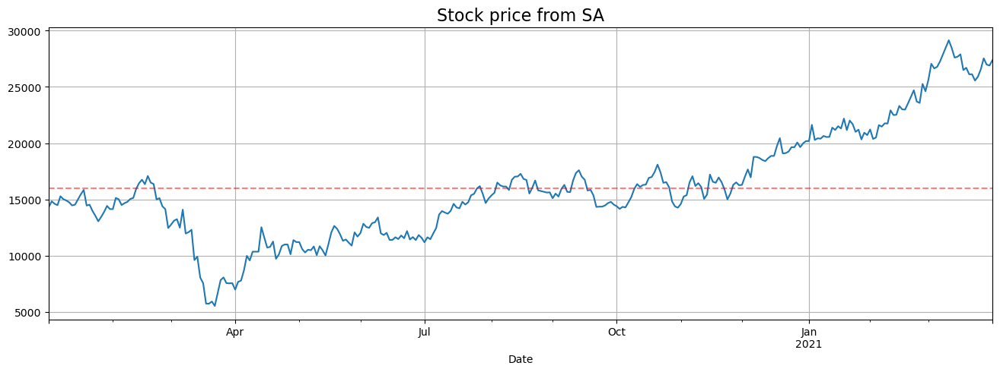

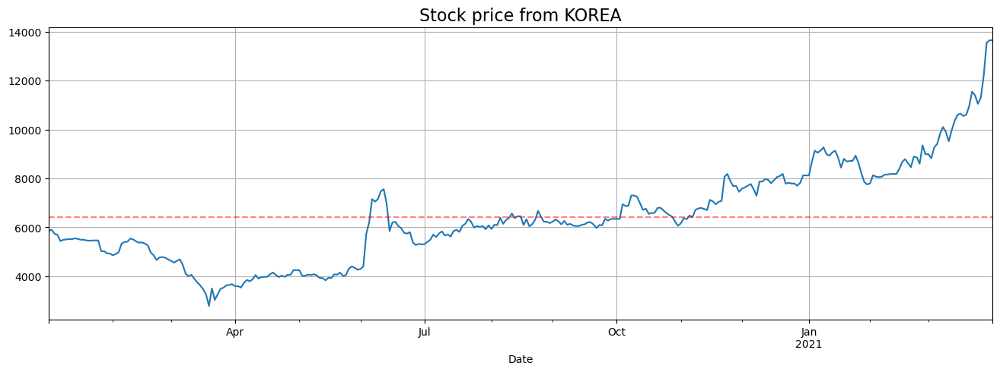

In [11]:
for key in data.keys():
    data[key]["Price"].plot(figsize=(16,5), grid="on")
    plt.axhline(y=data[key]["Price"].mean(), color="red", alpha=0.5, linestyle="--")
    plt.title(f"Stock price from {key.upper()}", fontsize=16)
    plt.show()

**NOTE:**
- We can clearly see that the Price time series are **not stationary**.
- We will confirm this with tests.

## EDA

### Stationarity

- We verify stationarity with the **Augmented Dickey-Fuller** test.

In [12]:
for key in data.keys():
    print_bold_underline(f"{key.upper()}:")
    p_price = adfuller(data[key]["Price"])
    print("The p-value of the price is: ", p_price[1])
    print(f"Reject null hypothesis: {p_price[1]<=0.05}")
    barrier()

RUSSIA:
The p-value of the price is:  0.7374602050812521
Reject null hypothesis: False

 <<< -------------------------------------------------- >>> 

TURKEY:
The p-value of the price is:  0.5749764210297081
Reject null hypothesis: False

 <<< -------------------------------------------------- >>> 

EGYPT:
The p-value of the price is:  0.24529851951451526
Reject null hypothesis: False

 <<< -------------------------------------------------- >>> 

BRAZIL:
The p-value of the price is:  0.18411806668707226
Reject null hypothesis: False

 <<< -------------------------------------------------- >>> 

ARGENTINA:
The p-value of the price is:  0.8756756136964814
Reject null hypothesis: False

 <<< -------------------------------------------------- >>> 

COLOMBIA:
The p-value of the price is:  0.1879471059211641
Reject null hypothesis: False

 <<< -------------------------------------------------- >>> 

SA:
The p-value of the price is:  0.968855539556175
Reject null hypothesis: False

 <<< ------

**NOTE:**
- All countries show data that is **non stationary**.

### ACF and PACF

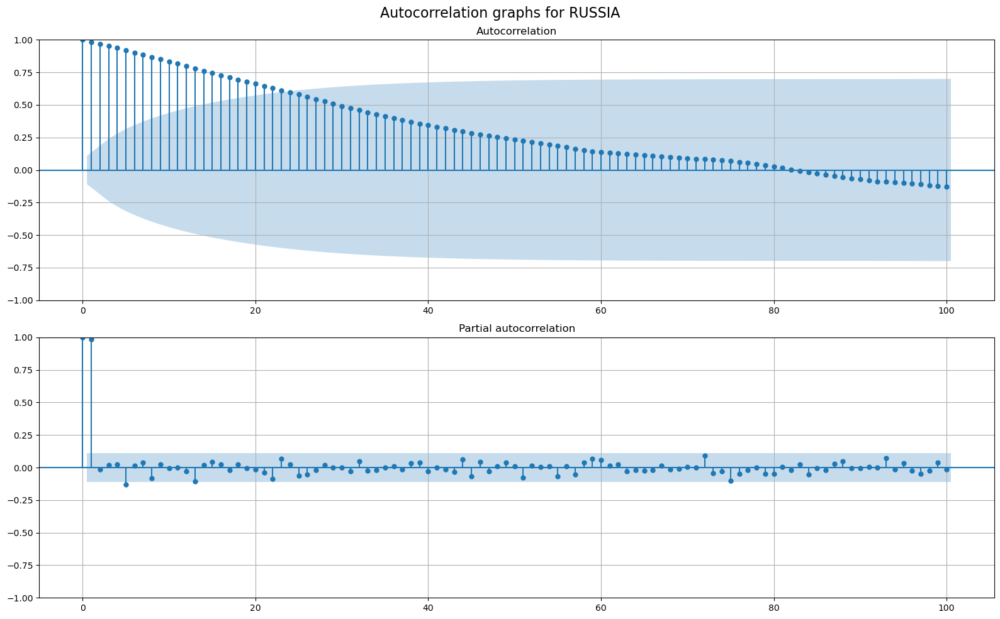

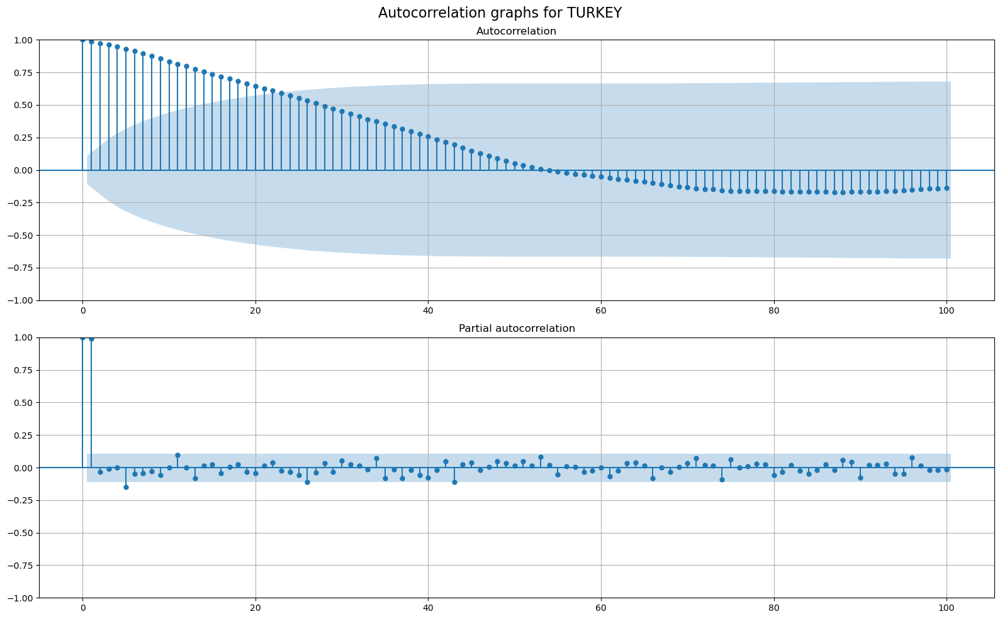

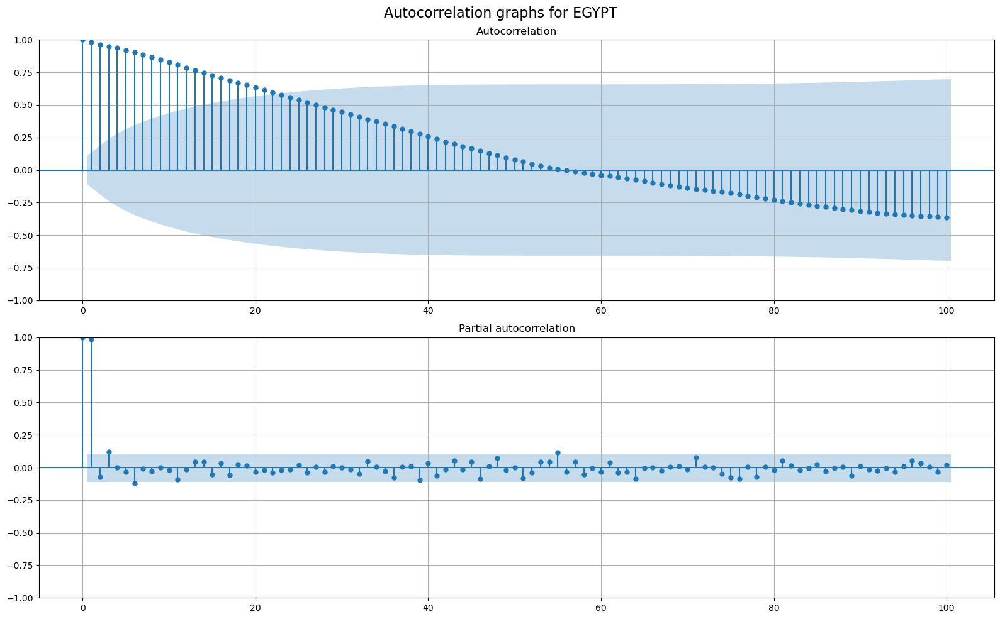

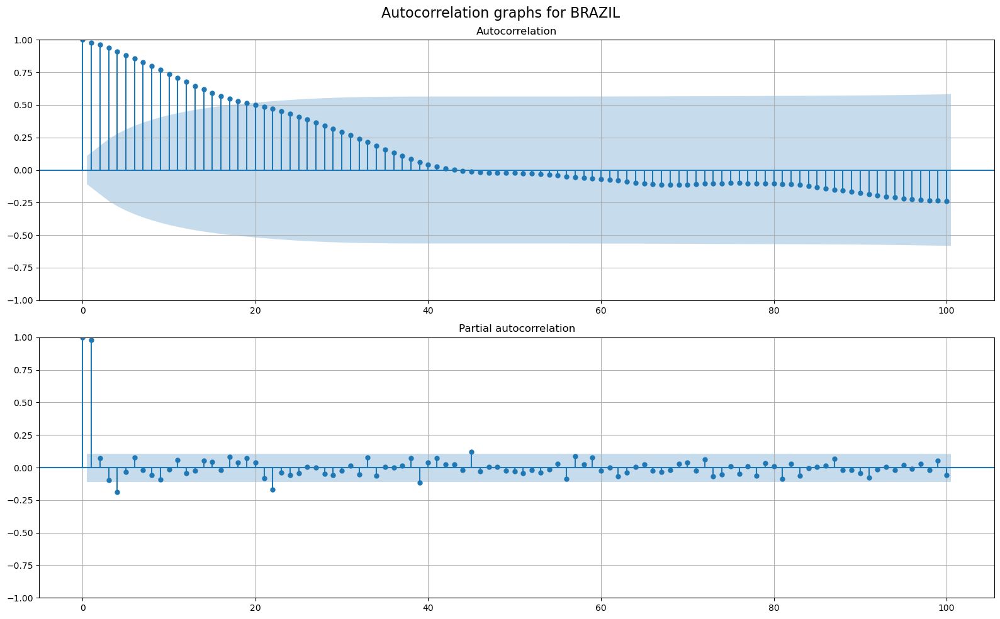

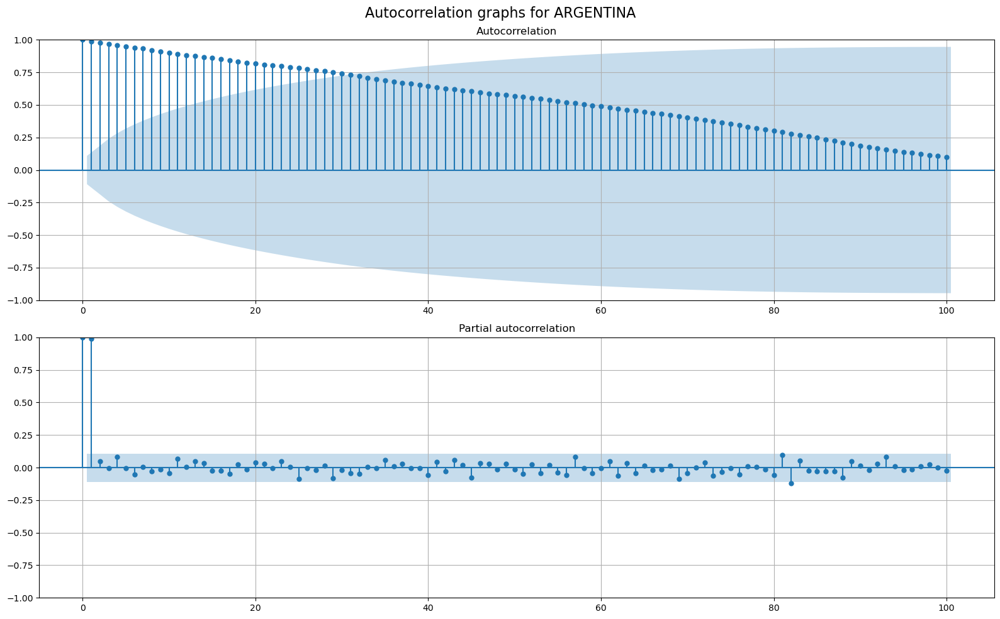

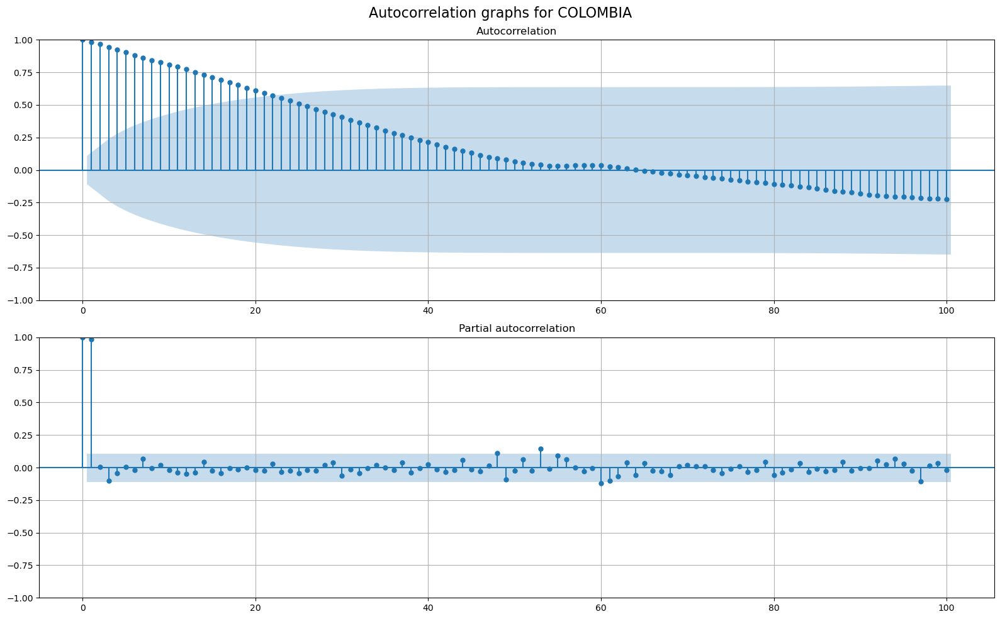

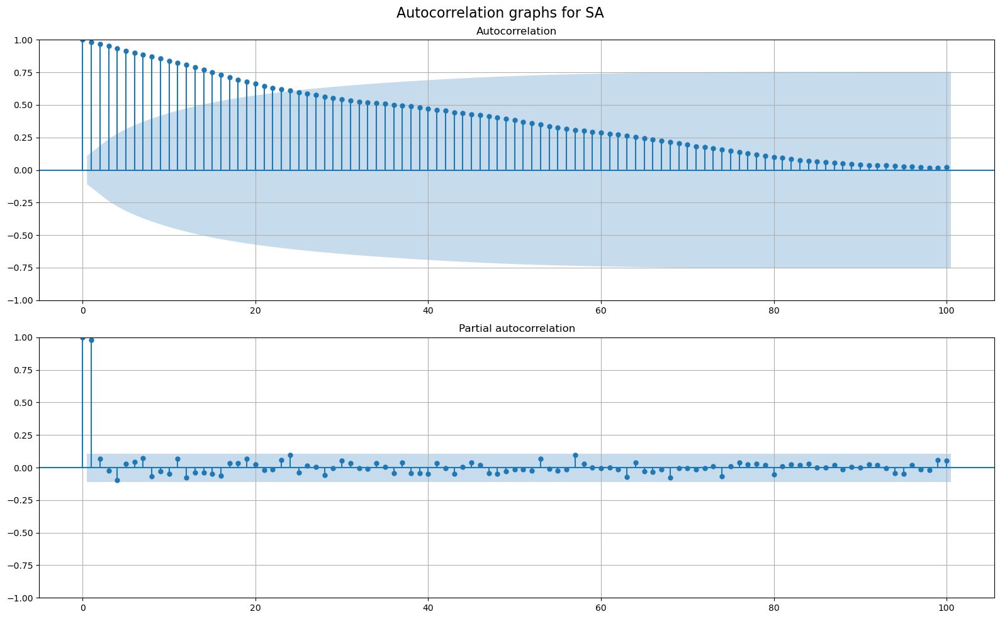

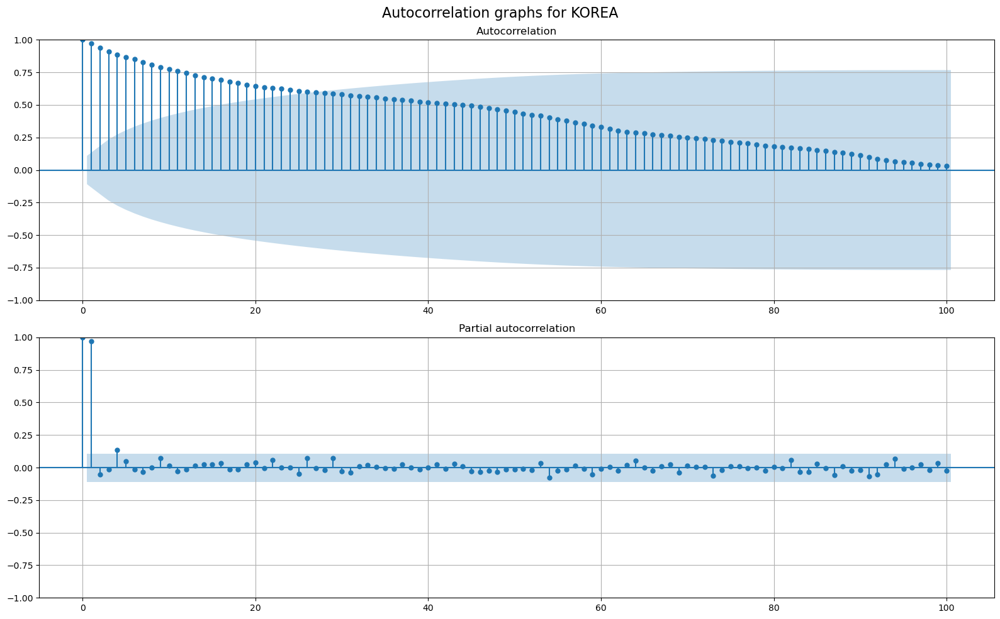

In [13]:
for key in data.keys():
    fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(16,10))
    # Plot the price autocorrelation in subplot 1
    sm.graphics.tsa.plot_acf(data[key]["Price"], lags=100, ax=axes[0])
    axes[0].set_title("Autocorrelation")
    axes[0].grid("on")
    # Plot the Change % in subplot 2
    sm.graphics.tsa.plot_pacf(data[key]["Price"], lags=100, ax=axes[1])
    axes[1].set_title("Partial autocorrelation")
    axes[1].grid("on")
    # Set the figure title
    fig.suptitle(f"Autocorrelation graphs for {key.upper()}", fontsize=16)
    plt.tight_layout()
    plt.show()

**NOTE:**
- There are **strong autocorrelation** at low lags for the `Price` values.
- All the time series show **high partial autocorrelation** at lag 1 which drops drastically starting from lag 2.
- This is expected given the highly unpredictable nature of the stock market.
- The last day's price has the strongest influence on the current price.

### Variable correlation

In [14]:
for key in data.keys():
    print_bold_underline(f"Correlation between the {key.upper()} stock Price and the other variables:")
    for col in data[key].columns.values[1:]:
        corr = data[key]["Price"].corr(data[key][col])
        print(f"{col}: {corr}")
    barrier()

Correlation between the RUSSIA stock Price and the other variables:
Open: 0.9923732435986709
High: 0.9965856814455506
Low: 0.9958753247372185
Vol.: -0.2445467342936829
Change %: 0.09200710348356826

 <<< -------------------------------------------------- >>> 

Correlation between the TURKEY stock Price and the other variables:
Open: 0.9912490999174498
High: 0.9953950569699875
Low: 0.9963351043045707
Vol.: -0.03607488484015713
Change %: 0.06923328430460793

 <<< -------------------------------------------------- >>> 

Correlation between the EGYPT stock Price and the other variables:
Open: 0.9951251052583787
High: 0.9982092764957377
Low: 0.9974903184356134
Vol.: -0.266674579732066
Change %: 0.08073916847058368

 <<< -------------------------------------------------- >>> 

Correlation between the BRAZIL stock Price and the other variables:
Open: 0.9835134835779384
High: 0.9916126013503733
Low: 0.9907169086530287
Vol.: -0.02952475226120205
Change %: 0.09905510966953808

 <<< -------------

**NOTE:**
- There is **very high correlation** between `Price` and `Open`, `High` and `Low` (as expected).
- There is **very low correlation** between `Volume` and the `Change %` have very little correlation with the `Price`.
    - We  will check their correlation with each other.

In [15]:
for key in data.keys():
    corr = data[key]["Vol."].corr(data[key]["Change %"])
    print(f"Correlation between Volume and Change % in {key.upper()}: {corr}")

Correlation between Volume and Change % in RUSSIA: 0.040685239597573516
Correlation between Volume and Change % in TURKEY: 0.2034149646771679
Correlation between Volume and Change % in EGYPT: 0.16912612721005937
Correlation between Volume and Change % in BRAZIL: 0.11335376517189778
Correlation between Volume and Change % in ARGENTINA: 0.039704783122863505
Correlation between Volume and Change % in COLOMBIA: 0.07416960383784277
Correlation between Volume and Change % in SA: -0.0696584853520833
Correlation between Volume and Change % in KOREA: 0.23963395967475626


In [16]:
for key in data.keys():
    change = data[key]["Change %"]
    corr = data[key]["Vol."].corr(abs(change))
    print(f"Correlation between Volume and abs(Change %) in {key.upper()}: {corr}")

Correlation between Volume and abs(Change %) in RUSSIA: 0.6838070487667758
Correlation between Volume and abs(Change %) in TURKEY: 0.1931332285897248
Correlation between Volume and abs(Change %) in EGYPT: 0.446502922391659
Correlation between Volume and abs(Change %) in BRAZIL: 0.24474917477111055
Correlation between Volume and abs(Change %) in ARGENTINA: 0.3296421205646324
Correlation between Volume and abs(Change %) in COLOMBIA: 0.20857270674475456
Correlation between Volume and abs(Change %) in SA: 0.5024578776110344
Correlation between Volume and abs(Change %) in KOREA: 0.3039434713121262


**NOTE:**
- Correlation between `Volume` and the `Change %` shows no consistent patterns.

## Modeling

### Auto ARIMA

In [17]:
models_auto_arima = {}
train_end = datetime(2020, 12, 31)

for key in data.keys():
    train_data = data[key]["Price"][:train_end]
    model = auto_arima(train_data)
    print_bold_underline(f"{key.upper()}:")
    print(model.summary())
    models_auto_arima[key] = model
    barrier()

RUSSIA:
                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                  260
Model:               SARIMAX(3, 1, 2)   Log Likelihood                -764.125
Date:                Tue, 23 Jul 2024   AIC                           1540.251
Time:                        11:12:16   BIC                           1561.592
Sample:                    01-03-2020   HQIC                          1548.831
                         - 12-31-2020                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -1.1122      0.111    -10.062      0.000      -1.329      -0.896
ar.L2         -0.8209      0.108     -7.589      0.000      -1.033      -0.609
ar.L3         -0.1540      0.042     -3.651 

COLOMBIA:
                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                  261
Model:               SARIMAX(3, 2, 2)   Log Likelihood               -1668.405
Date:                Tue, 23 Jul 2024   AIC                           3348.809
Time:                        11:12:28   BIC                           3370.150
Sample:                    01-02-2020   HQIC                          3357.389
                         - 12-31-2020                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.7852      0.172     -4.576      0.000      -1.122      -0.449
ar.L2          0.1528      0.056      2.713      0.007       0.042       0.263
ar.L3          0.1982      0.038      5.24

**NOTE:**
- We notice that all of the models computed by the auto_arima are fairly simple.
    - The maximum lag considered is 3.
    - This was expected from the EDA.
- We further observe that the optimal model of four countries (Argentina, Turkey, South Africa and South Korea) is a **simple integrator**.

In [18]:
models_auto_arima

{'russia': ARIMA(order=(3, 1, 2), scoring_args={}, suppress_warnings=True,
       with_intercept=False),
 'turkey': ARIMA(order=(0, 1, 0), scoring_args={}, suppress_warnings=True,
       with_intercept=False),
 'egypt': ARIMA(order=(2, 1, 2), scoring_args={}, suppress_warnings=True,
       with_intercept=False),
 'brazil': ARIMA(order=(2, 1, 2), scoring_args={}, suppress_warnings=True,
       with_intercept=False),
 'argentina': ARIMA(order=(0, 1, 0), scoring_args={}, suppress_warnings=True,
       with_intercept=False),
 'colombia': ARIMA(order=(3, 2, 2), scoring_args={}, suppress_warnings=True,
       with_intercept=False),
 'sa': ARIMA(order=(0, 1, 0), scoring_args={}, suppress_warnings=True,
       with_intercept=False),
 'korea': ARIMA(order=(0, 1, 0), scoring_args={}, suppress_warnings=True,
       with_intercept=False)}

In [19]:
with open("../data/models_auto_arima.pkl", "wb") as handle:
    pickle.dump(models_auto_arima, handle)

#### Performance analysis

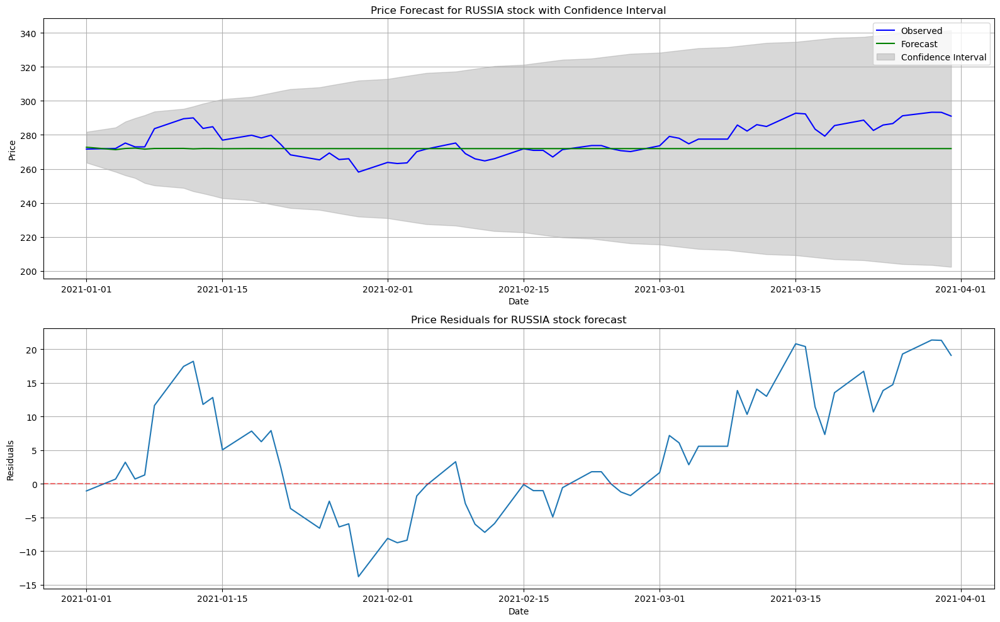

Mean Absolute Percent Error: 0.028
Root Mean Squared Error: 10.086

 <<< -------------------------------------------------- >>> 



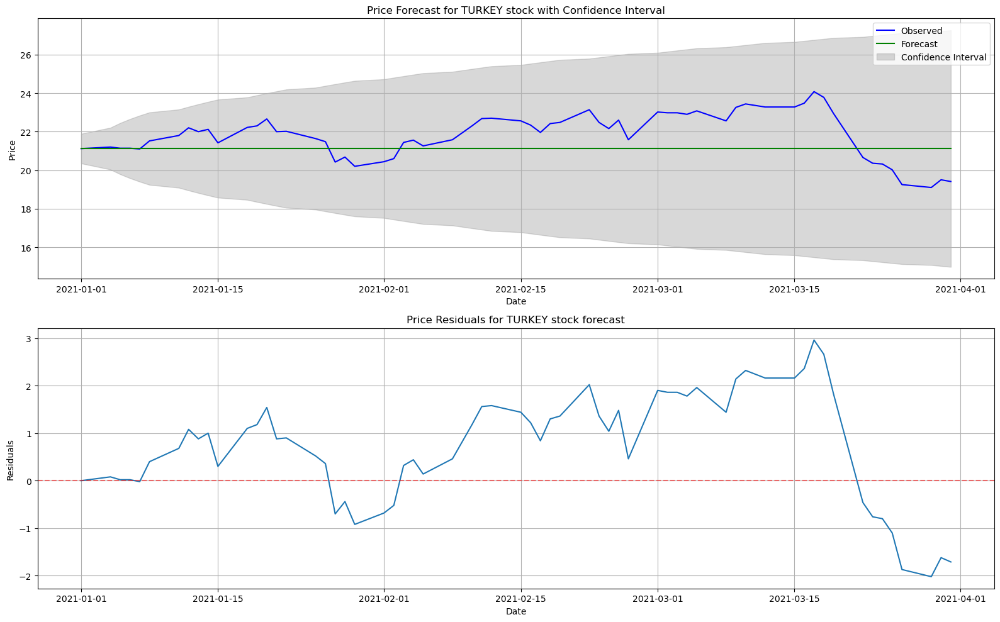

Mean Absolute Percent Error: 0.053
Root Mean Squared Error: 1.3809

 <<< -------------------------------------------------- >>> 



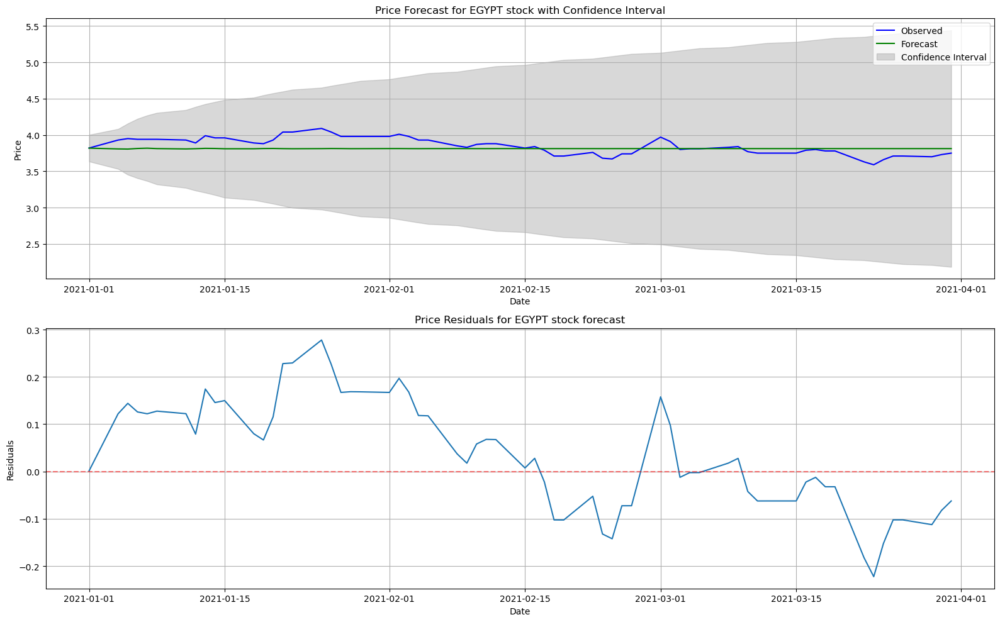

Mean Absolute Percent Error: 0.026
Root Mean Squared Error: 0.1207

 <<< -------------------------------------------------- >>> 



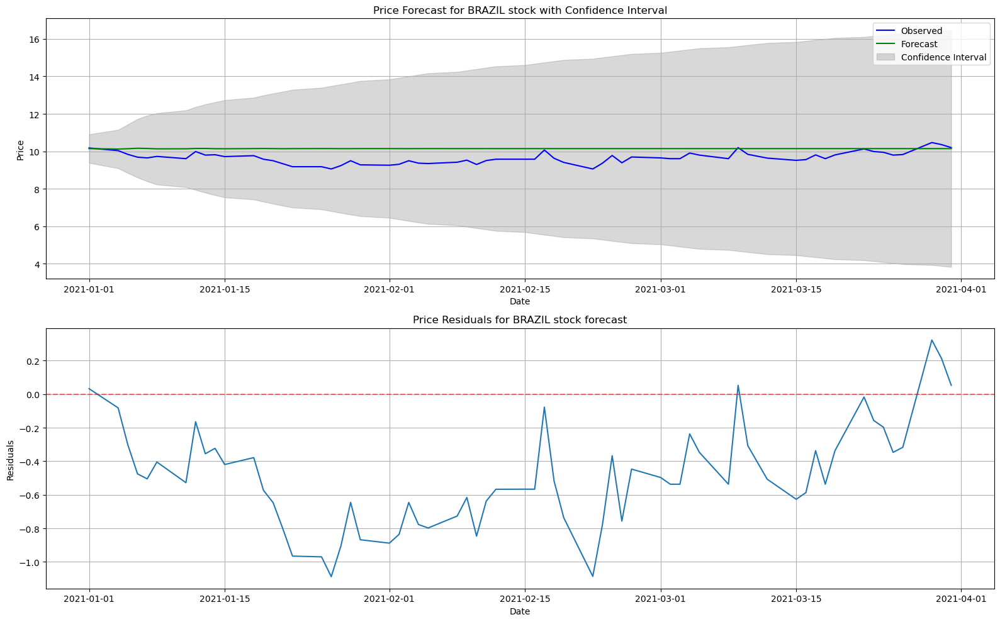

Mean Absolute Percent Error: 0.0538
Root Mean Squared Error: 0.5753

 <<< -------------------------------------------------- >>> 



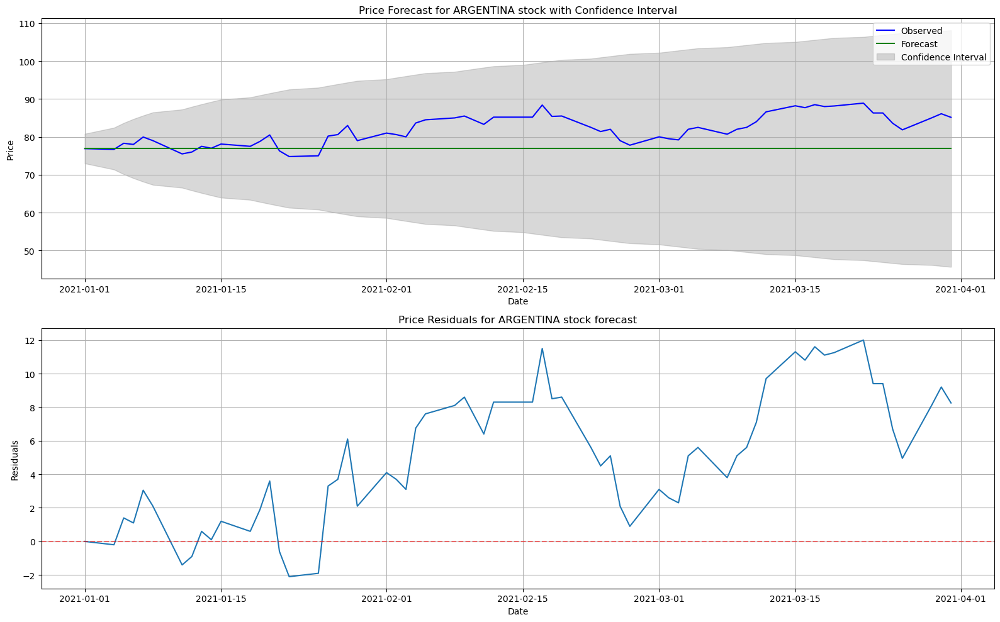

Mean Absolute Percent Error: 0.0629
Root Mean Squared Error: 6.366

 <<< -------------------------------------------------- >>> 



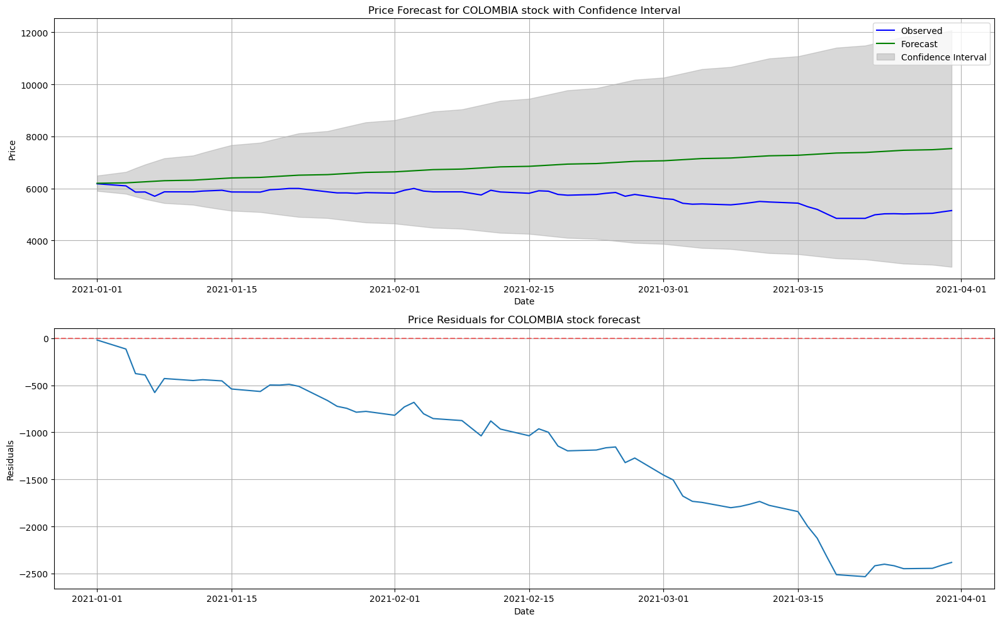

Mean Absolute Percent Error: 0.2236
Root Mean Squared Error: 1405.9817

 <<< -------------------------------------------------- >>> 



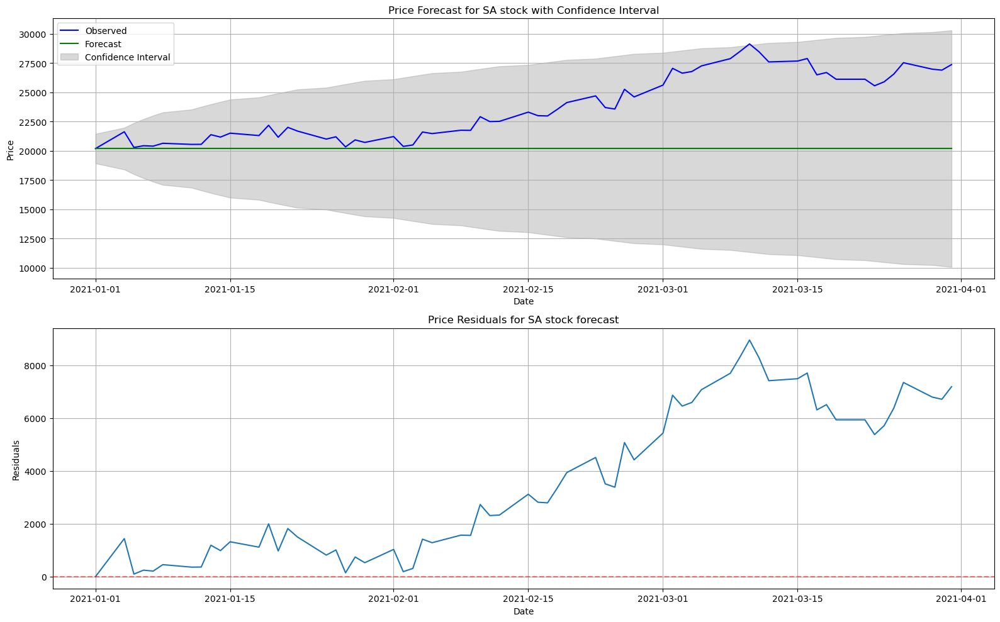

Mean Absolute Percent Error: 0.1382
Root Mean Squared Error: 4506.5862

 <<< -------------------------------------------------- >>> 



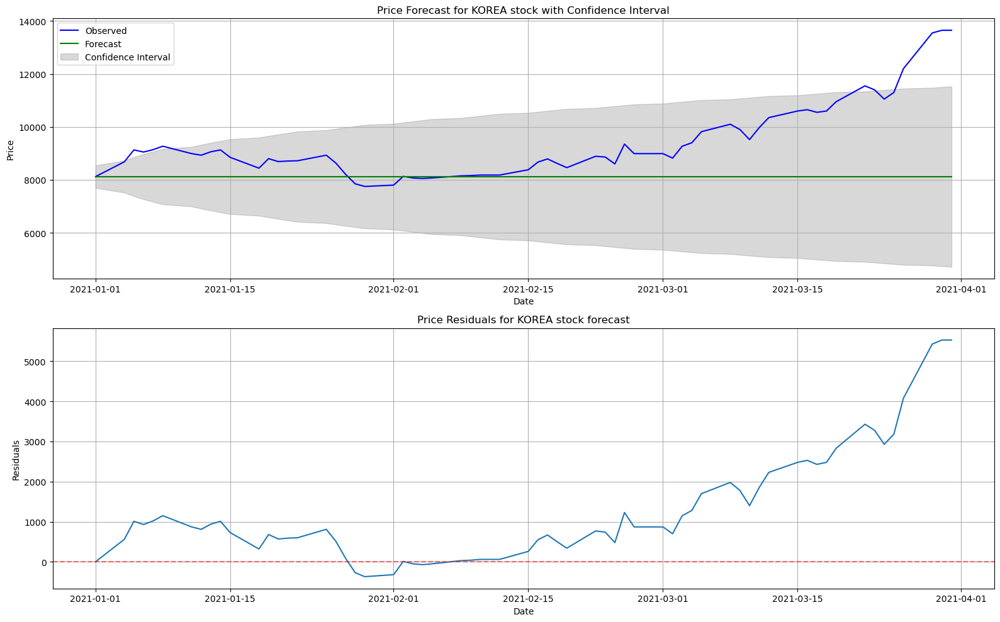

Mean Absolute Percent Error: 0.1216
Root Mean Squared Error: 1861.4729

 <<< -------------------------------------------------- >>> 



In [20]:
performance = pd.DataFrame(columns=["Country", "Error", "Price", "All", "Open", "High", "Low", "Vol.", "Change %"])
performance.set_index(["Country", "Error"], inplace=True)
train_end = datetime(2020,12,31)

for key in data.keys():
    train_set = data[key]["Price"][:train_end]
    test_set = data[key]["Price"][train_end+timedelta(days=1):]
    n_forecast_periods = len(test_set)
    forecast, conf_int = models_auto_arima[key].predict(n_periods=n_forecast_periods, return_conf_int=True)
    residuals = test_set - forecast
    # Plot the observed data
    fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(16,10))
    axes[0].plot(test_set, label="Observed", color="blue")
    # Plot the forecasts and confidence intervals
    axes[0].plot(forecast, label="Forecast", color="green")
    axes[0].fill_between(forecast.index, conf_int[:, 0], conf_int[:, 1], color="gray", alpha=0.3,
                         label="Confidence Interval")
    # Customize the plot
    axes[0].set_title(f"Price Forecast for {key.upper()} stock with Confidence Interval")
    axes[0].set_xlabel("Date")
    axes[0].set_ylabel("Price")
    axes[0].legend()
    axes[0].grid(True)
    axes[1].plot(residuals)
    axes[1].axhline(y=0, color="red", alpha=0.5, linestyle="--")
    # Customize the plot
    axes[1].set_title(f"Price Residuals for {key.upper()} stock forecast")
    axes[1].set_xlabel("Date")
    axes[1].set_ylabel("Residuals")
    axes[1].grid(True)
    # Show the plot
    plt.tight_layout()
    plt.show()
    # Errors
    mape = round(np.mean(abs(residuals/test_set)), 4)
    rmse = round(np.sqrt(np.mean(residuals**2)), 4)
    new_row_index = pd.MultiIndex.from_tuples([(key, "mape")], names=["Country", "Error"])
    new_row_mape = pd.DataFrame([mape], columns=["Price"], index=new_row_index)
    new_row_index = pd.MultiIndex.from_tuples([(key, "rmse")], names=["Country", "Error"])
    new_row_rmse = pd.DataFrame([rmse], columns=["Price"], index=new_row_index)
    performance = pd.concat([performance, new_row_mape, new_row_rmse])
    print("Mean Absolute Percent Error:", mape)
    print("Root Mean Squared Error:", rmse)
    barrier()

In [21]:
performance

Price  All Open High  Low Vol. Change %
Country   Error                                             
russia    mape      0.0280  NaN  NaN  NaN  NaN  NaN      NaN
          rmse     10.0860  NaN  NaN  NaN  NaN  NaN      NaN
turkey    mape      0.0530  NaN  NaN  NaN  NaN  NaN      NaN
          rmse      1.3809  NaN  NaN  NaN  NaN  NaN      NaN
egypt     mape      0.0260  NaN  NaN  NaN  NaN  NaN      NaN
          rmse      0.1207  NaN  NaN  NaN  NaN  NaN      NaN
brazil    mape      0.0538  NaN  NaN  NaN  NaN  NaN      NaN
          rmse      0.5753  NaN  NaN  NaN  NaN  NaN      NaN
argentina mape      0.0629  NaN  NaN  NaN  NaN  NaN      NaN
          rmse      6.3660  NaN  NaN  NaN  NaN  NaN      NaN
colombia  mape      0.2236  NaN  NaN  NaN  NaN  NaN      NaN
          rmse   1405.9817  NaN  NaN  NaN  NaN  NaN      NaN
sa        mape      0.1382  NaN  NaN  NaN  NaN  NaN      NaN
          rmse   4506.5862  NaN  NaN  NaN  NaN  NaN      NaN
korea     mape      0.1216  NaN  NaN  NaN  NaN  NaN      NaN
          rmse   1861.4729  NaN  NaN  NaN  NaN  NaN      NaN

In [22]:
with open("../data/performance_auto_arima.pkl", "wb") as handle:
    pickle.dump(performance, handle)

### ARIMAX - Exo - Last value

RUSSIA - ALL


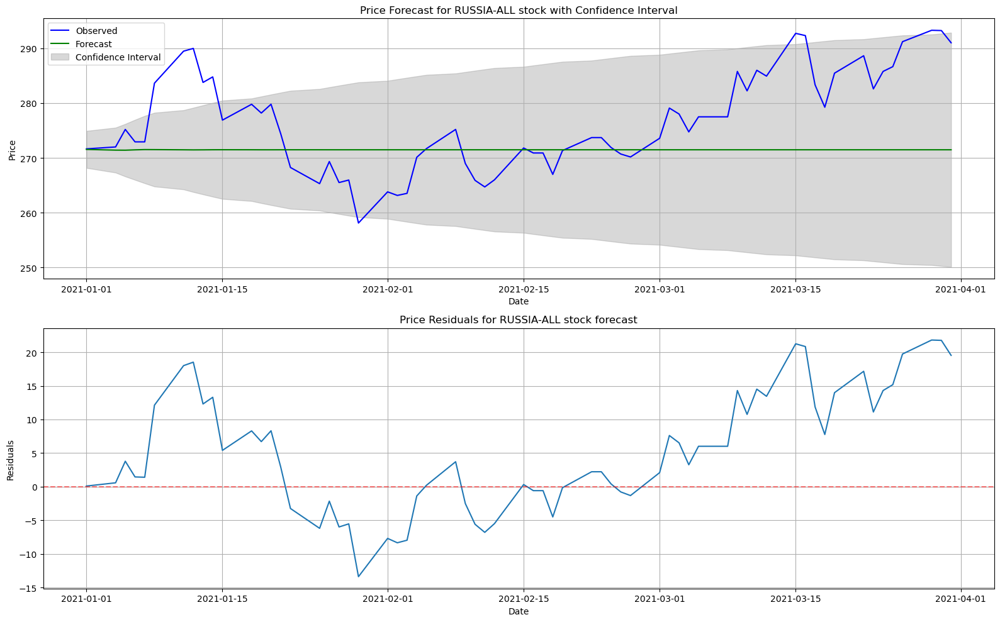


 <<< -------------------------------------------------- >>> 

RUSSIA - OPEN


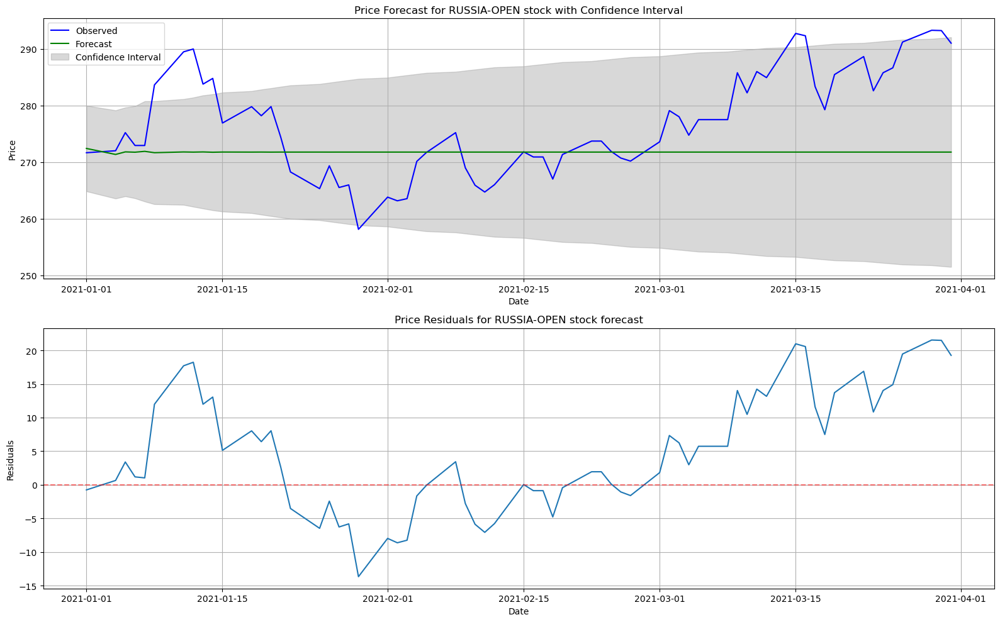


 <<< -------------------------------------------------- >>> 

RUSSIA - HIGH


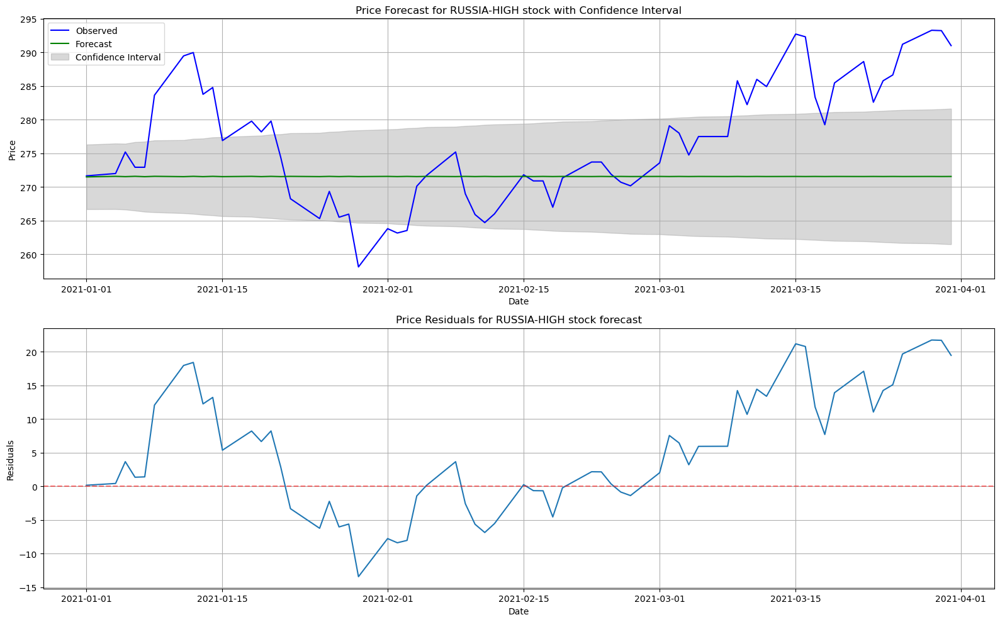


 <<< -------------------------------------------------- >>> 

RUSSIA - LOW


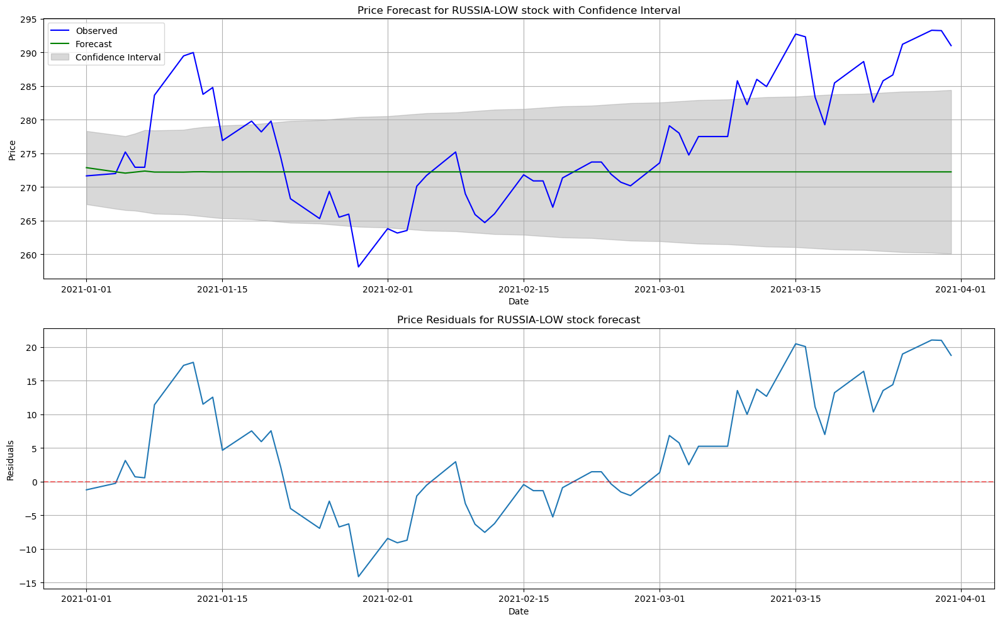


 <<< -------------------------------------------------- >>> 

RUSSIA - VOL.


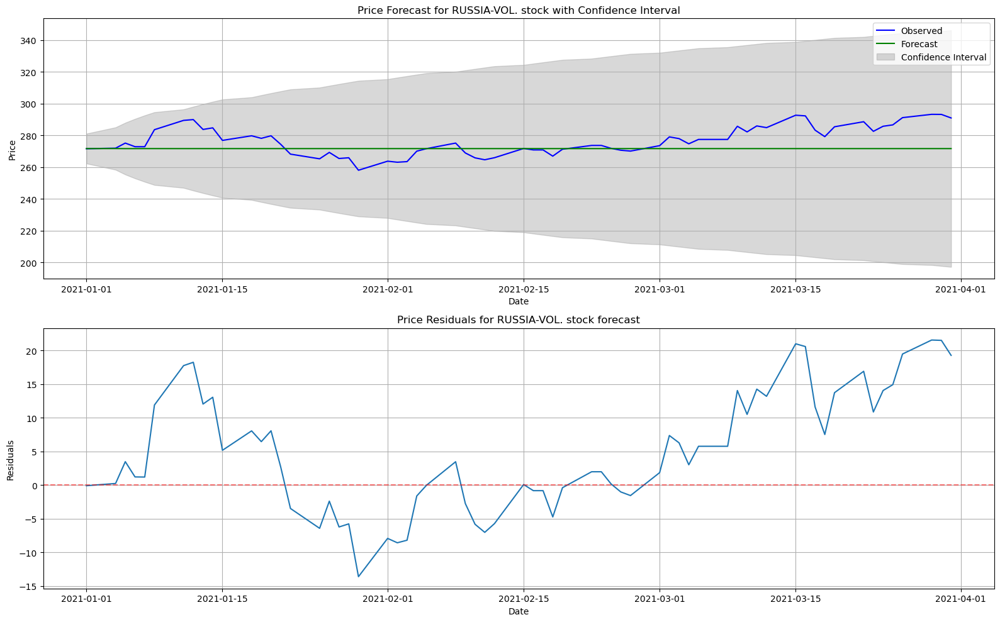


 <<< -------------------------------------------------- >>> 

RUSSIA - CHANGE %


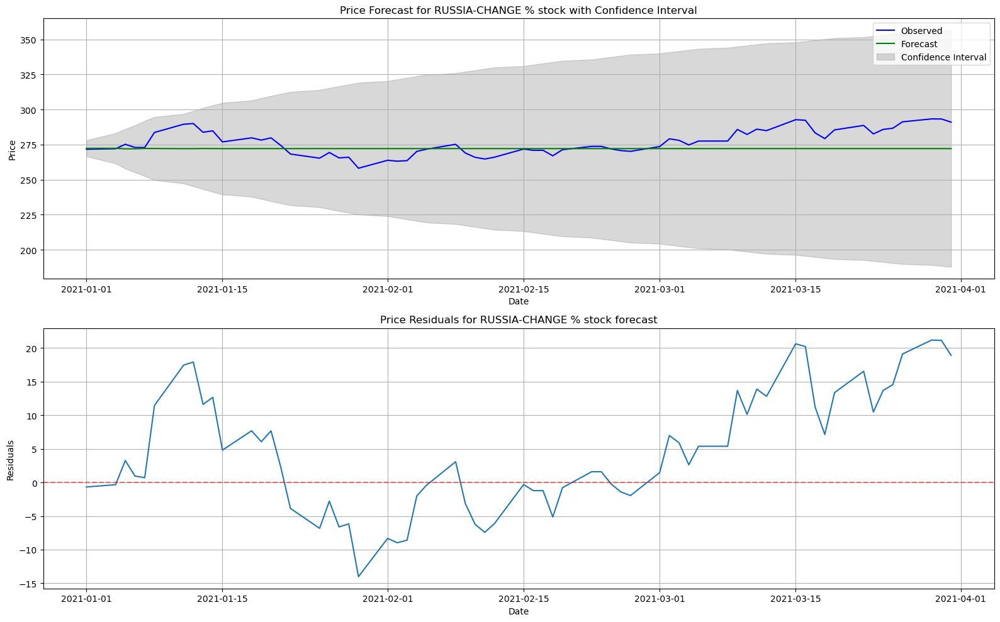


 <<< -------------------------------------------------- >>> 

TURKEY - ALL


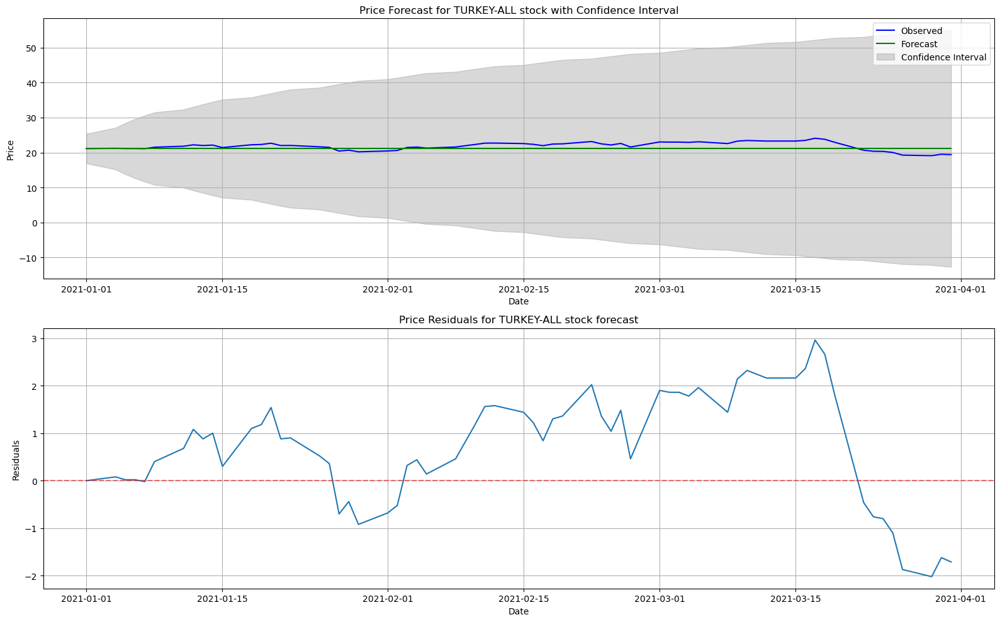


 <<< -------------------------------------------------- >>> 

TURKEY - OPEN


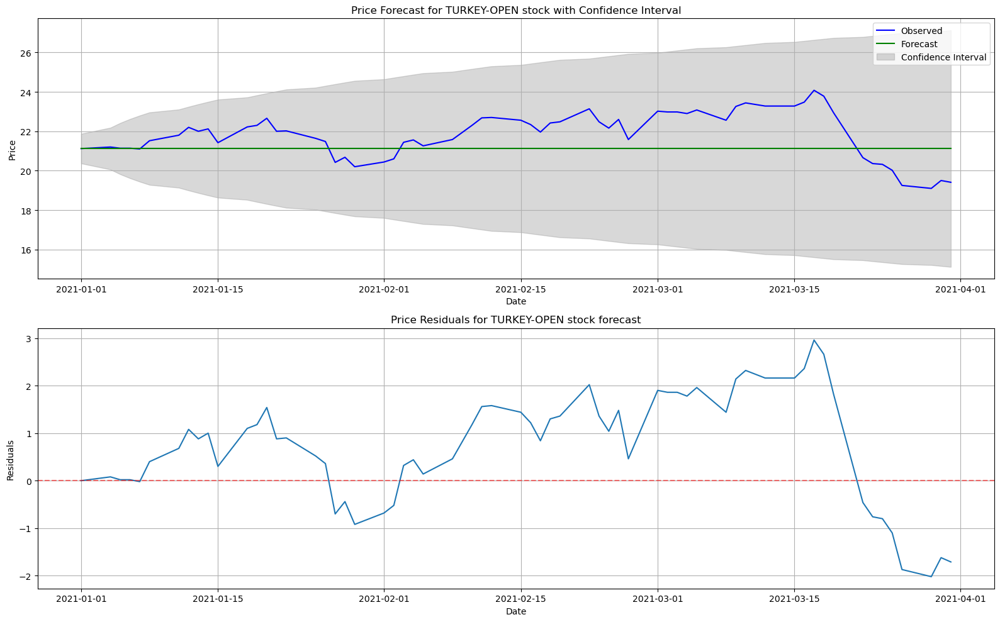


 <<< -------------------------------------------------- >>> 

TURKEY - HIGH


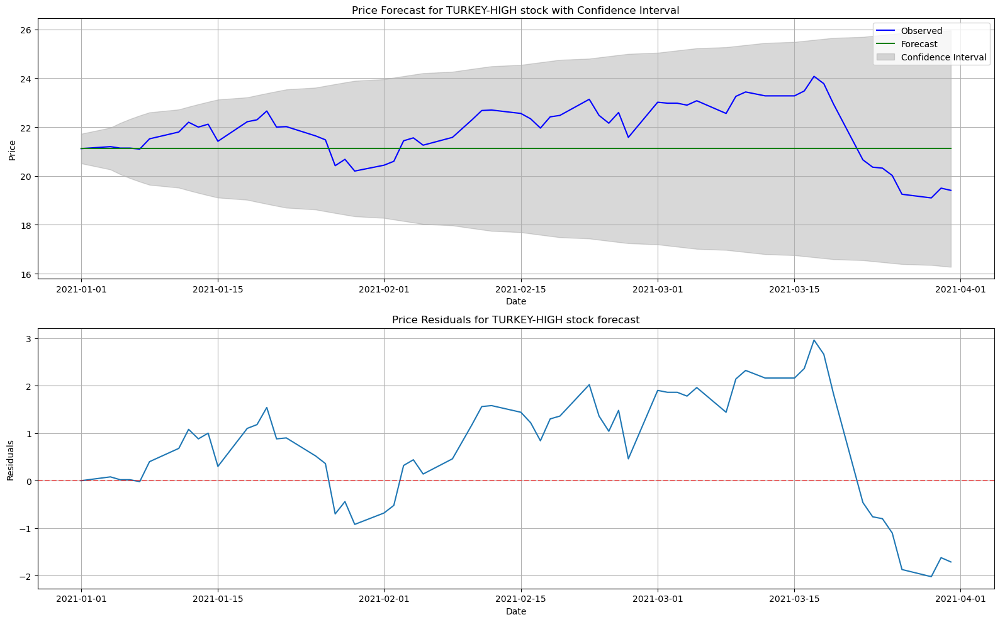


 <<< -------------------------------------------------- >>> 

TURKEY - LOW


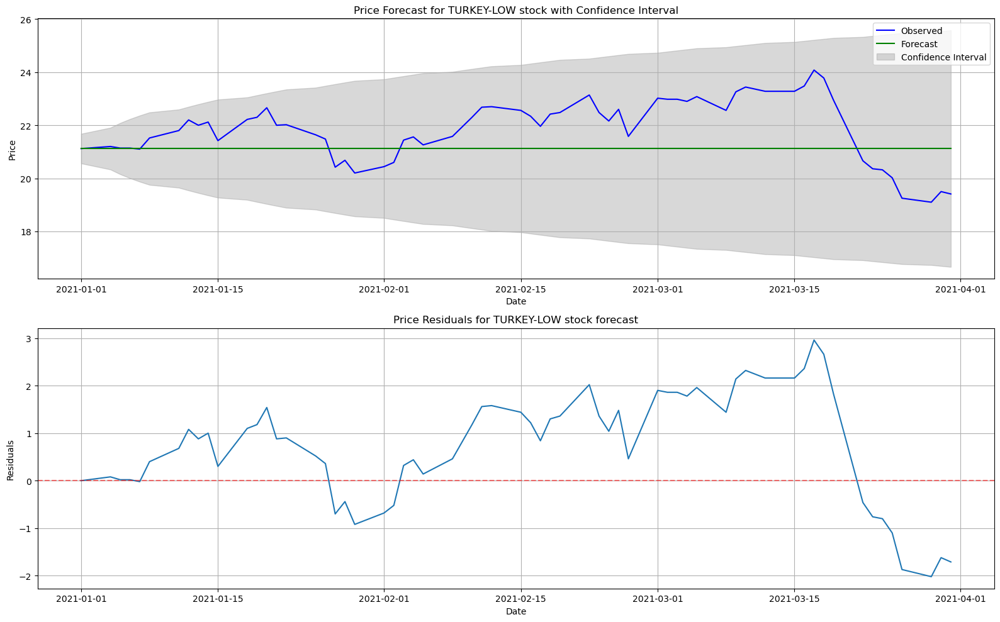


 <<< -------------------------------------------------- >>> 

TURKEY - VOL.


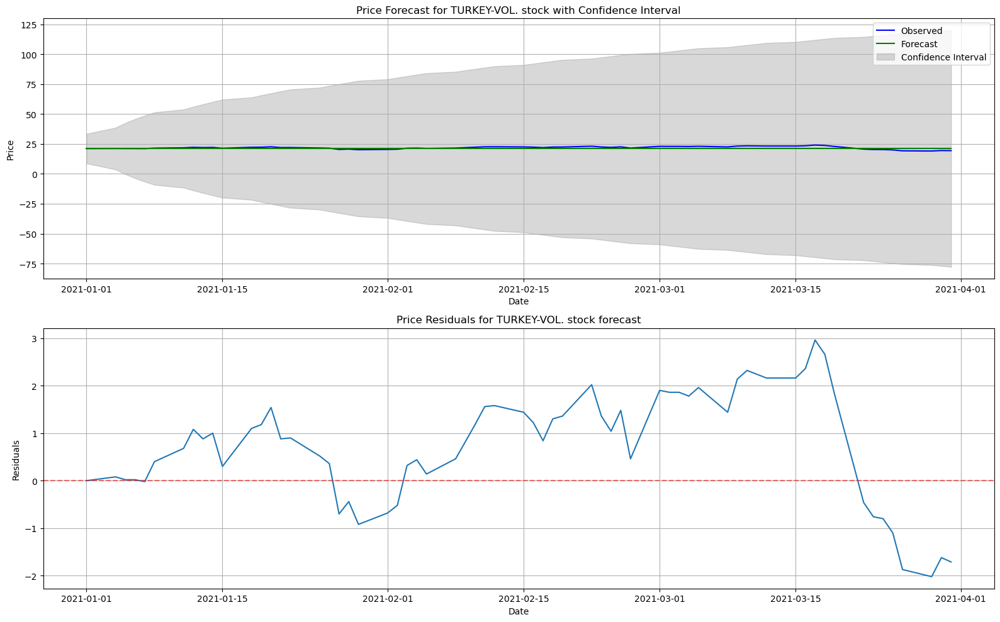


 <<< -------------------------------------------------- >>> 

TURKEY - CHANGE %


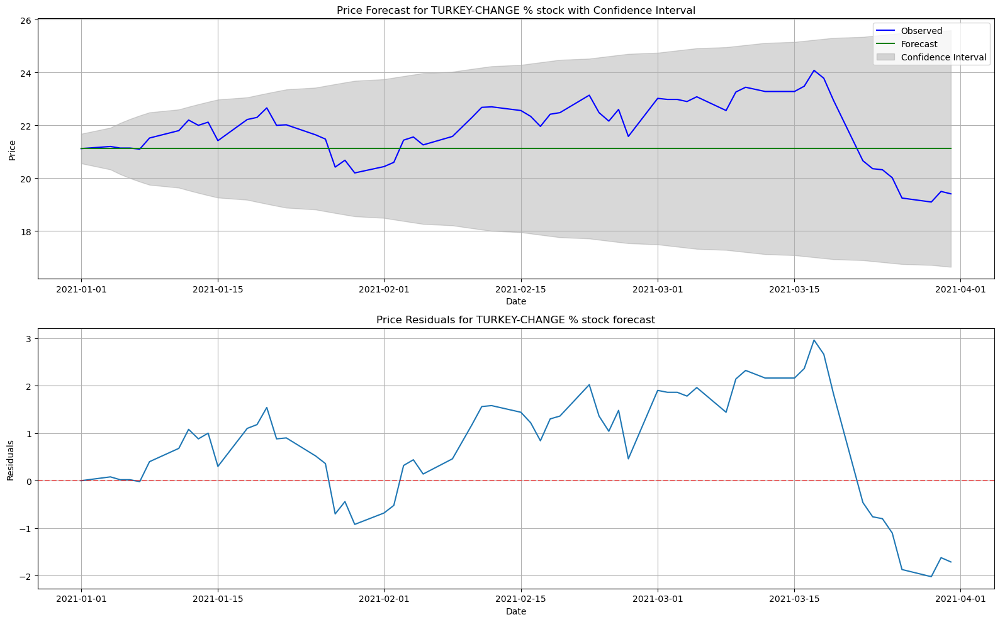


 <<< -------------------------------------------------- >>> 

EGYPT - ALL


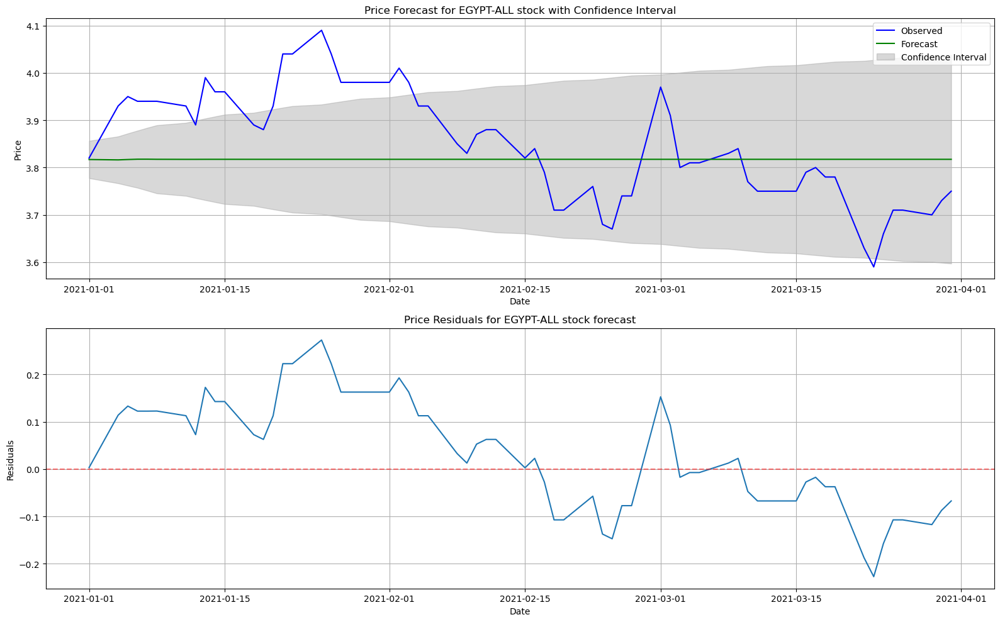


 <<< -------------------------------------------------- >>> 

EGYPT - OPEN


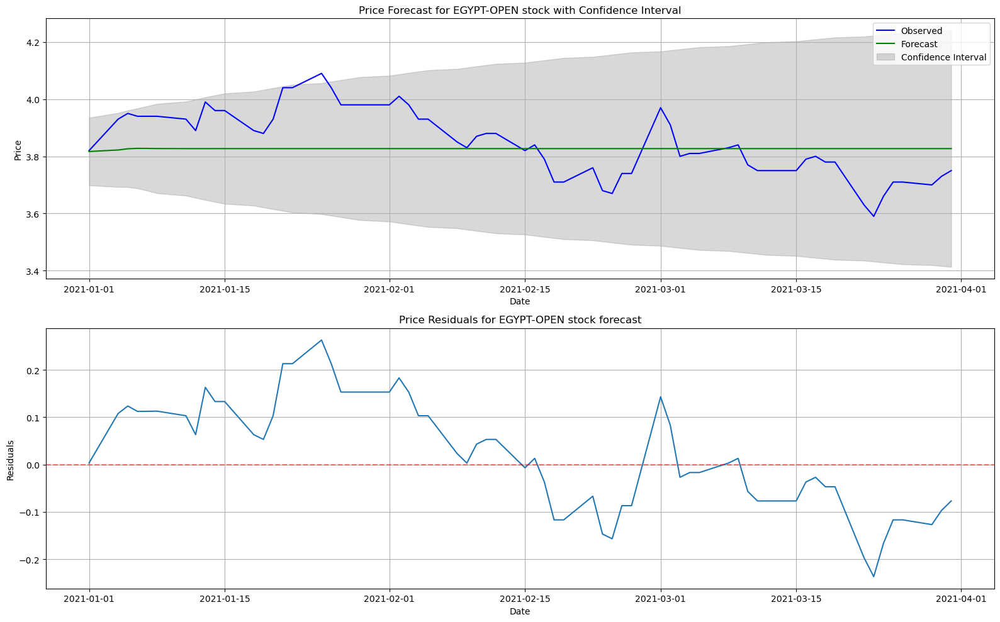


 <<< -------------------------------------------------- >>> 

EGYPT - HIGH


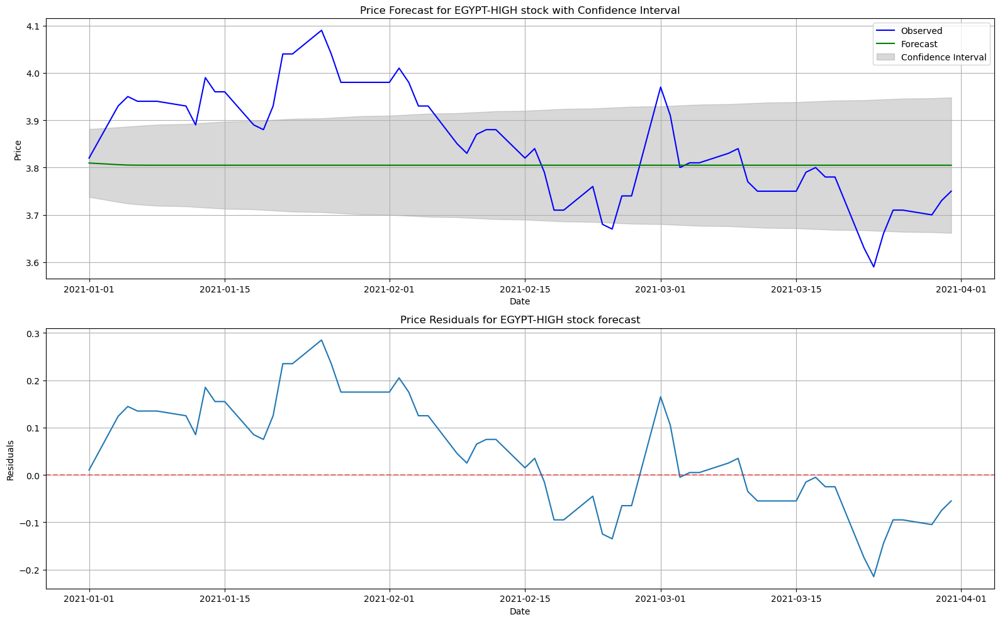


 <<< -------------------------------------------------- >>> 

EGYPT - LOW


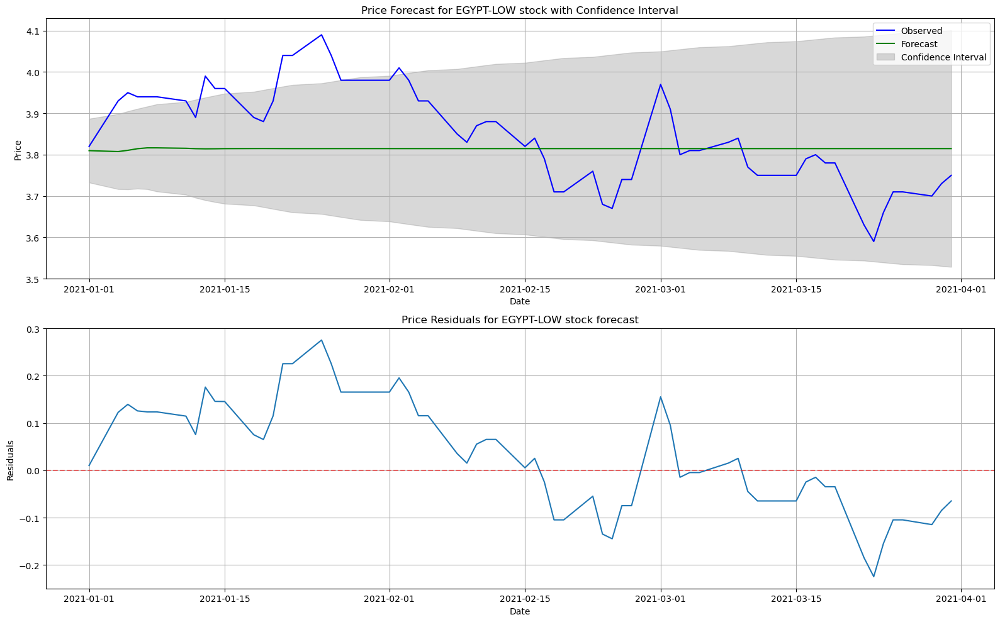


 <<< -------------------------------------------------- >>> 

EGYPT - VOL.


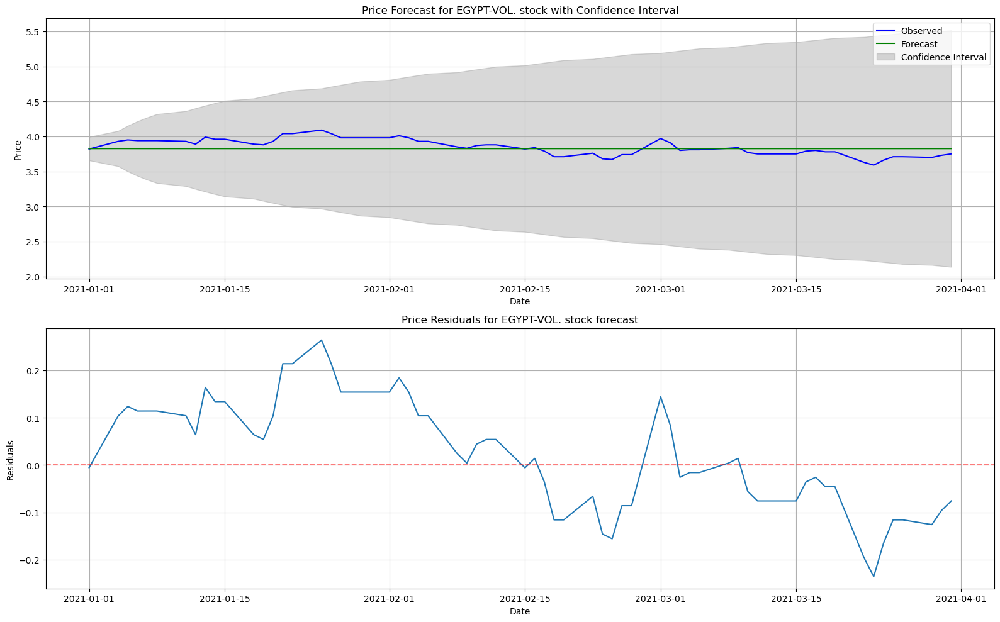


 <<< -------------------------------------------------- >>> 

EGYPT - CHANGE %


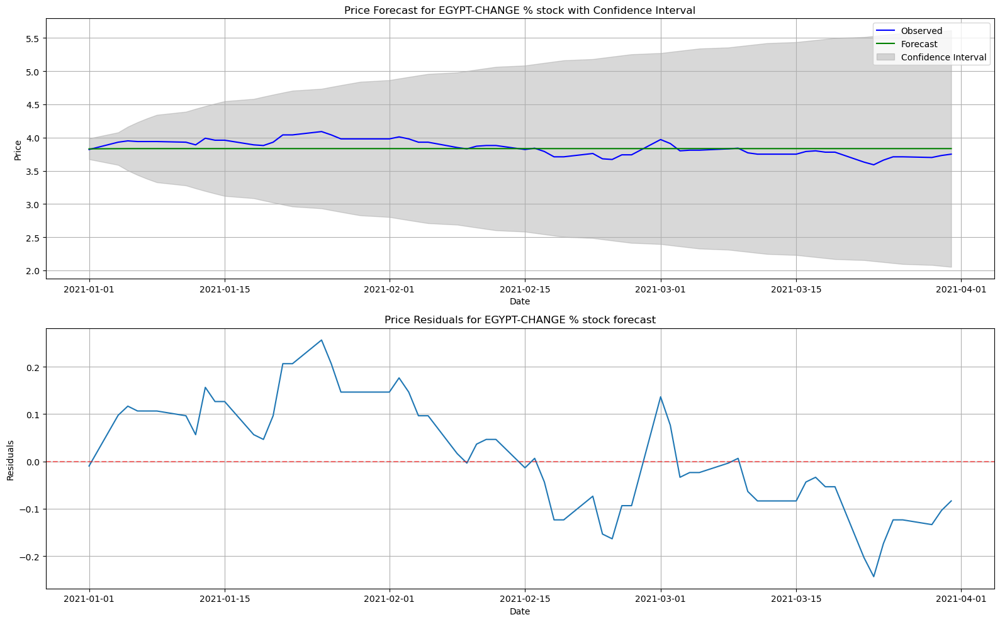


 <<< -------------------------------------------------- >>> 

BRAZIL - ALL


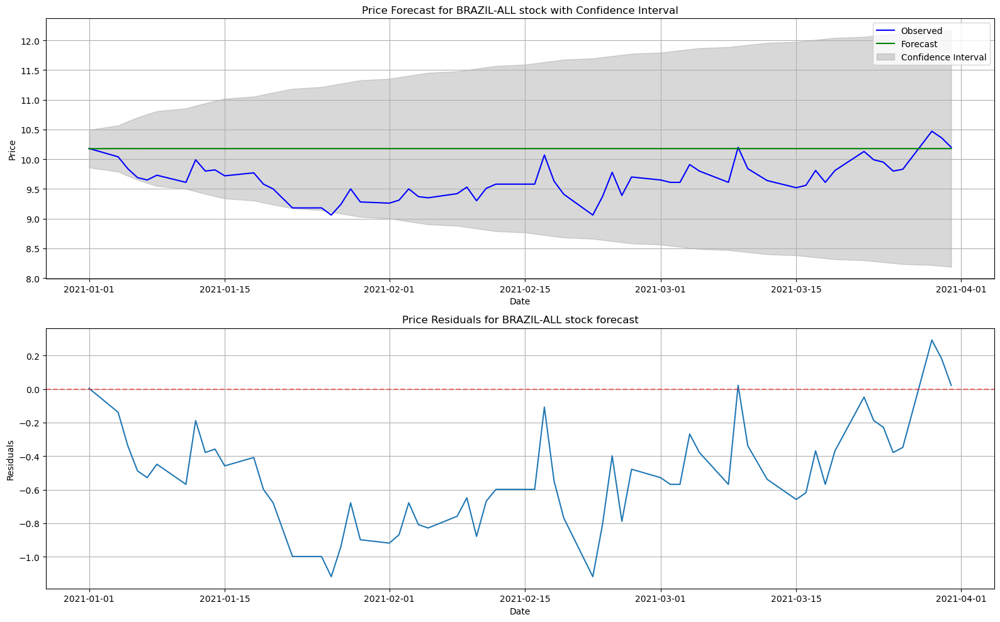


 <<< -------------------------------------------------- >>> 

BRAZIL - OPEN


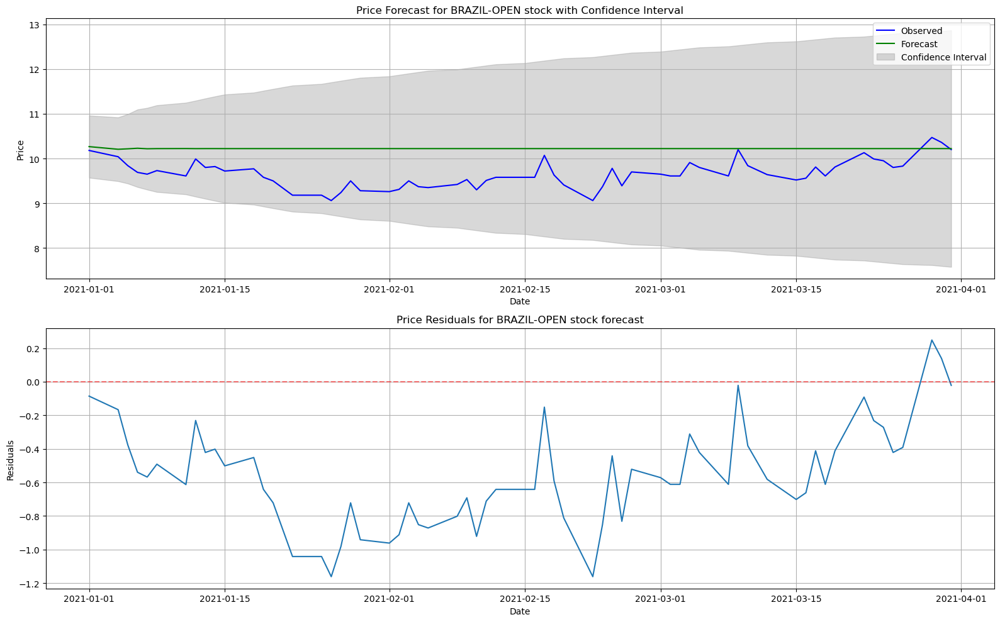


 <<< -------------------------------------------------- >>> 

BRAZIL - HIGH


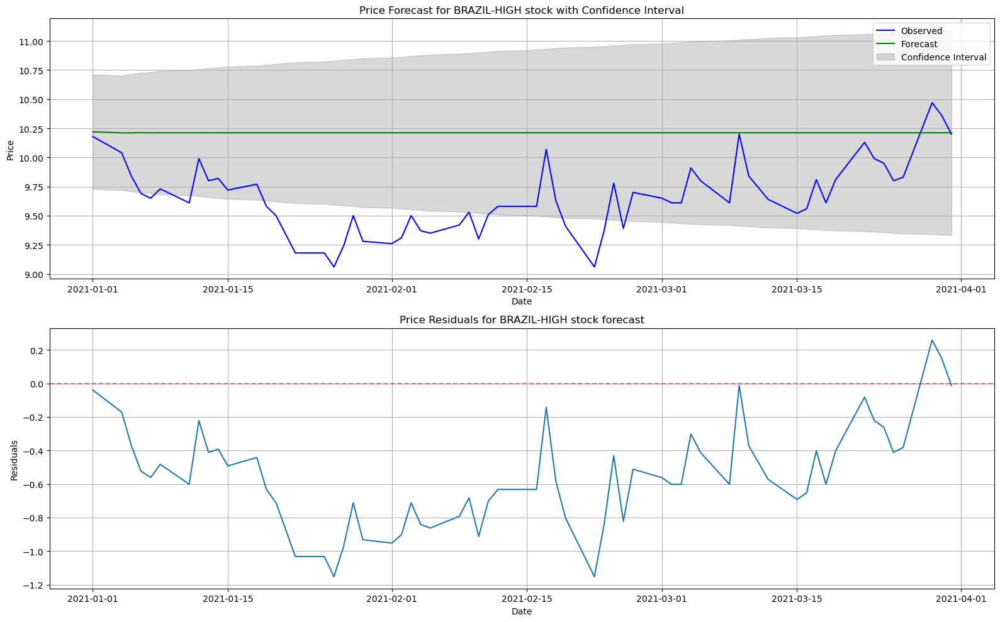


 <<< -------------------------------------------------- >>> 

BRAZIL - LOW


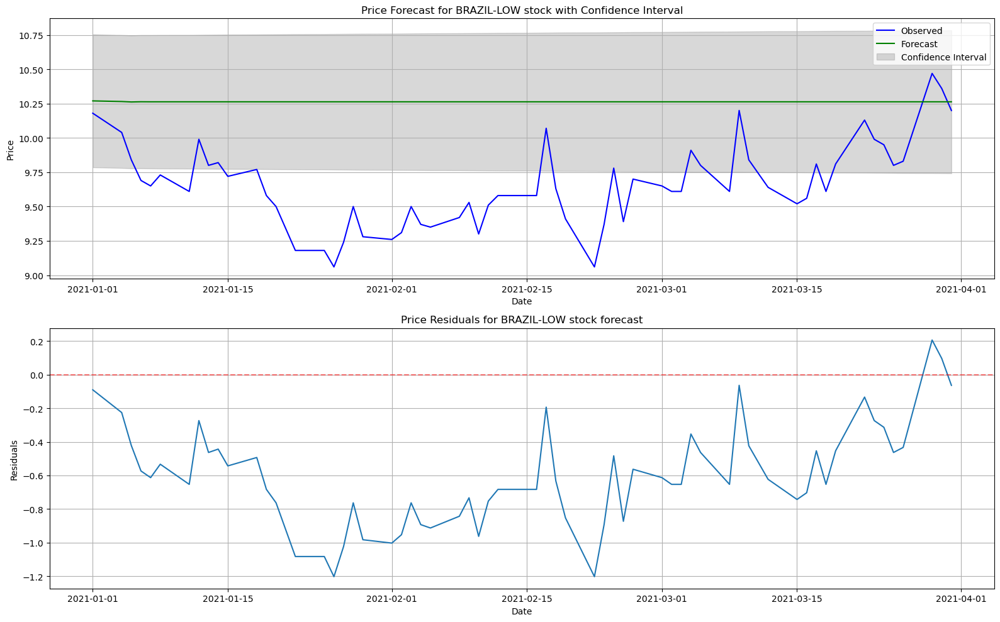


 <<< -------------------------------------------------- >>> 

BRAZIL - VOL.


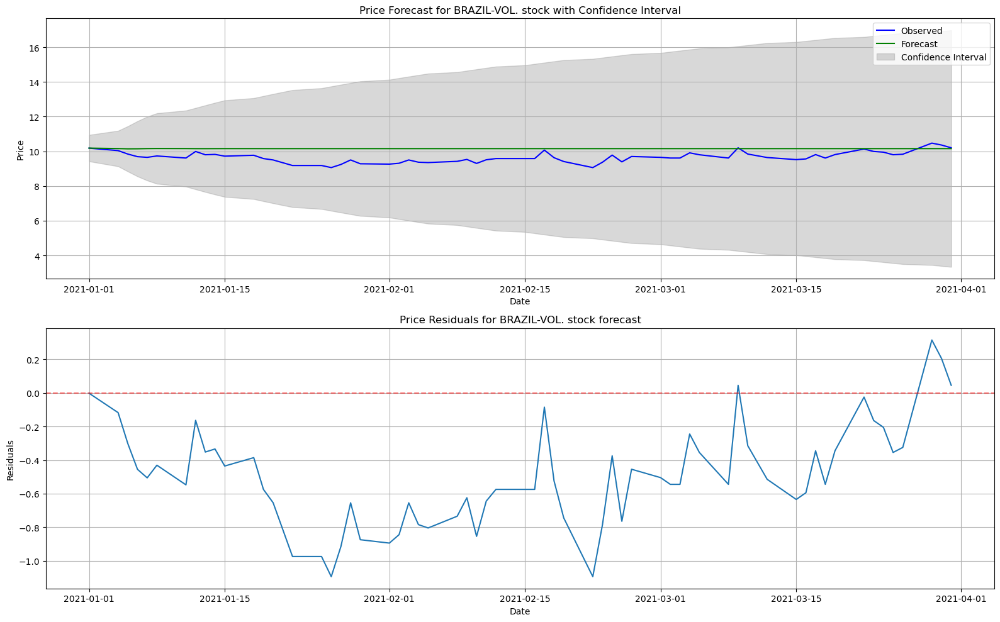


 <<< -------------------------------------------------- >>> 

BRAZIL - CHANGE %


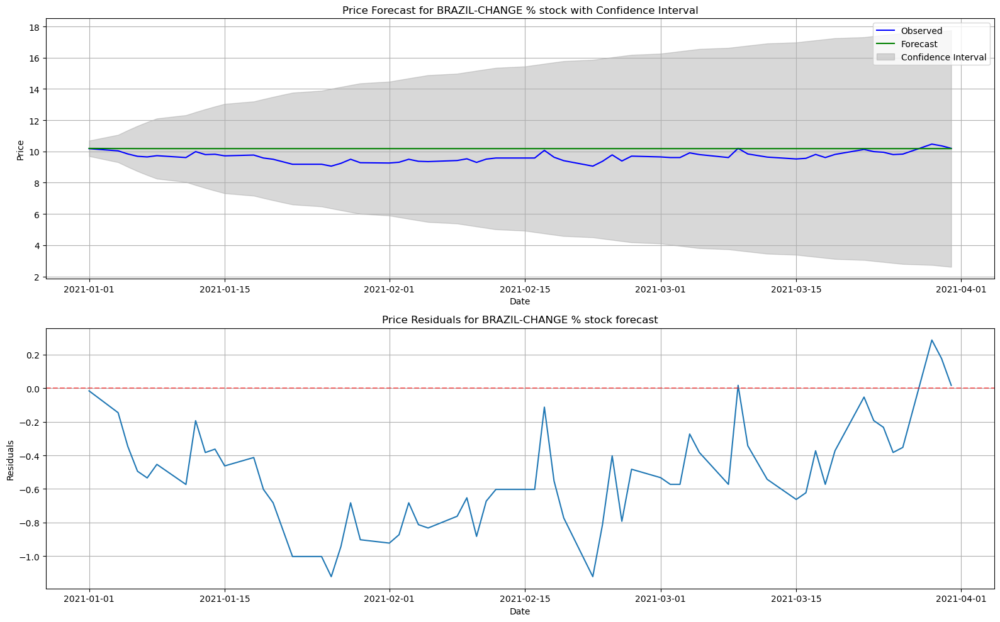


 <<< -------------------------------------------------- >>> 

ARGENTINA - ALL


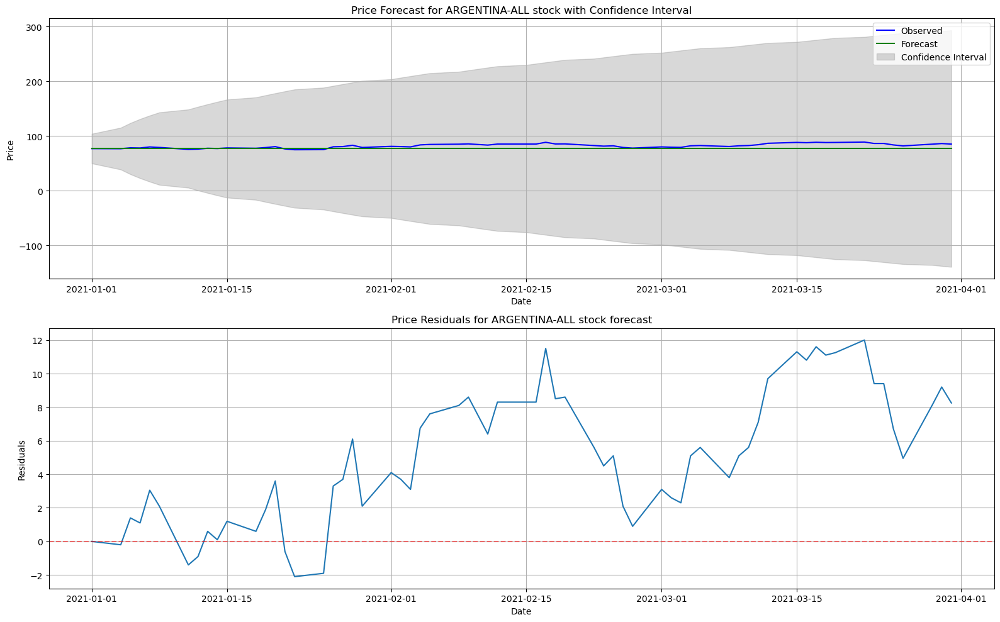


 <<< -------------------------------------------------- >>> 

ARGENTINA - OPEN


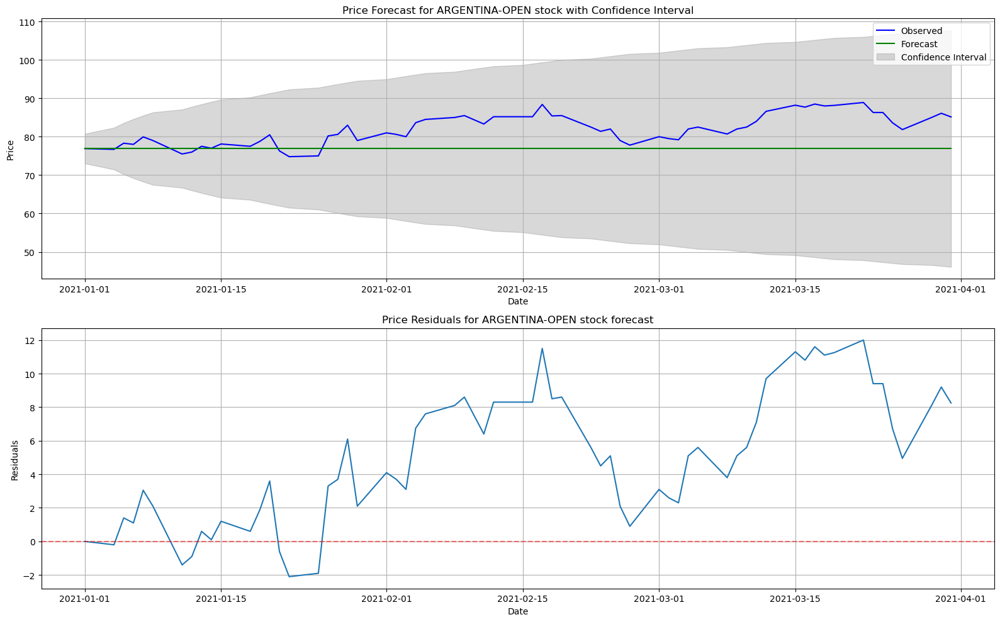


 <<< -------------------------------------------------- >>> 

ARGENTINA - HIGH


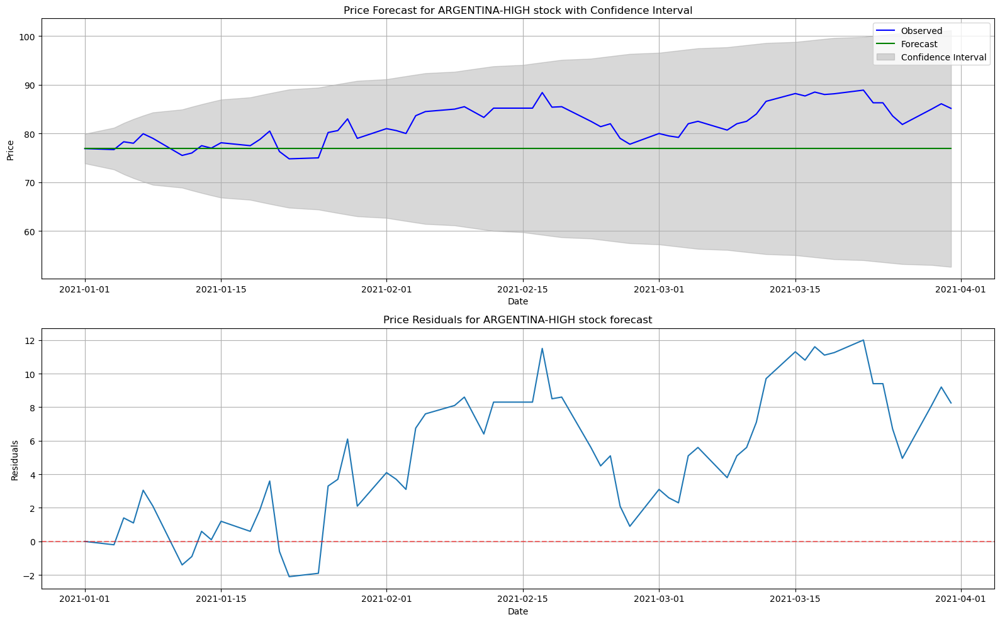


 <<< -------------------------------------------------- >>> 

ARGENTINA - LOW


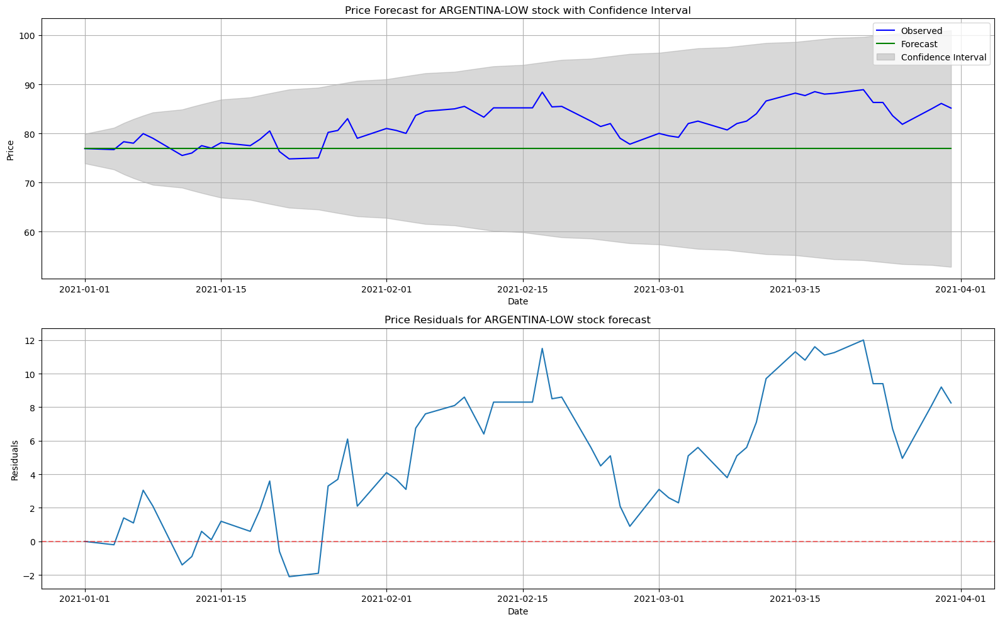


 <<< -------------------------------------------------- >>> 

ARGENTINA - VOL.


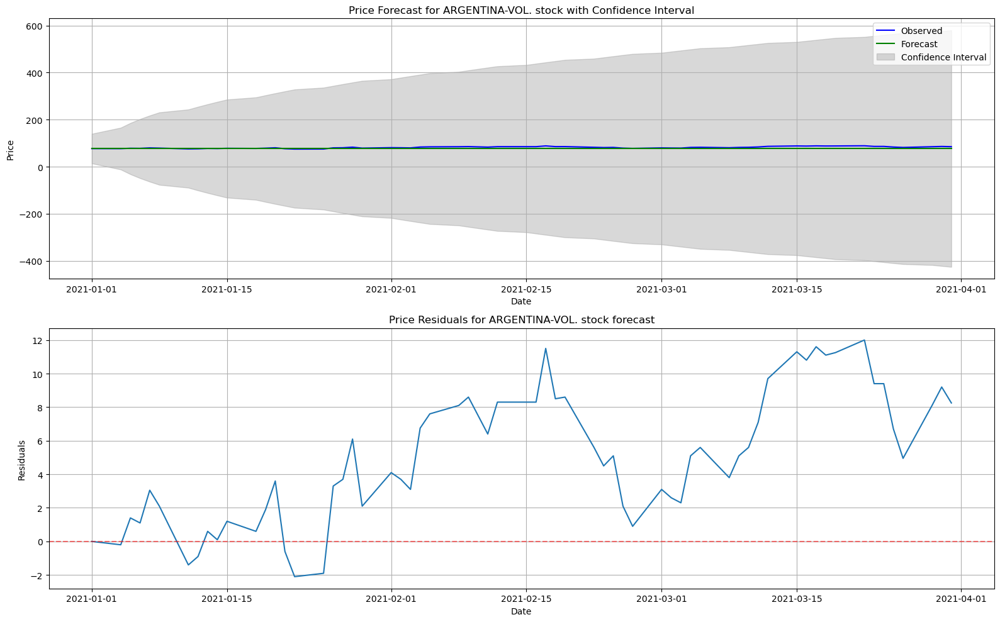


 <<< -------------------------------------------------- >>> 

ARGENTINA - CHANGE %


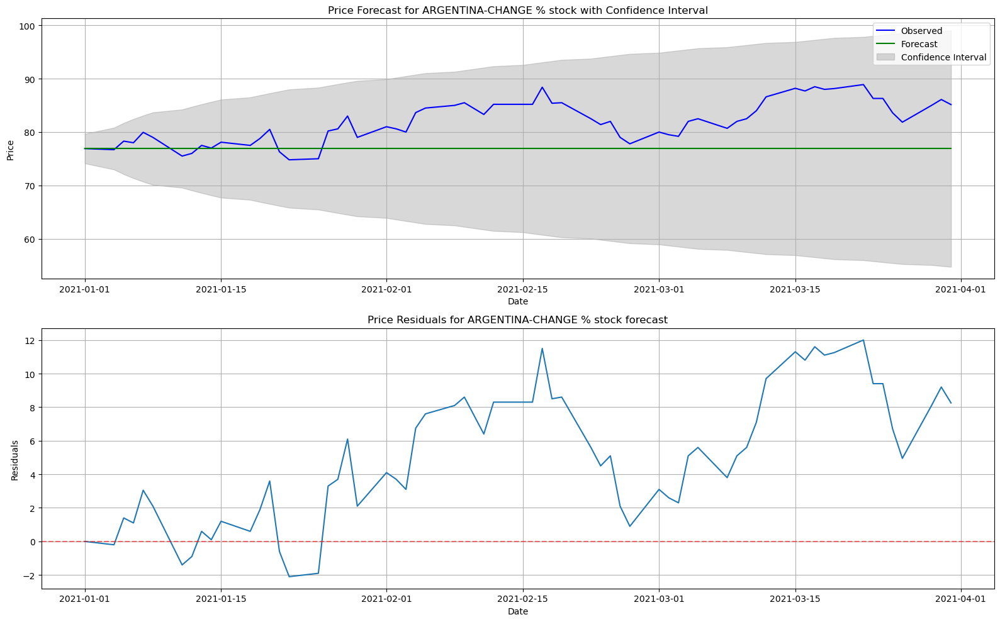


 <<< -------------------------------------------------- >>> 

COLOMBIA - ALL


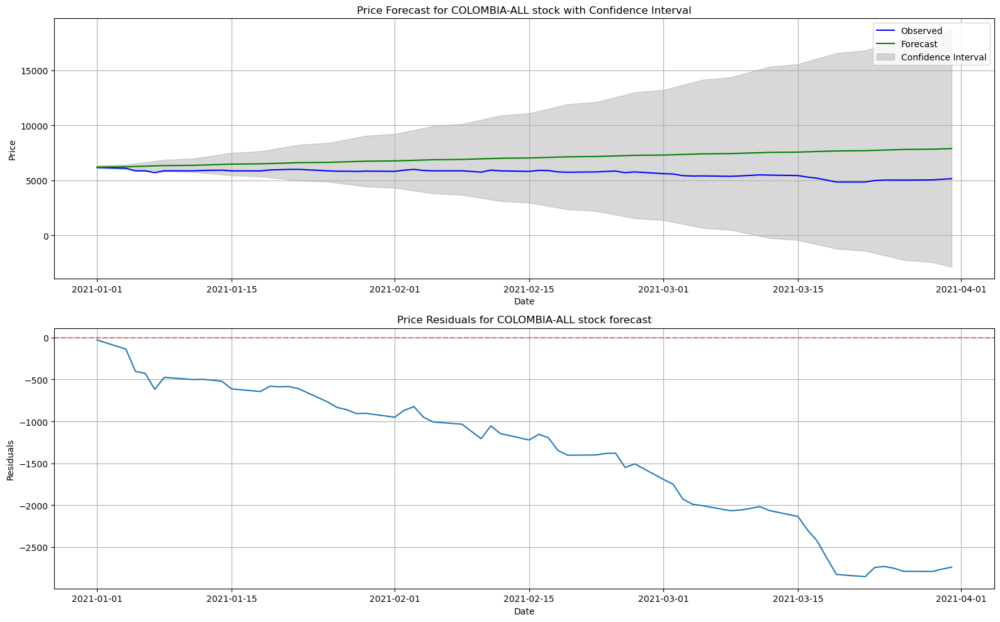


 <<< -------------------------------------------------- >>> 

COLOMBIA - OPEN


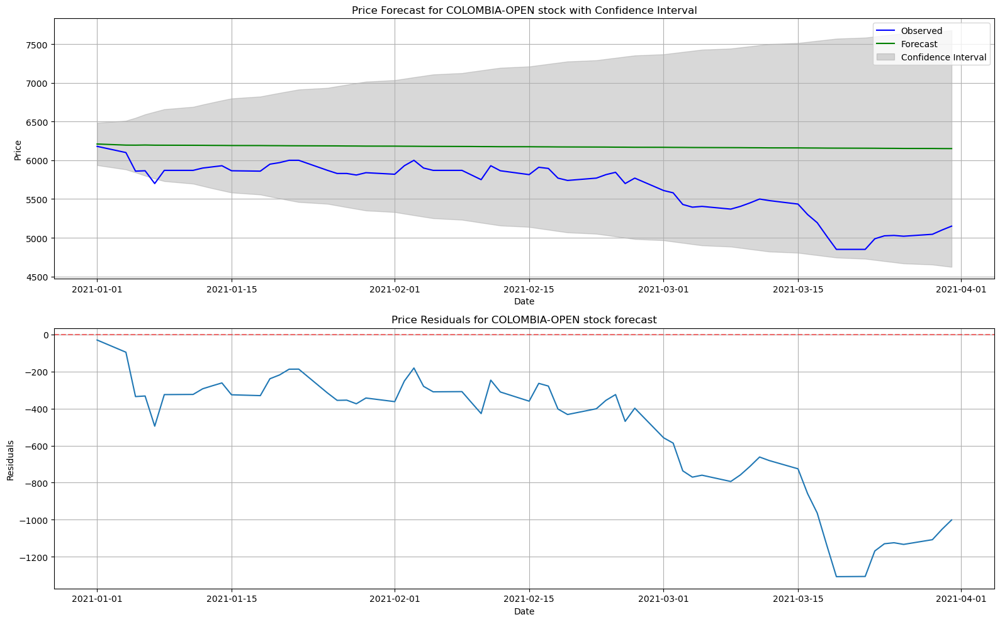


 <<< -------------------------------------------------- >>> 

COLOMBIA - HIGH


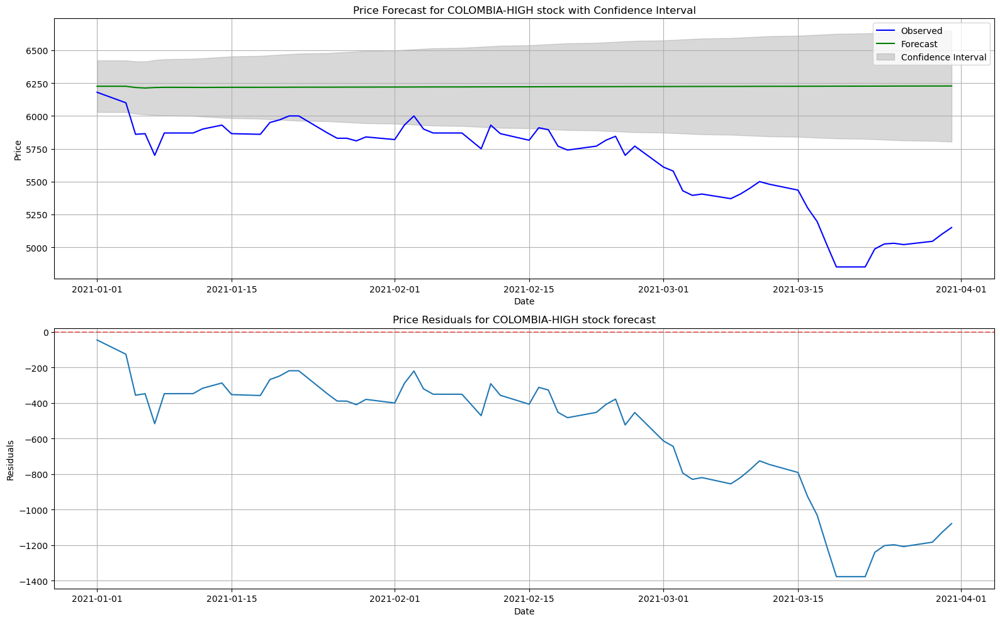


 <<< -------------------------------------------------- >>> 

COLOMBIA - LOW


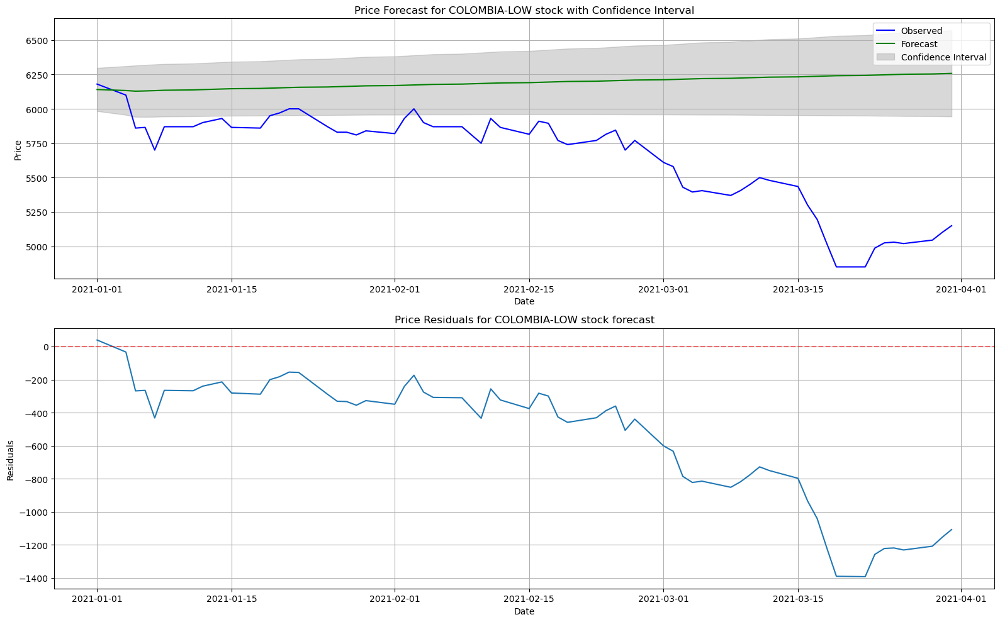


 <<< -------------------------------------------------- >>> 

COLOMBIA - VOL.


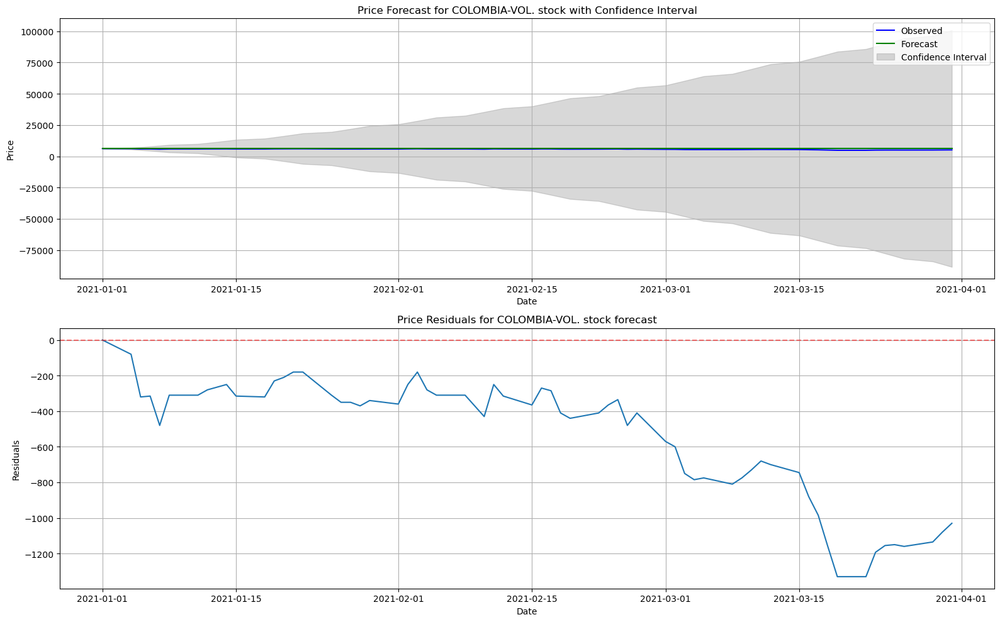


 <<< -------------------------------------------------- >>> 

COLOMBIA - CHANGE %


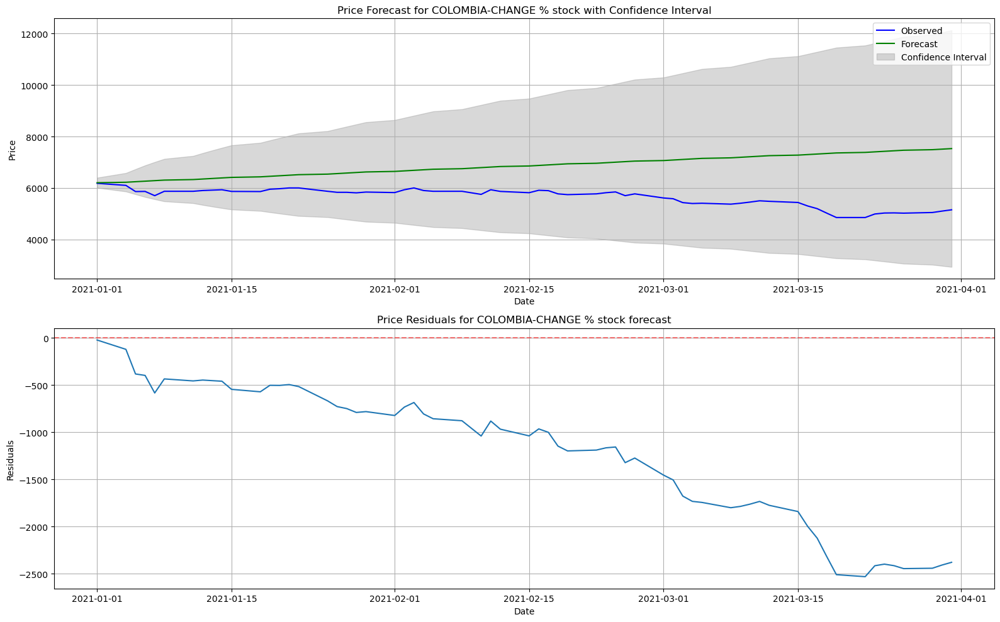


 <<< -------------------------------------------------- >>> 

SA - ALL


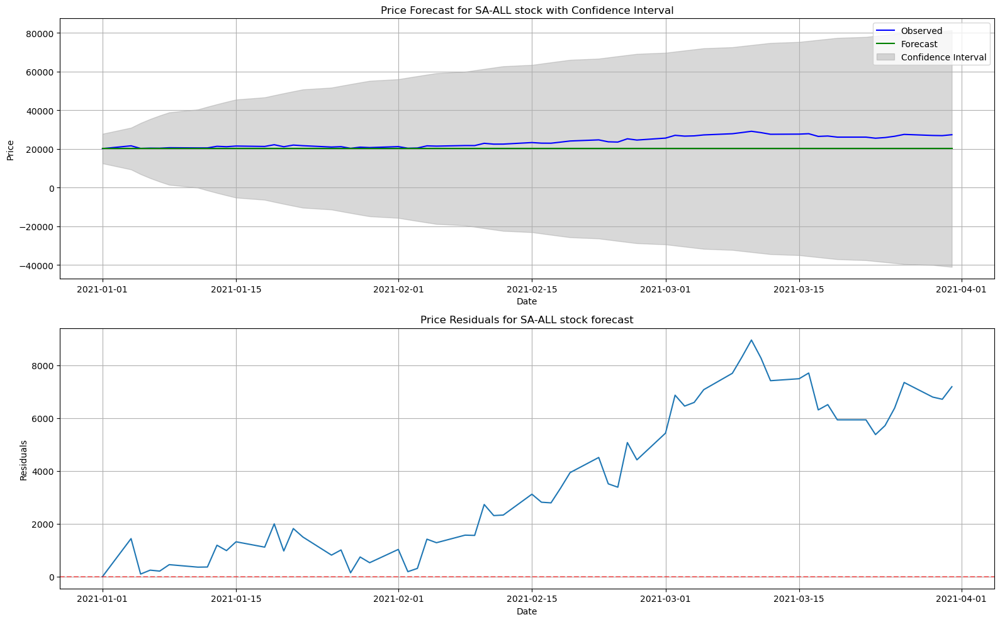


 <<< -------------------------------------------------- >>> 

SA - OPEN


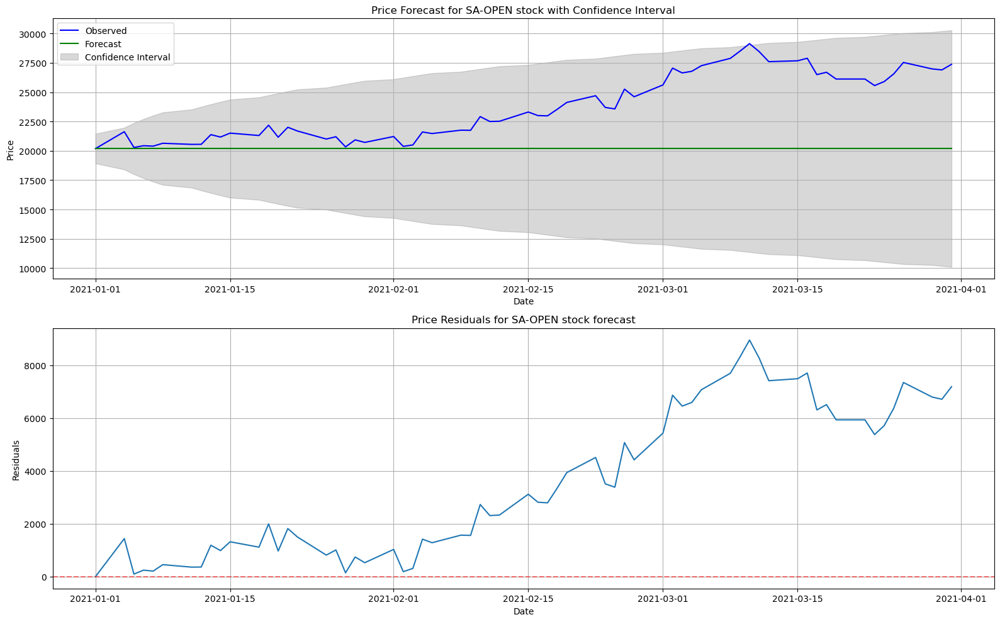


 <<< -------------------------------------------------- >>> 

SA - HIGH


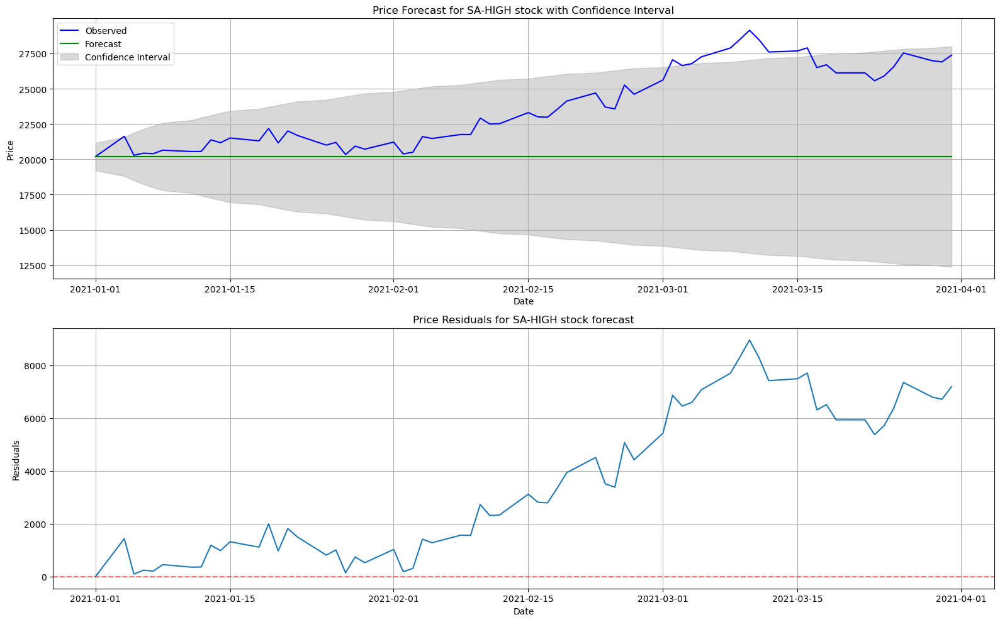


 <<< -------------------------------------------------- >>> 

SA - LOW


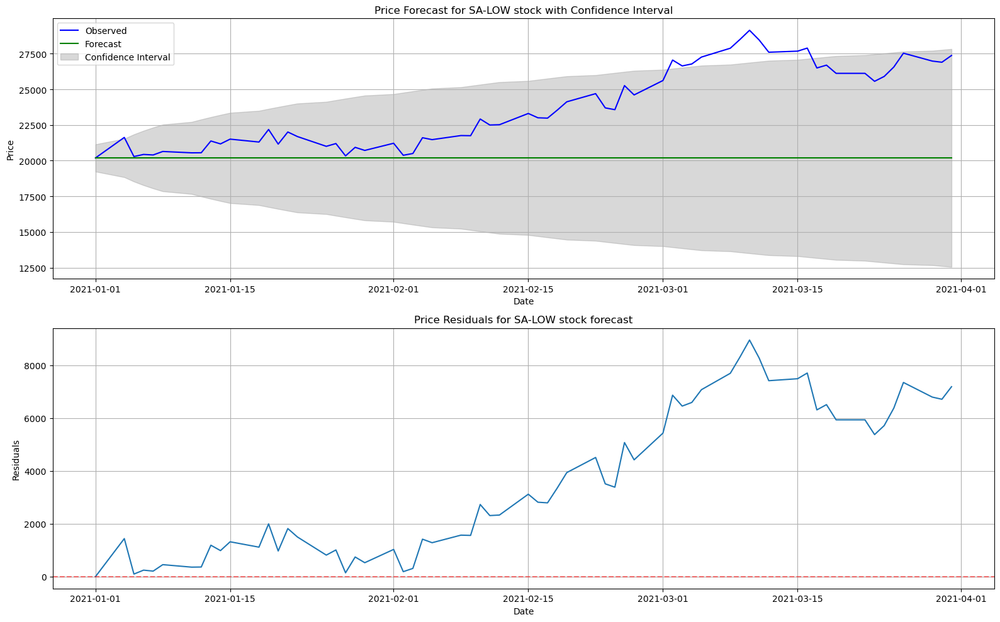


 <<< -------------------------------------------------- >>> 

SA - VOL.


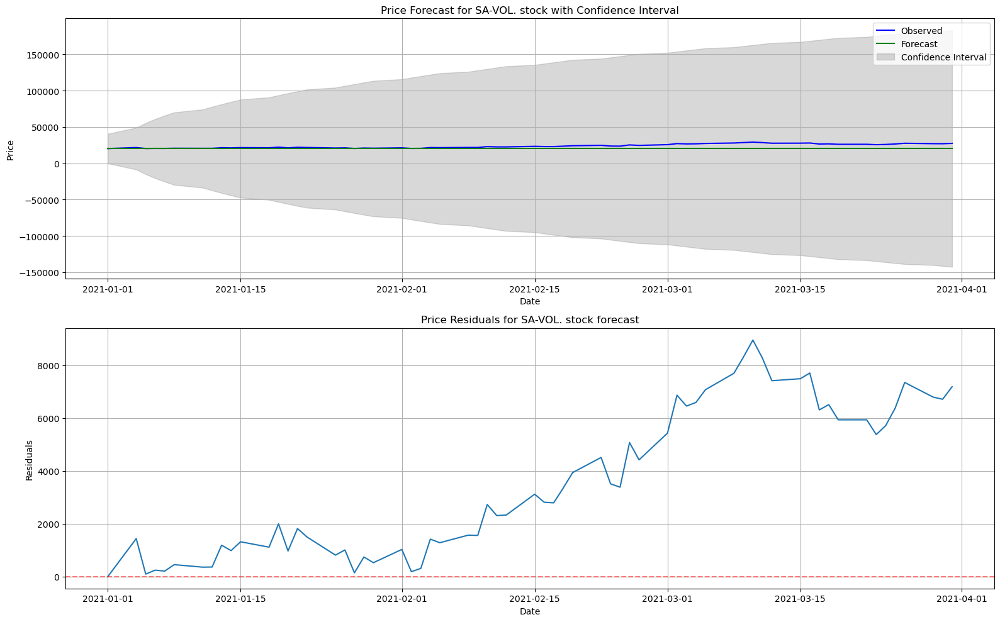


 <<< -------------------------------------------------- >>> 

SA - CHANGE %


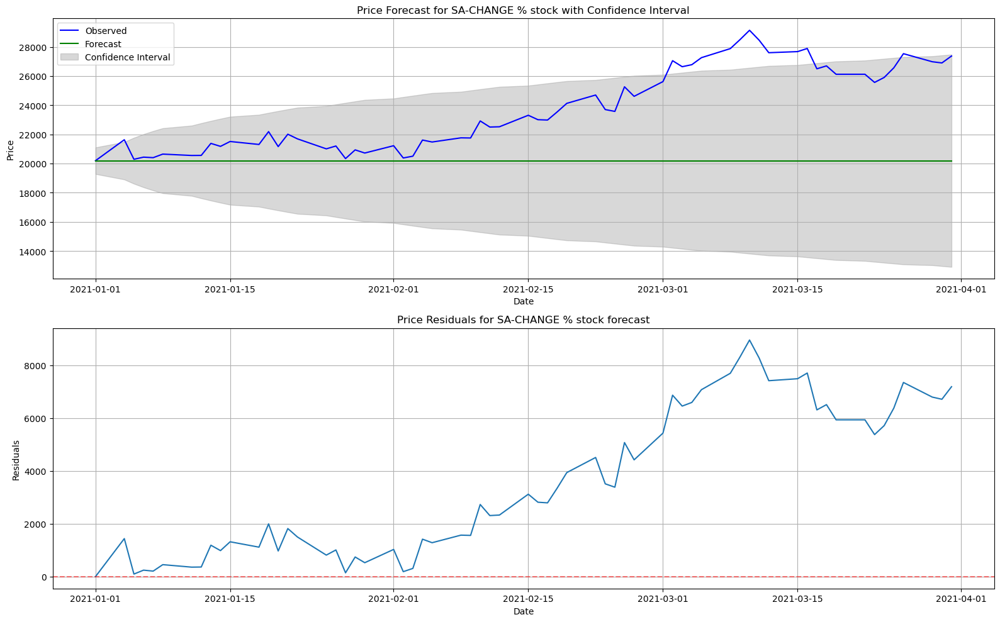


 <<< -------------------------------------------------- >>> 

KOREA - ALL


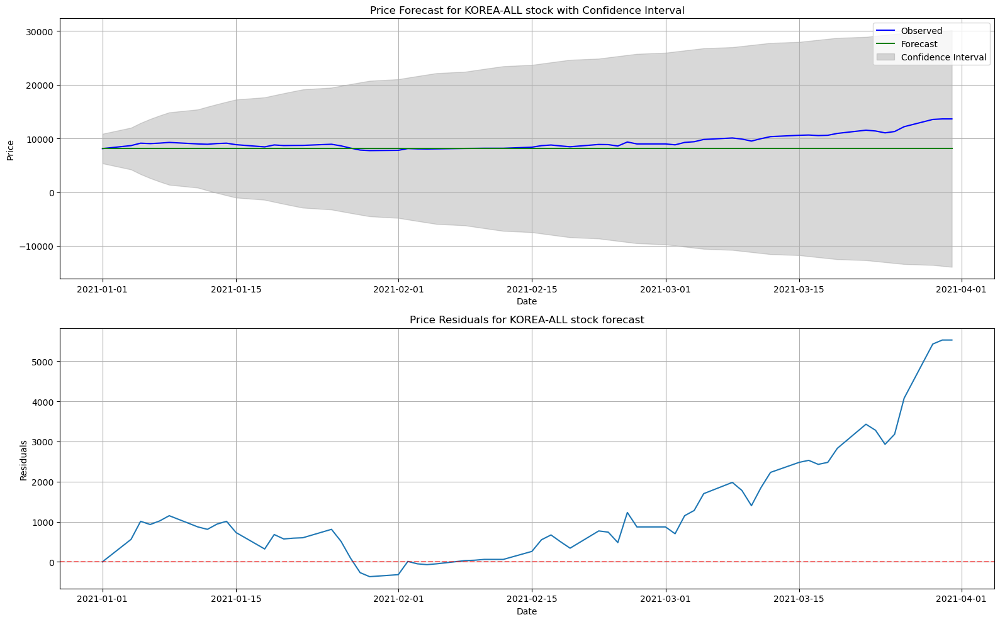


 <<< -------------------------------------------------- >>> 

KOREA - OPEN


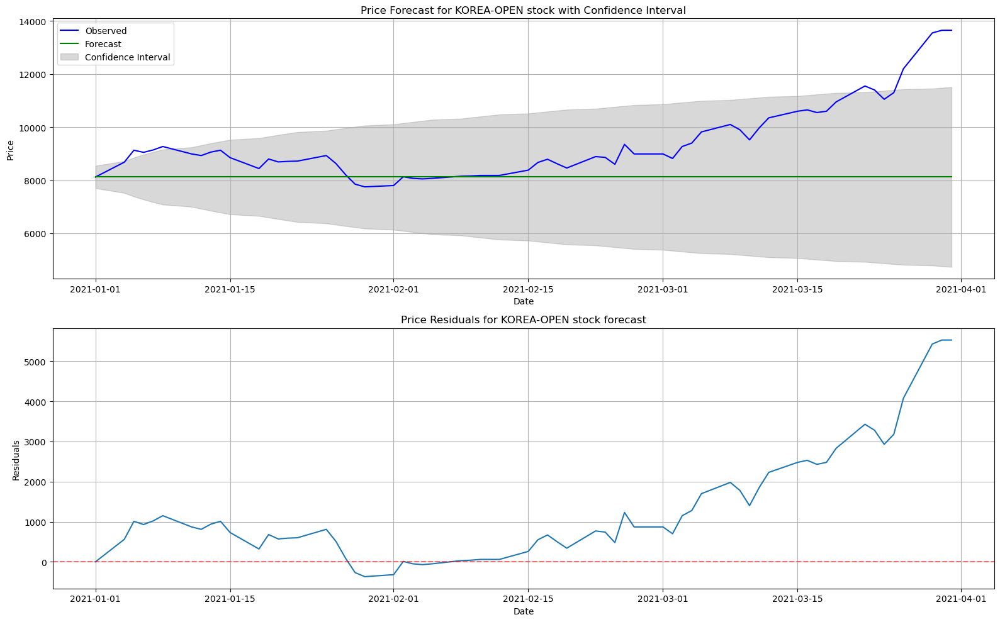


 <<< -------------------------------------------------- >>> 

KOREA - HIGH


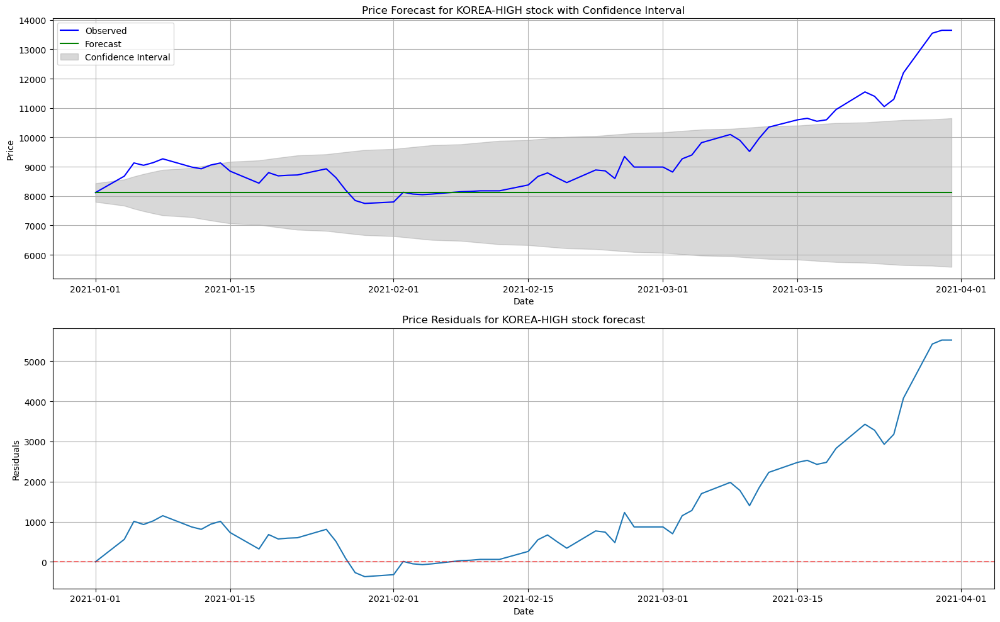


 <<< -------------------------------------------------- >>> 

KOREA - LOW


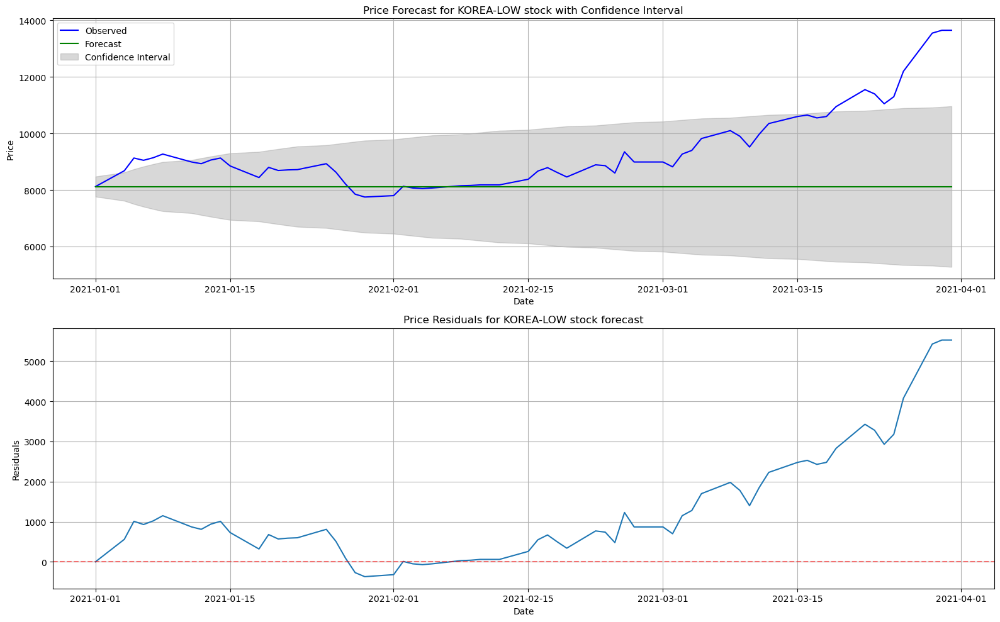


 <<< -------------------------------------------------- >>> 

KOREA - VOL.


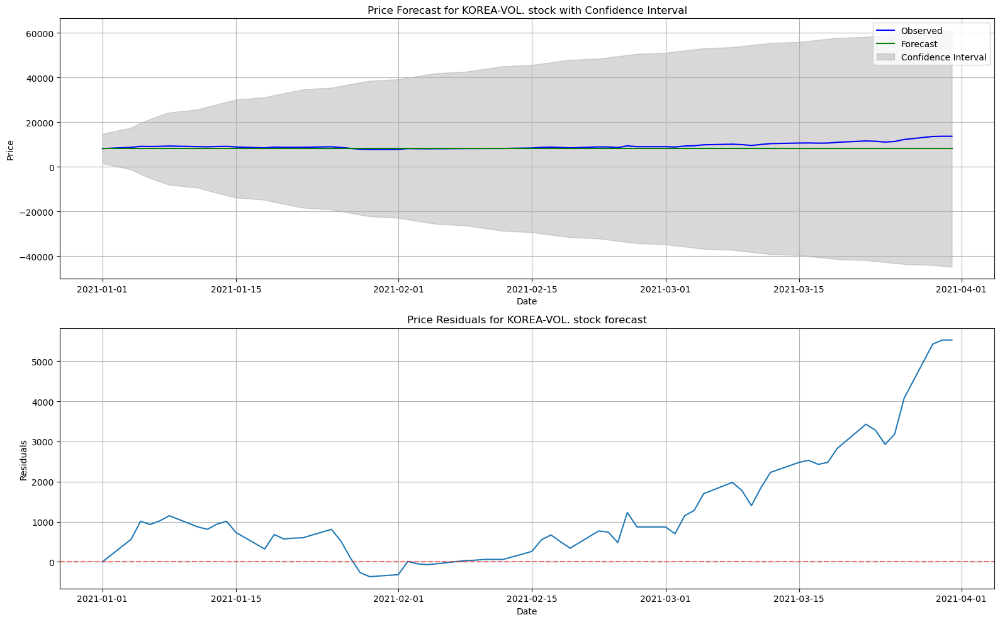


 <<< -------------------------------------------------- >>> 

KOREA - CHANGE %


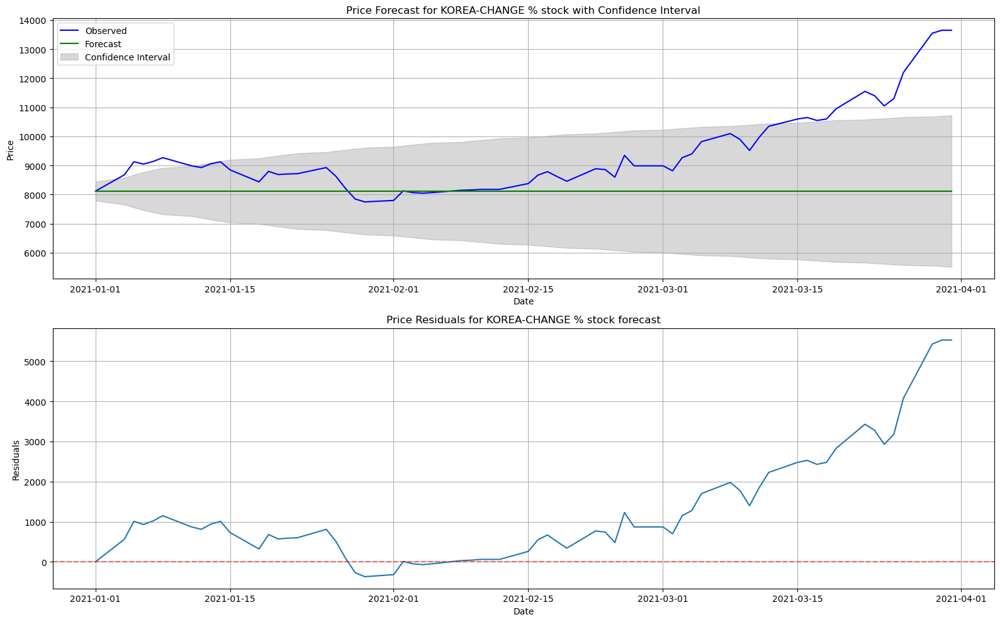


 <<< -------------------------------------------------- >>> 



In [23]:
train_end = datetime(2020,12,31)
plot = True
arimax_models = {}

# For each time series
for key in data.keys():
    # We compute the model and result with a single exogenous variable
    country_arimax_models = {}
    # For all the exogenous variables
    for exo_var in performance.columns:
        train_set = data[key]["Price"][:train_end]
        test_set = data[key]["Price"][train_end+timedelta(days=1):]
        # Create the test data range for later use
        start_test = train_end+timedelta(days=1)
        end_test = data[key]["Price"].index[-1]
        date_range = pd.date_range(start=start_test, end=end_test, freq="B")
        if exo_var == "Price":
            continue
        if exo_var == "All":
            train_exo = data[key][:train_end]
            train_exo = train_exo.drop("Price", axis=1)
            # Build the exo variables based on the last known data
            last_value = train_exo.iloc[-1].values
            exo_data = dict(zip(train_exo.columns, last_value))
            test_exo = pd.DataFrame(exo_data, index=date_range)
        else:
            train_exo = data[key][exo_var][:train_end]
            # Build the test exo_var using the last known value
            last_value = train_exo[-1]
            test_exo = pd.Series(last_value, index=date_range)
        # Get the optimal order computed by auto ARIMA
        order = models_auto_arima[key].order
        # Create the model and fit it
        model = sm.tsa.SARIMAX(train_set, order=order, exog=train_exo)
        sarimax = model.fit()
        # Store the trained model in a dictionary
        country_arimax_models[exo_var] = sarimax
        # Compute the forecast & the residuals
        n_forecast_periods = len(test_set)
        forecast_results = sarimax.get_forecast(steps=n_forecast_periods, exog=test_exo)
        forecast = forecast_results.predicted_mean
        conf_int = forecast_results.conf_int()
        residuals = test_set - forecast
        # Compute and store the performance metrics
        mape = round(np.mean(abs(residuals/test_set)), 4)
        rmse = round(np.sqrt(np.mean(residuals**2)), 4)
        performance.loc[(key, "mape"), exo_var] = mape
        performance.loc[(key, "rmse"), exo_var] = rmse
        # If plot is set to True
        if plot:
            print_bold_underline(f"{key.upper()} - {exo_var.upper()}")
            # Plot the observed data
            fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(16,10))
            axes[0].plot(test_set, label="Observed", color="blue")
            # Plot the forecasts and confidence intervals
            axes[0].plot(forecast, label="Forecast", color="green")
            axes[0].fill_between(forecast.index, conf_int["lower Price"], conf_int["upper Price"], color="gray",
                                 alpha=0.3, label="Confidence Interval")
            # Customize the plot
            axes[0].set_title(f"Price Forecast for {key.upper()}-{exo_var.upper()} stock with Confidence Interval")
            axes[0].set_xlabel("Date")
            axes[0].set_ylabel("Price")
            axes[0].legend()
            axes[0].grid(True)
            axes[1].plot(residuals)
            axes[1].axhline(y=0, color="red", alpha=0.5, linestyle="--")
            # Customize the plot
            axes[1].set_title(f"Price Residuals for {key.upper()}-{exo_var.upper()} stock forecast")
            axes[1].set_xlabel("Date")
            axes[1].set_ylabel("Residuals")
            axes[1].grid(True)
            # Show the plot
            plt.tight_layout()
            plt.show()
            barrier()
    # Place in dictionary
    arimax_models[key] = country_arimax_models

In [24]:
performance

Price        All       Open       High        Low  \
Country   Error                                                          
russia    mape      0.0280     0.0285     0.0282     0.0284     0.0278   
          rmse     10.0860    10.3025    10.1651    10.2637      9.942   
turkey    mape      0.0530      0.053      0.053      0.053      0.053   
          rmse      1.3809     1.3809     1.3809     1.3809     1.3809   
egypt     mape      0.0260     0.0259     0.0256     0.0263      0.026   
          rmse      0.1207     0.1192      0.117      0.123       0.12   
brazil    mape      0.0538     0.0565     0.0607     0.0597     0.0647   
          rmse      0.5753     0.6022     0.6399     0.6316      0.677   
argentina mape      0.0629     0.0629     0.0629     0.0629     0.0629   
          rmse      6.3660      6.366      6.366      6.366      6.366   
colombia  mape      0.2236      0.258     0.0975     0.1061     0.1013   
          rmse   1405.9817  1617.6368    621.141   669.4279   660.5879   
sa        mape      0.1382     0.1382     0.1382     0.1382     0.1382   
          rmse   4506.5862  4506.5862  4506.5862  4506.5862  4506.5862   
korea     mape      0.1216     0.1216     0.1216     0.1216     0.1216   
          rmse   1861.4729  1861.4729  1861.4729  1861.4729  1861.4729   

                      Vol.   Change %  
Country   Error                        
russia    mape      0.0281     0.0278  
          rmse     10.1807     9.9961  
turkey    mape       0.053      0.053  
          rmse      1.3809     1.3809  
egypt     mape      0.0256     0.0256  
          rmse      0.1172      0.116  
brazil    mape      0.0544      0.057  
          rmse      0.5816     0.6063  
argentina mape      0.0629     0.0629  
          rmse       6.366      6.366  
colombia  mape      0.0986     0.2241  
          rmse    632.0691  1407.0053  
sa        mape      0.1382     0.1382  
          rmse   4506.5862  4506.5862  
korea     mape      0.1216     0.1216  
          rmse   1861.4729  1861.4729

In [25]:
with open("../data/performance_arimax_last.pkl", "wb") as handle:
    pickle.dump(performance, handle)

In [26]:
arimax_models

{'russia': {'All': <statsmodels.tsa.statespace.sarimax.SARIMAXResultsWrapper at 0x208b5acc7d0>,
  'Open': <statsmodels.tsa.statespace.sarimax.SARIMAXResultsWrapper at 0x208b60cac50>,
  'High': <statsmodels.tsa.statespace.sarimax.SARIMAXResultsWrapper at 0x208b5d3ac50>,
  'Low': <statsmodels.tsa.statespace.sarimax.SARIMAXResultsWrapper at 0x208b60caf90>,
  'Vol.': <statsmodels.tsa.statespace.sarimax.SARIMAXResultsWrapper at 0x208b5a30150>,
  'Change %': <statsmodels.tsa.statespace.sarimax.SARIMAXResultsWrapper at 0x208b5cd2c50>},
 'turkey': {'All': <statsmodels.tsa.statespace.sarimax.SARIMAXResultsWrapper at 0x208b51b0150>,
  'Open': <statsmodels.tsa.statespace.sarimax.SARIMAXResultsWrapper at 0x208b5265150>,
  'High': <statsmodels.tsa.statespace.sarimax.SARIMAXResultsWrapper at 0x208b5a69510>,
  'Low': <statsmodels.tsa.statespace.sarimax.SARIMAXResultsWrapper at 0x208b5765150>,
  'Vol.': <statsmodels.tsa.statespace.sarimax.SARIMAXResultsWrapper at 0x208b83cac50>,
  'Change %': <statsmo

In [27]:
with open("../data/models_arimax_last.pkl", "wb") as handle:
    pickle.dump(arimax_models, handle)

#### Performance analysis

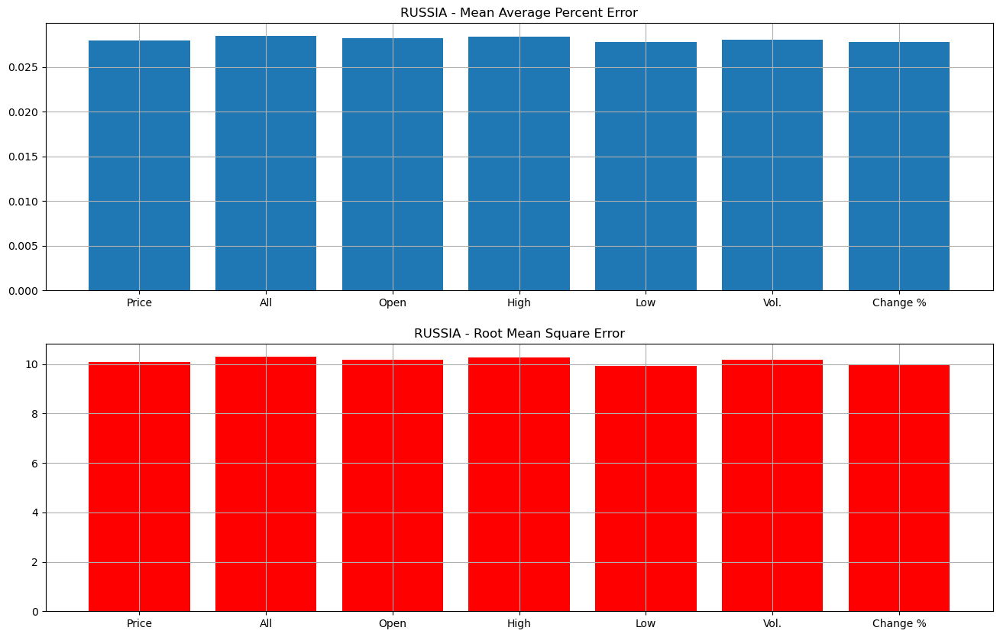


 <<< -------------------------------------------------- >>> 



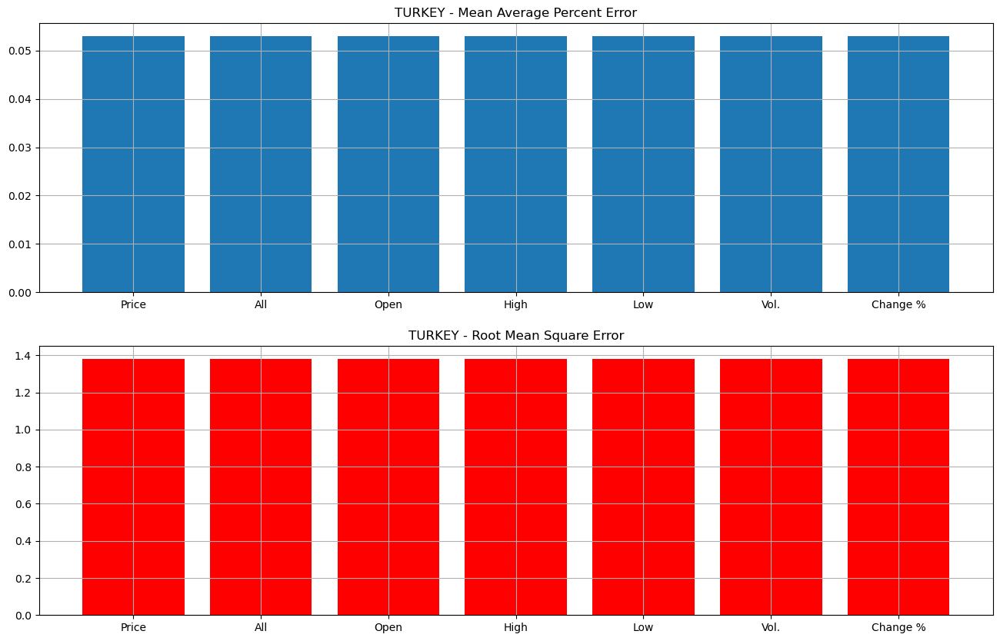


 <<< -------------------------------------------------- >>> 



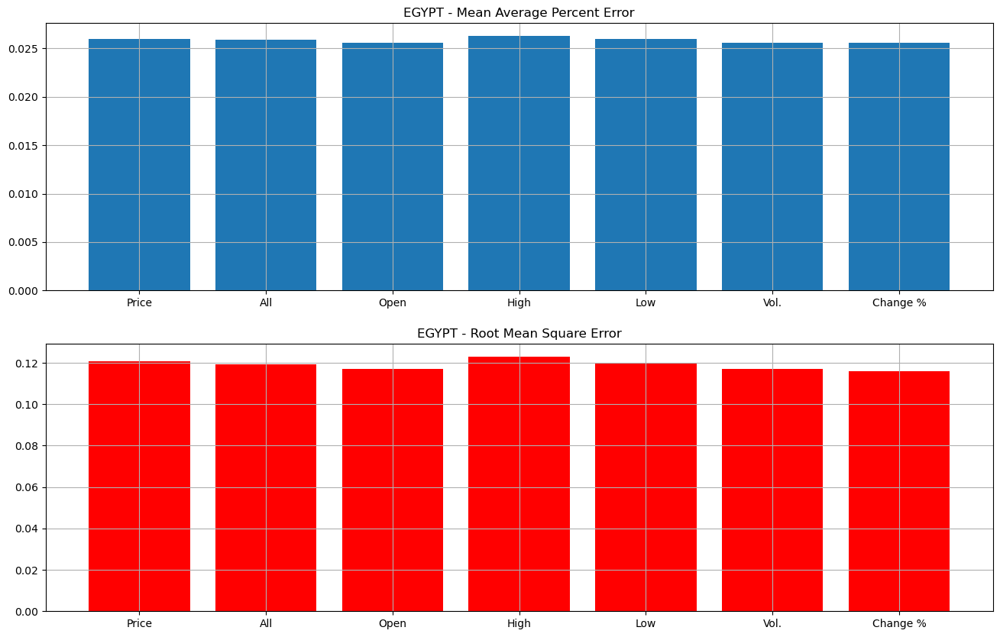


 <<< -------------------------------------------------- >>> 



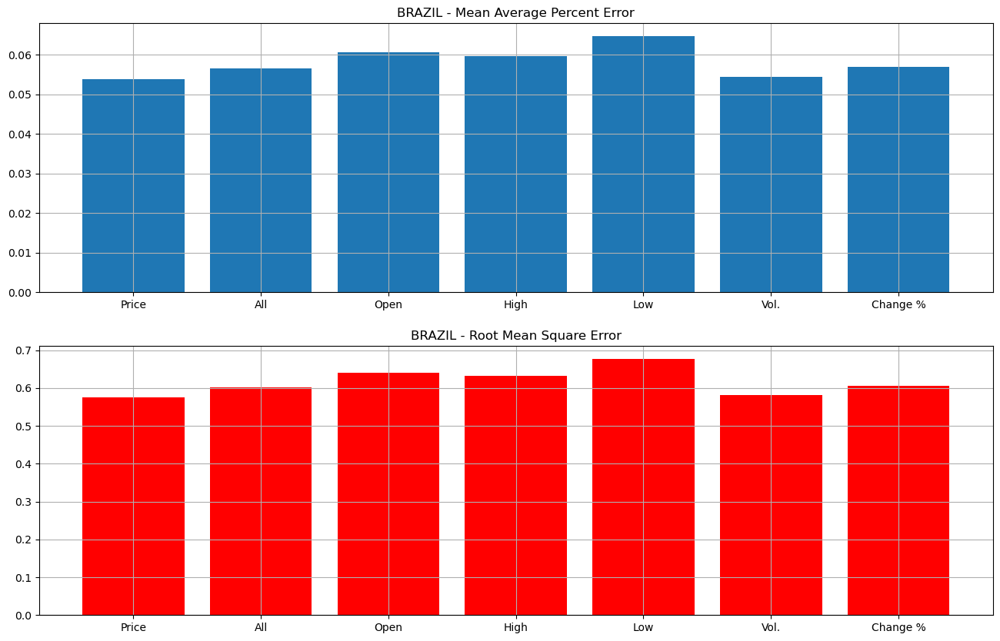


 <<< -------------------------------------------------- >>> 



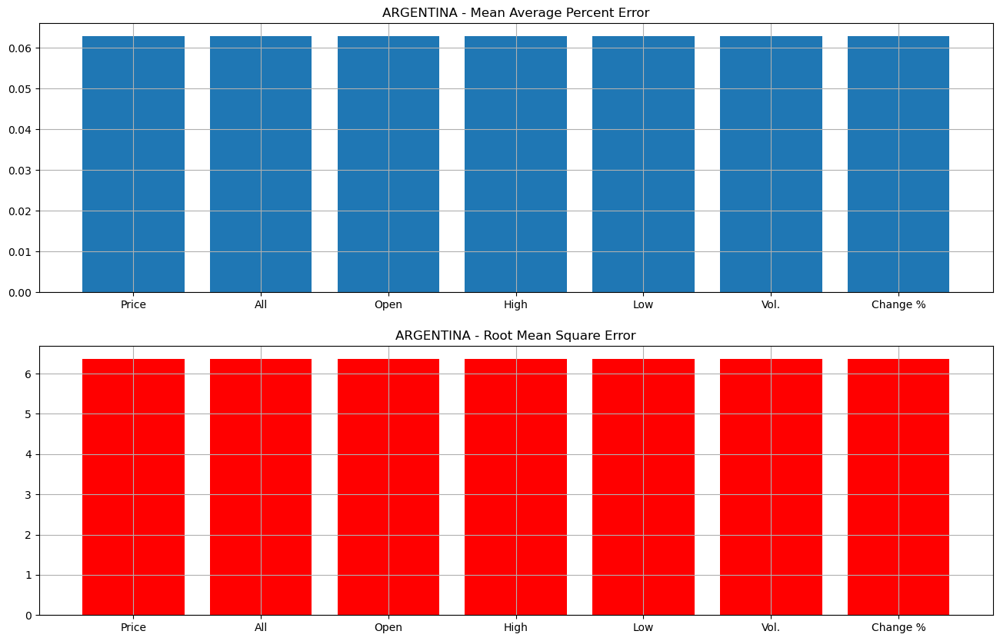


 <<< -------------------------------------------------- >>> 



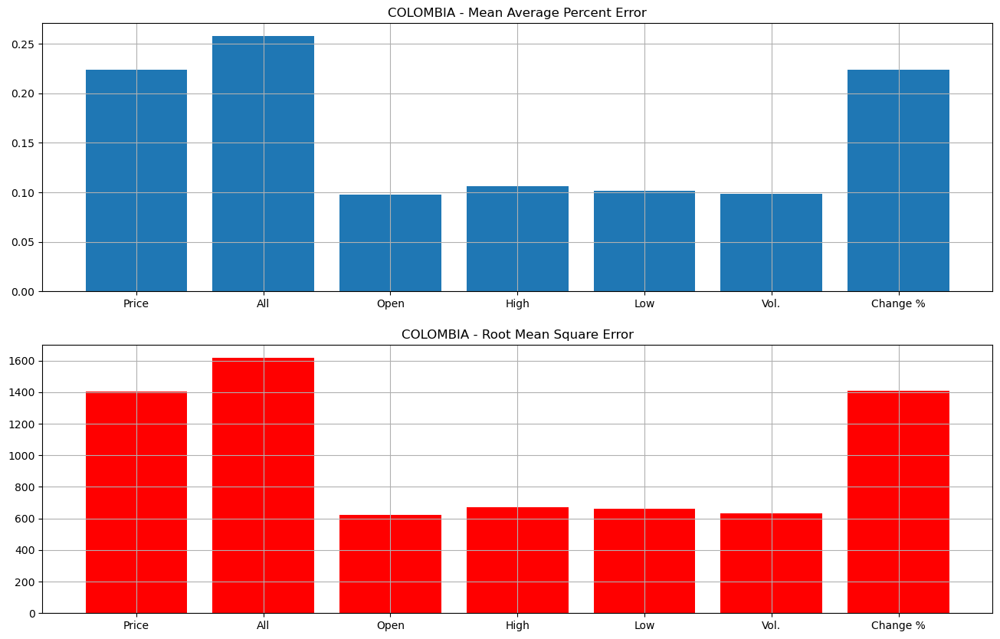


 <<< -------------------------------------------------- >>> 



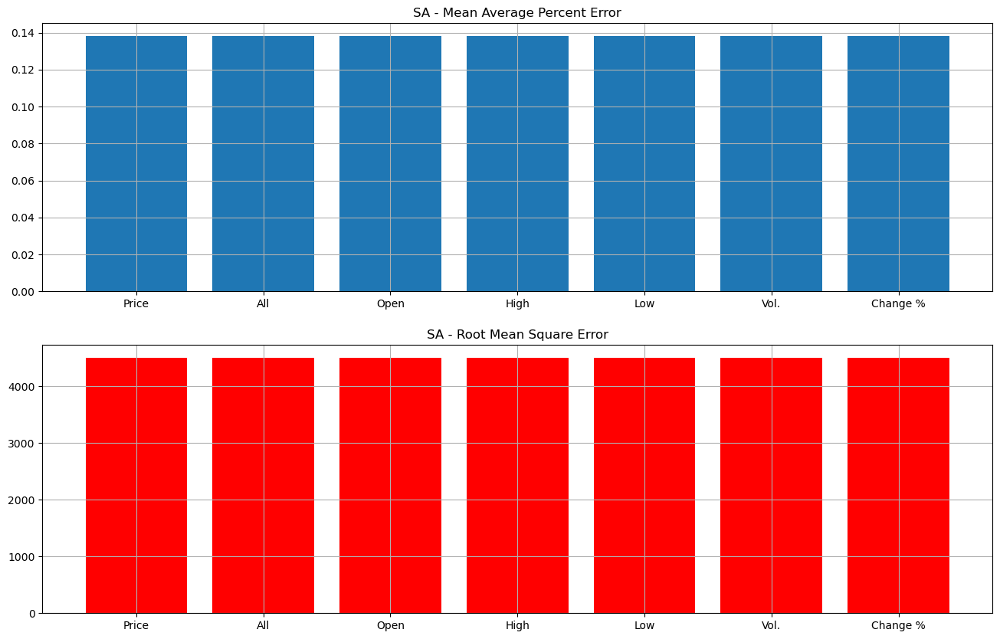


 <<< -------------------------------------------------- >>> 



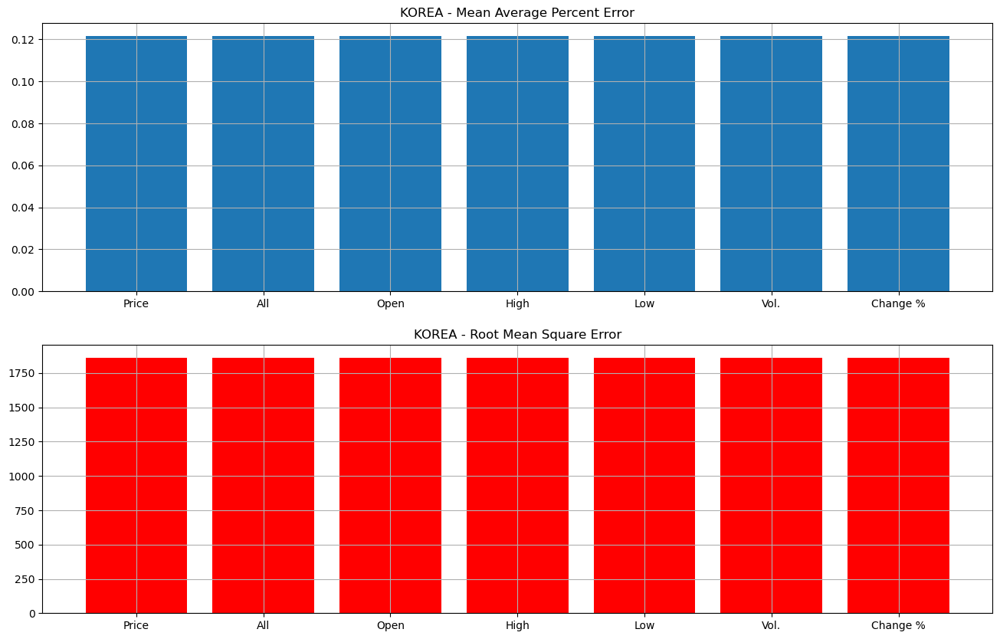


 <<< -------------------------------------------------- >>> 



In [28]:
for key in data.keys():
    tmp = performance.loc[key]
    fig, axes = plt.subplots(2,1,figsize=(16,10))
    axes[0].bar(tmp.loc["mape"].index, tmp.loc["mape"].values)
    axes[0].set_title(f"{key.upper()} - Mean Average Percent Error")
    axes[0].grid()
    axes[1].bar(tmp.loc["rmse"].index, tmp.loc["rmse"].values, color="red")
    axes[1].set_title(f"{key.upper()} - Root Mean Square Error")
    axes[1].grid()
    plt.show()
    barrier()

**NOTE:**
- The introduction of exogenous variables has no **uniform effect** on the performance in all countries.
- Three countries show some effects:
    - Brazil &rarr; performs worse
    - Columbia &rarr; performs better
    - Egypt &rarr; slightly better

### ARIMAX - Exo - Last moving average value

In [29]:
performance

Price        All       Open       High        Low  \
Country   Error                                                          
russia    mape      0.0280     0.0285     0.0282     0.0284     0.0278   
          rmse     10.0860    10.3025    10.1651    10.2637      9.942   
turkey    mape      0.0530      0.053      0.053      0.053      0.053   
          rmse      1.3809     1.3809     1.3809     1.3809     1.3809   
egypt     mape      0.0260     0.0259     0.0256     0.0263      0.026   
          rmse      0.1207     0.1192      0.117      0.123       0.12   
brazil    mape      0.0538     0.0565     0.0607     0.0597     0.0647   
          rmse      0.5753     0.6022     0.6399     0.6316      0.677   
argentina mape      0.0629     0.0629     0.0629     0.0629     0.0629   
          rmse      6.3660      6.366      6.366      6.366      6.366   
colombia  mape      0.2236      0.258     0.0975     0.1061     0.1013   
          rmse   1405.9817  1617.6368    621.141   669.4279   660.5879   
sa        mape      0.1382     0.1382     0.1382     0.1382     0.1382   
          rmse   4506.5862  4506.5862  4506.5862  4506.5862  4506.5862   
korea     mape      0.1216     0.1216     0.1216     0.1216     0.1216   
          rmse   1861.4729  1861.4729  1861.4729  1861.4729  1861.4729   

                      Vol.   Change %  
Country   Error                        
russia    mape      0.0281     0.0278  
          rmse     10.1807     9.9961  
turkey    mape       0.053      0.053  
          rmse      1.3809     1.3809  
egypt     mape      0.0256     0.0256  
          rmse      0.1172      0.116  
brazil    mape      0.0544      0.057  
          rmse      0.5816     0.6063  
argentina mape      0.0629     0.0629  
          rmse       6.366      6.366  
colombia  mape      0.0986     0.2241  
          rmse    632.0691  1407.0053  
sa        mape      0.1382     0.1382  
          rmse   4506.5862  4506.5862  
korea     mape      0.1216     0.1216  
          rmse   1861.4729  1861.4729

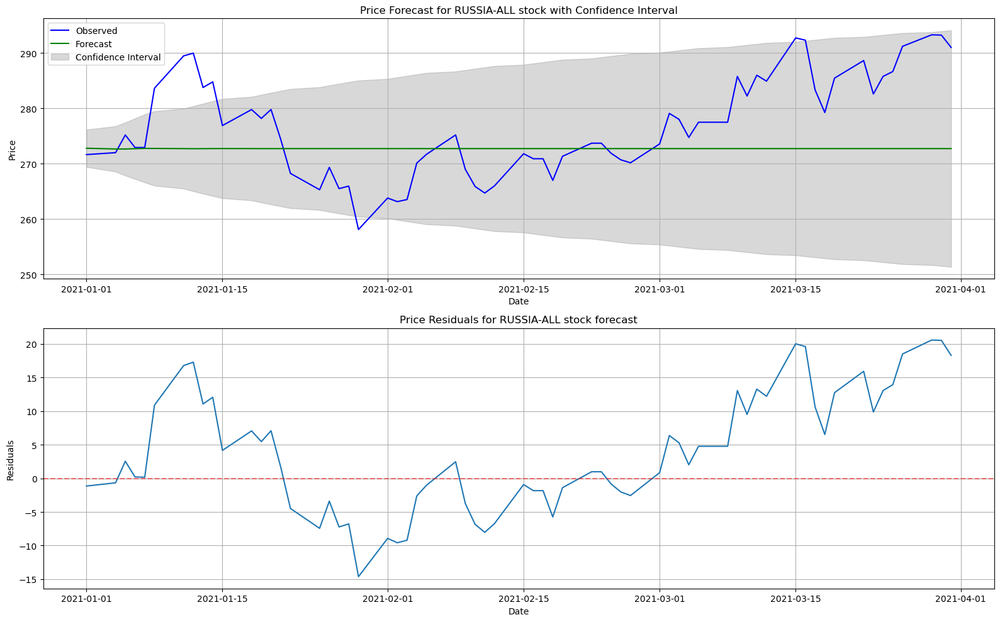

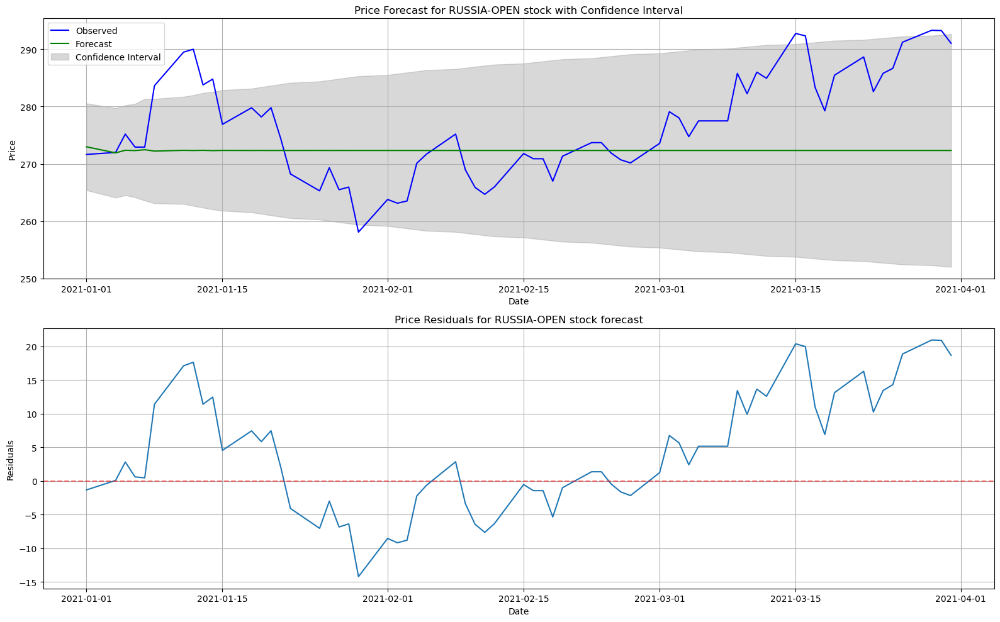

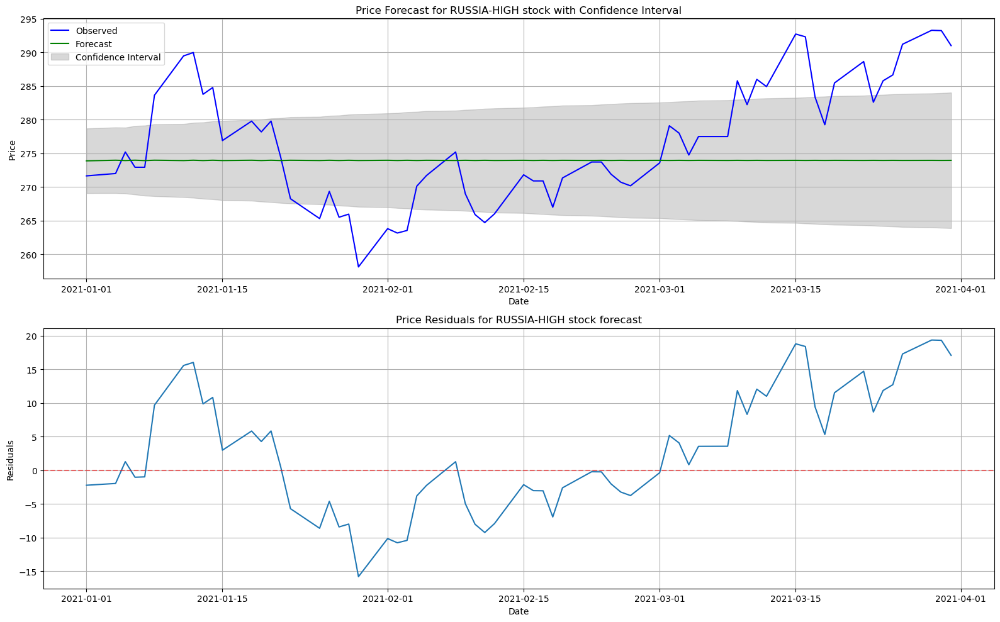

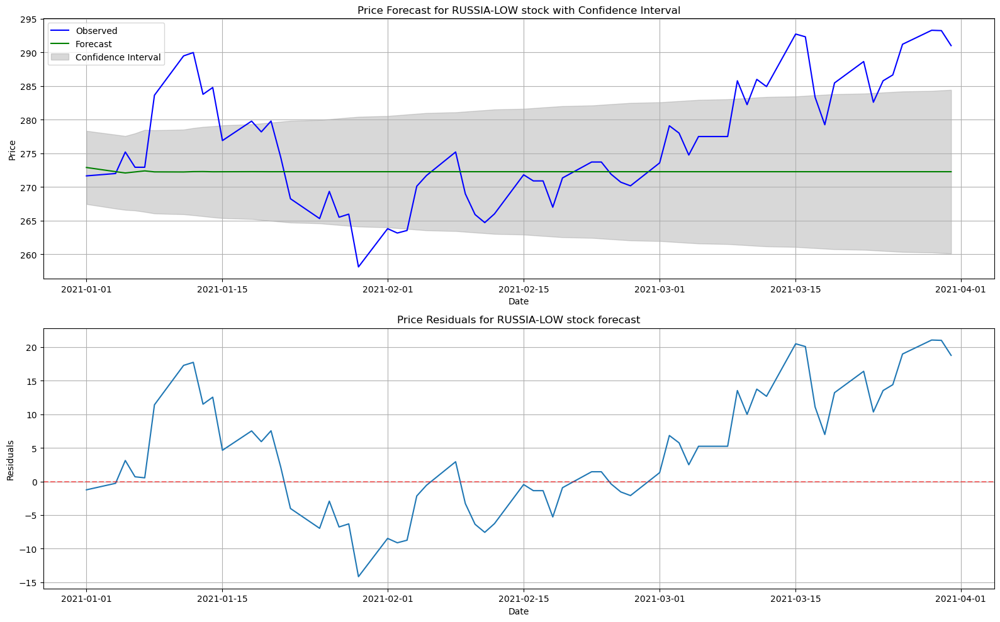

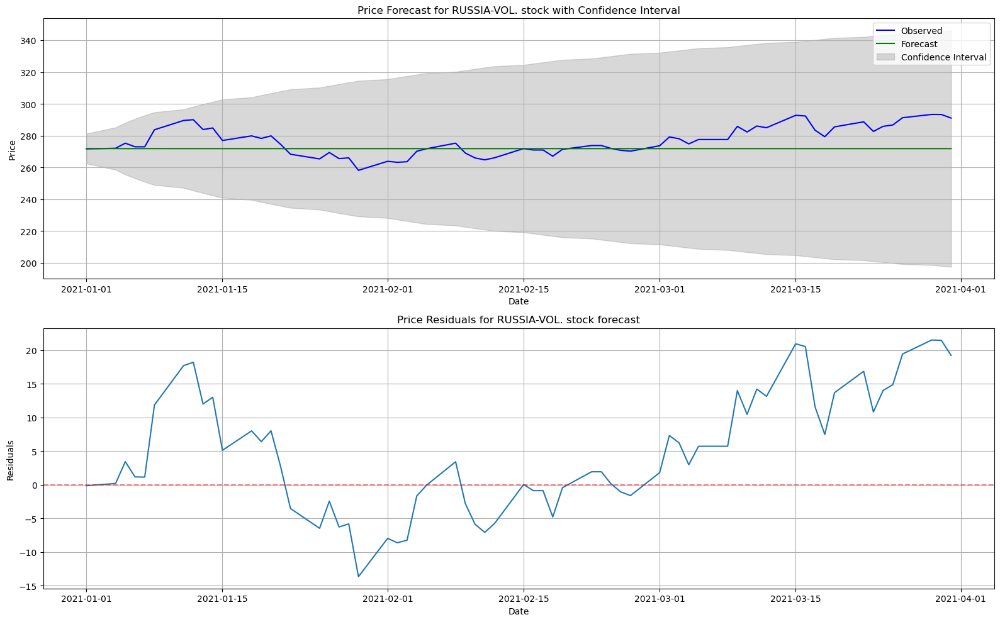

...

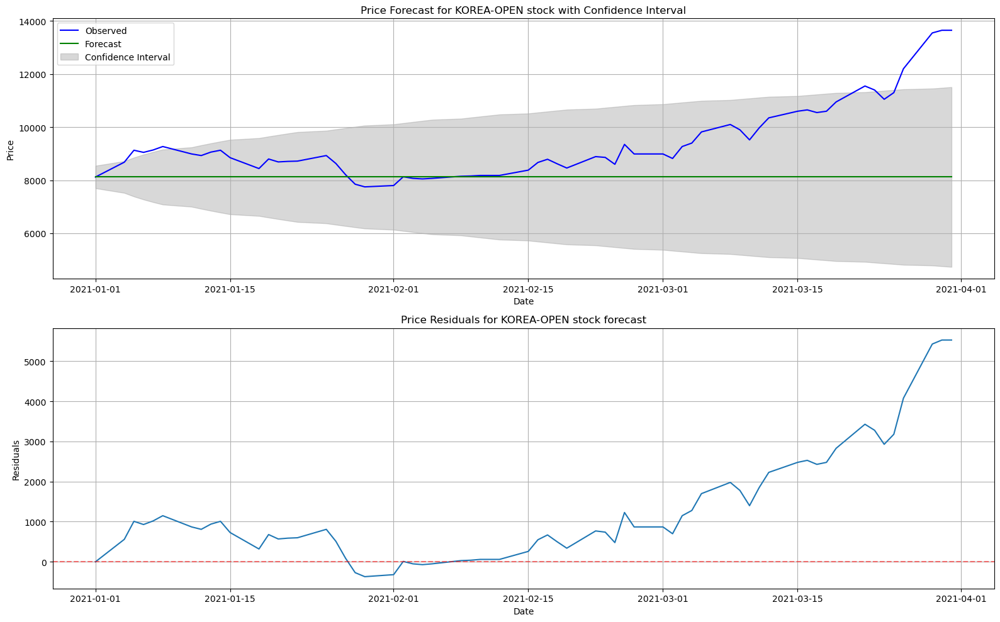

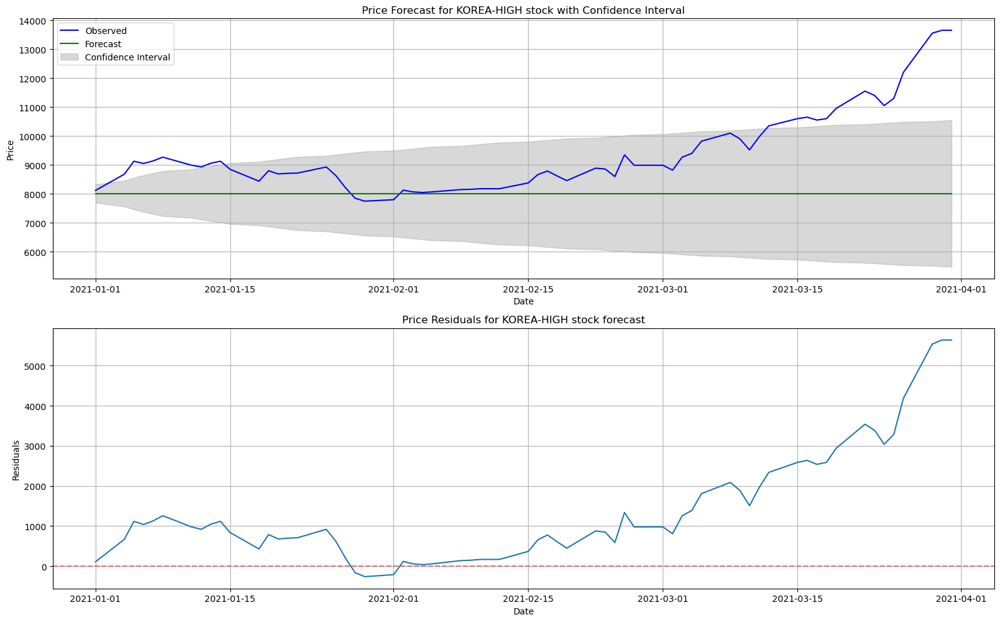

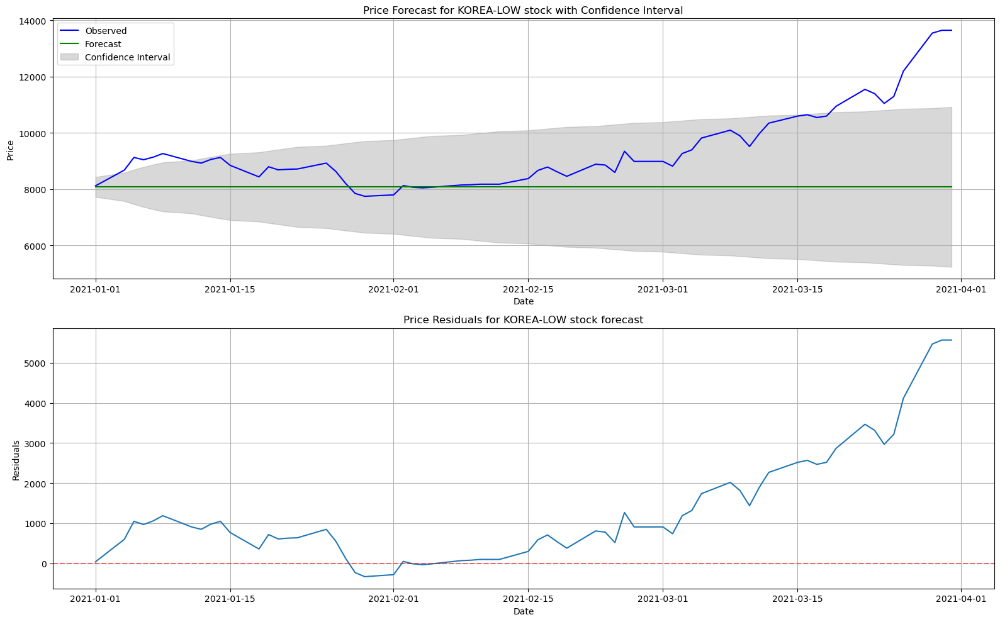

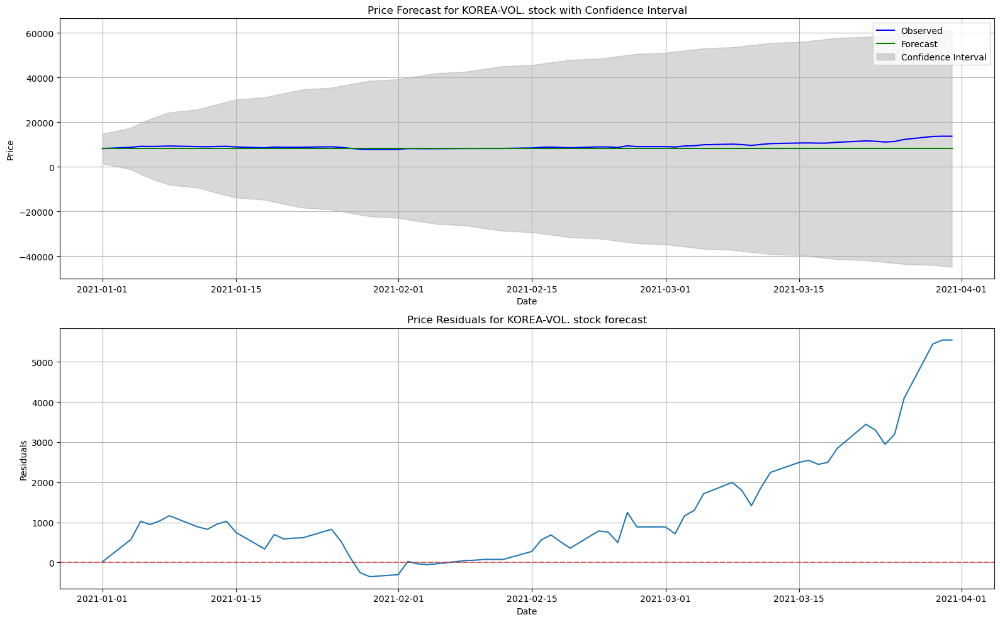

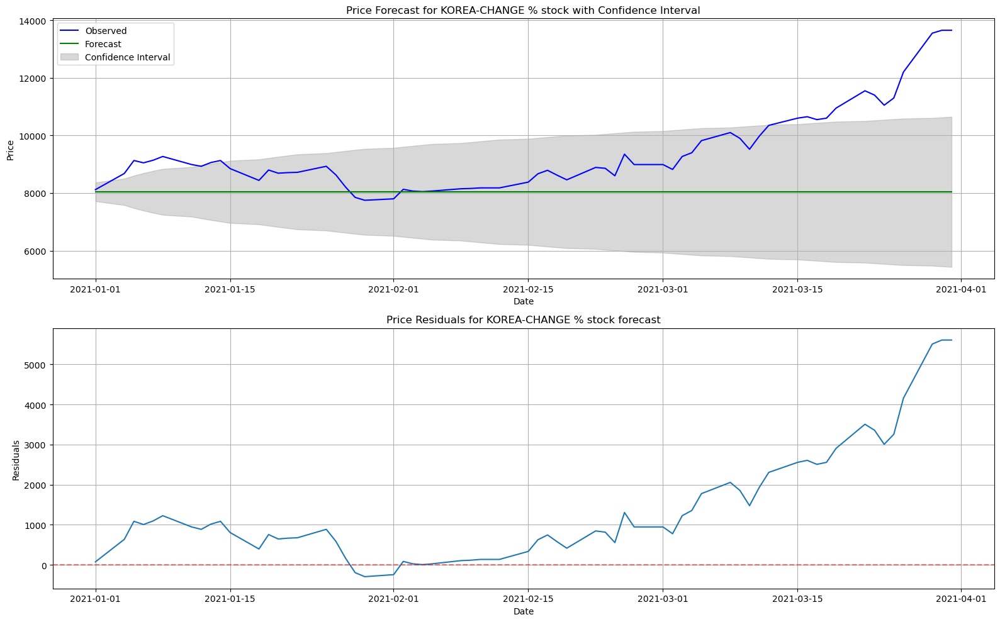

In [30]:
window_size = 20
ma_performance = performance.copy()
train_end = datetime(2020,12,31)
plot = True
ma_arimax_models = {}

# For each time series
for key in data.keys():
    # We compute the model and result with a single exogenous variable
    country_arimax_models = {}
    # For all the exogenous variables
    for exo_var in performance.columns:
        train_set = data[key]["Price"][:train_end]
        test_set = data[key]["Price"][train_end+timedelta(days=1):]
        # Create the test data range for later use
        start_test = train_end+timedelta(days=1)
        end_test = data[key]["Price"].index[-1]
        date_range = pd.date_range(start=start_test, end=end_test, freq="B")
        if exo_var == "Price":
            continue
        if exo_var == "All":
            train_exo = data[key][:train_end]
            train_exo = train_exo.drop("Price", axis=1)
            # Build the test exo_var using the last moving average value
            exo_rolling_mean = train_exo.rolling(window=window_size).mean()
            last_value = exo_rolling_mean.iloc[-1]
            exo_data = dict(zip(train_exo.columns, last_value))
            test_exo = pd.DataFrame(exo_data, index=date_range)
        else:
            train_exo = data[key][exo_var][:train_end]
            # Build the test exo_var using the last moving average value
            exo_rolling_mean = train_exo.rolling(window=window_size).mean()
            last_value = exo_rolling_mean[-1]
            test_exo = pd.Series(last_value, index=date_range)
        # Get the optimal order computed by auto ARIMA
        order = models_auto_arima[key].order
        # Create the model and fit it
        model = sm.tsa.SARIMAX(train_set, order=order, exog=train_exo)
        sarimax = model.fit()
        # Store the trained model in a dictionary
        country_arimax_models[exo_var] = sarimax
        # Compute the forecast & the residuals
        n_forecast_periods = len(test_set)
        forecast_results = sarimax.get_forecast(steps=n_forecast_periods, exog=test_exo)
        forecast = forecast_results.predicted_mean
        conf_int = forecast_results.conf_int()
        residuals = test_set - forecast
        # Compute and store the performance metrics
        mape = round(np.mean(abs(residuals/test_set)), 4)
        rmse = round(np.sqrt(np.mean(residuals**2)), 4)
        ma_performance.loc[(key, "mape"), exo_var] = mape
        ma_performance.loc[(key, "rmse"), exo_var] = rmse
        if plot:
            # Plot the observed data
            fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(16,10))
            axes[0].plot(test_set, label="Observed", color="blue")
            # Plot the forecasts and confidence intervals
            axes[0].plot(forecast, label="Forecast", color="green")
            axes[0].fill_between(forecast.index, conf_int["lower Price"], conf_int["upper Price"], color="gray",
                                 alpha=0.3, label="Confidence Interval")
            # Customize the plot
            axes[0].set_title(f"Price Forecast for {key.upper()}-{exo_var.upper()} stock with Confidence Interval")
            axes[0].set_xlabel("Date")
            axes[0].set_ylabel("Price")
            axes[0].legend()
            axes[0].grid(True)
            axes[1].plot(residuals)
            axes[1].axhline(y=0, color="red", alpha=0.5, linestyle="--")
            # Customize the plot
            axes[1].set_title(f"Price Residuals for {key.upper()}-{exo_var.upper()} stock forecast")
            axes[1].set_xlabel("Date")
            axes[1].set_ylabel("Residuals")
            axes[1].grid(True)
            # Show the plot
            plt.tight_layout()
            plt.show()
    ma_arimax_models[key] = country_arimax_models

In [31]:
ma_performance

Price        All       Open       High        Low  \
Country   Error                                                          
russia    mape      0.0280     0.0274     0.0277     0.0269     0.0278   
          rmse     10.0860     9.7304     9.8983     9.3006     9.9309   
turkey    mape      0.0530     0.0881     0.0603     0.0845     0.0833   
          rmse      1.3809     2.2175     1.5552     2.1387      2.112   
egypt     mape      0.0260     0.0287     0.0276     0.0292       0.03   
          rmse      0.1207     0.1372     0.1306     0.1397      0.144   
brazil    mape      0.0538     0.0573     0.0475     0.0517     0.0545   
          rmse      0.5753      0.609     0.5158     0.5555     0.5828   
argentina mape      0.0629     0.0535     0.0587     0.0504     0.0536   
          rmse      6.3660     5.5222     6.0051     5.2148     5.5321   
colombia  mape      0.2236     0.2084     0.0479     0.0502     0.0544   
          rmse   1405.9817  1372.7772   382.3446   352.5542   392.0951   
sa        mape      0.1382     0.1712      0.142     0.1704     0.1697   
          rmse   4506.5862  5138.0917  4577.5643  5122.0918  5108.4634   
korea     mape      0.1216     0.1357     0.1215     0.1313     0.1248   
          rmse   1861.4729  1967.2777  1860.9817   1934.875  1886.9454   

                      Vol.   Change %  
Country   Error                        
russia    mape      0.0281     0.0276  
          rmse     10.1516     9.8625  
turkey    mape      0.0527     0.0534  
          rmse      1.3747     1.3916  
egypt     mape      0.0256     0.0256  
          rmse      0.1159     0.1162  
brazil    mape      0.0553     0.0646  
          rmse        0.59     0.6757  
argentina mape      0.0627     0.0643  
          rmse      6.3498     6.4776  
colombia  mape      0.0986     0.2279  
          rmse    632.1883  1425.4631  
sa        mape       0.136     0.1385  
          rmse   4465.1286  4512.4235  
korea     mape      0.1229     0.1284  
          rmse   1871.8792  1914.4544

In [32]:
ma_arimax_models

{'russia': {'All': <statsmodels.tsa.statespace.sarimax.SARIMAXResultsWrapper at 0x208b5835610>,
  'Open': <statsmodels.tsa.statespace.sarimax.SARIMAXResultsWrapper at 0x208b57c2490>,
  'High': <statsmodels.tsa.statespace.sarimax.SARIMAXResultsWrapper at 0x208b5837090>,
  'Low': <statsmodels.tsa.statespace.sarimax.SARIMAXResultsWrapper at 0x208b574d610>,
  'Vol.': <statsmodels.tsa.statespace.sarimax.SARIMAXResultsWrapper at 0x208b5278150>,
  'Change %': <statsmodels.tsa.statespace.sarimax.SARIMAXResultsWrapper at 0x208b52947d0>},
 'turkey': {'All': <statsmodels.tsa.statespace.sarimax.SARIMAXResultsWrapper at 0x208b53cb0d0>,
  'Open': <statsmodels.tsa.statespace.sarimax.SARIMAXResultsWrapper at 0x208b56cc7d0>,
  'High': <statsmodels.tsa.statespace.sarimax.SARIMAXResultsWrapper at 0x208b5b4bf50>,
  'Low': <statsmodels.tsa.statespace.sarimax.SARIMAXResultsWrapper at 0x208b51b2410>,
  'Vol.': <statsmodels.tsa.statespace.sarimax.SARIMAXResultsWrapper at 0x208b5bbb0d0>,
  'Change %': <statsmo

In [33]:
with open("../data/performance_arimax_ma.pkl", "wb") as handle:
    pickle.dump(ma_performance, handle)

In [34]:
with open("../data/models_arimax_ma.pkl", "wb") as handle:
    pickle.dump(ma_arimax_models, handle)

#### Performance analysis

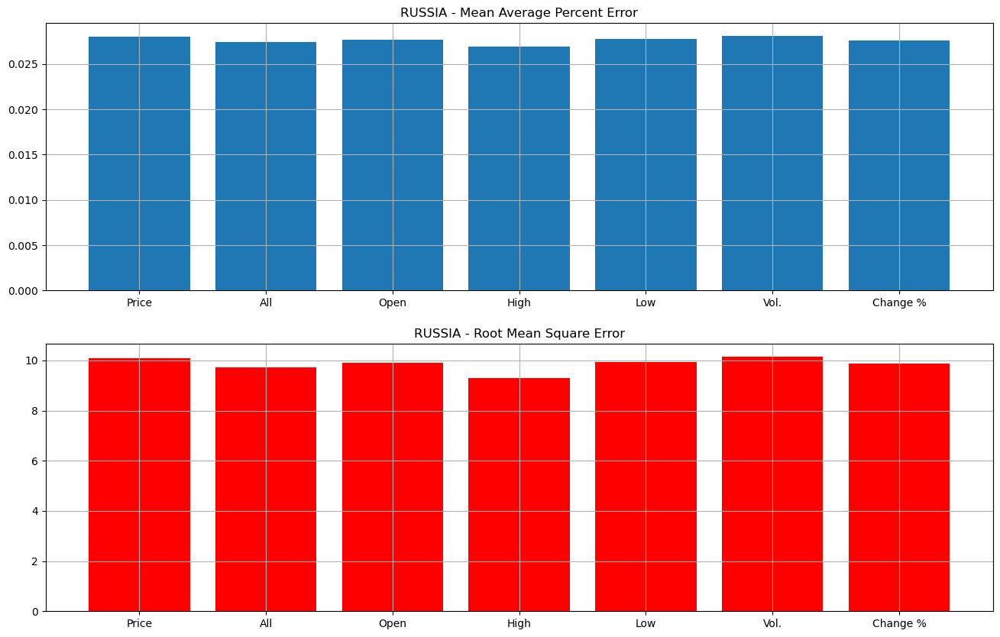


 <<< -------------------------------------------------- >>> 



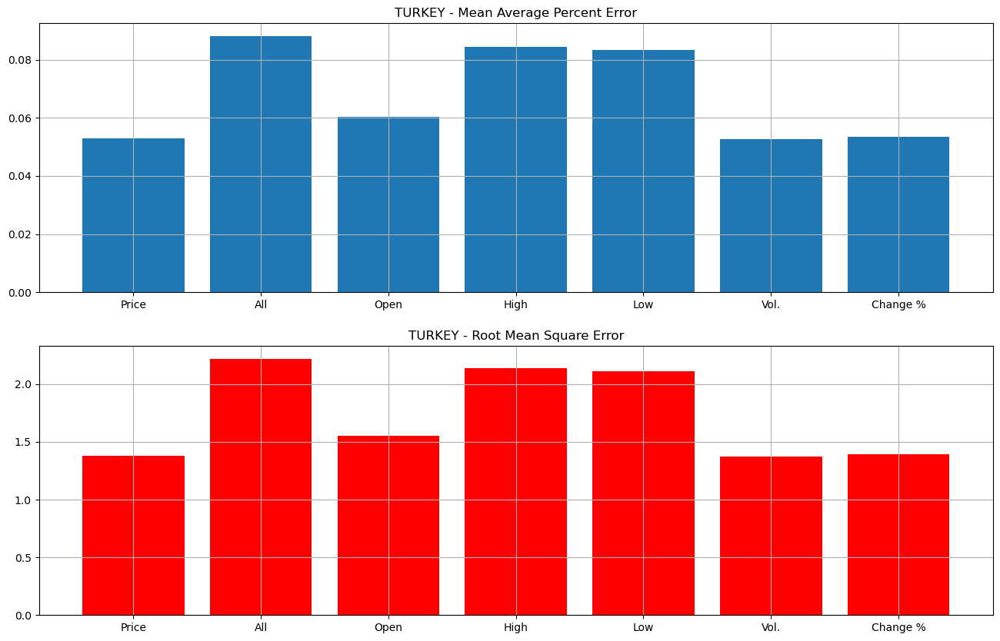


 <<< -------------------------------------------------- >>> 



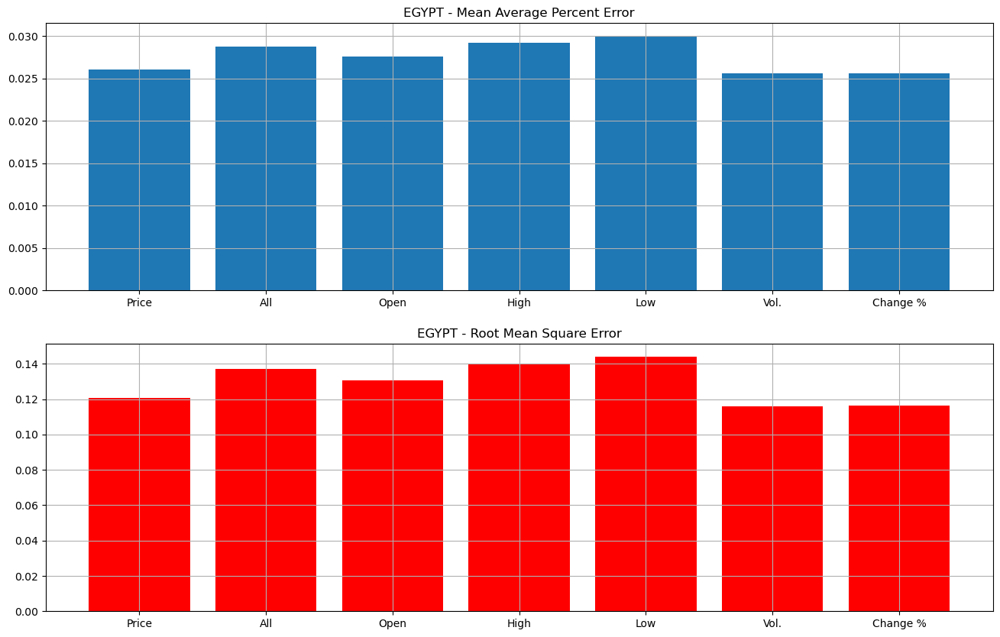


 <<< -------------------------------------------------- >>> 



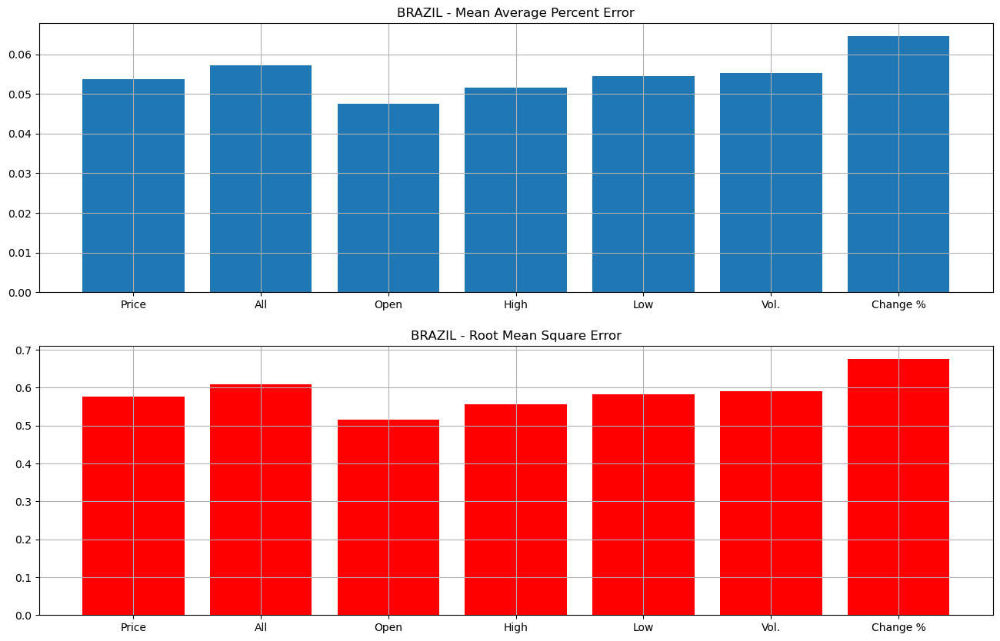


 <<< -------------------------------------------------- >>> 



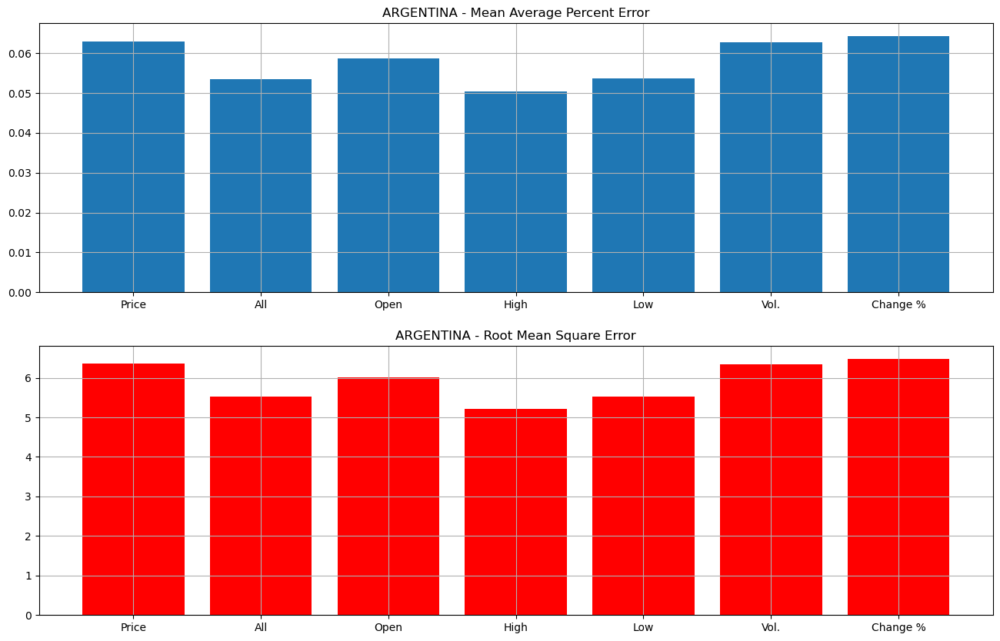


 <<< -------------------------------------------------- >>> 



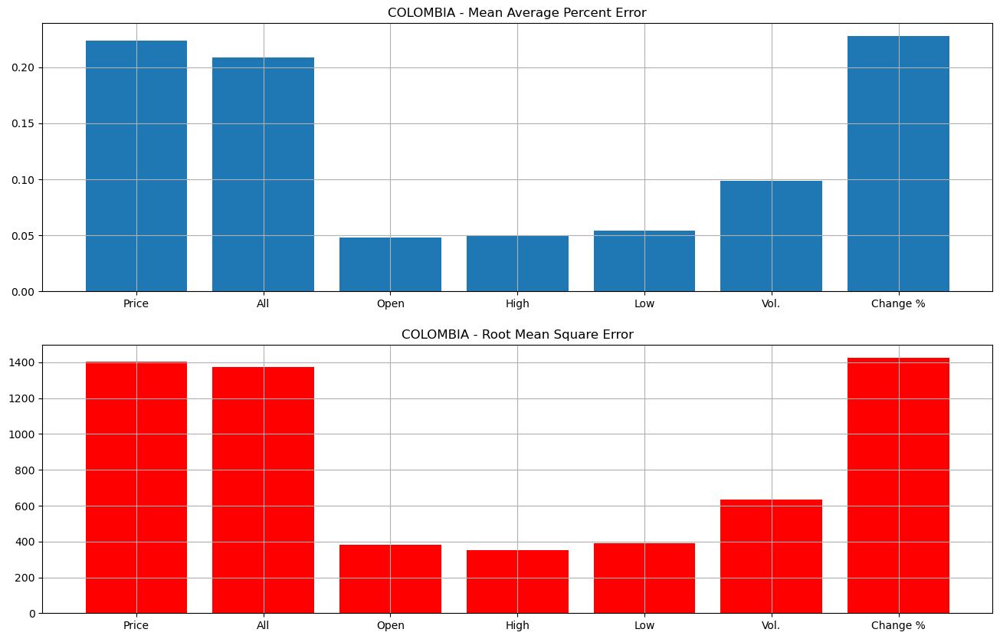


 <<< -------------------------------------------------- >>> 



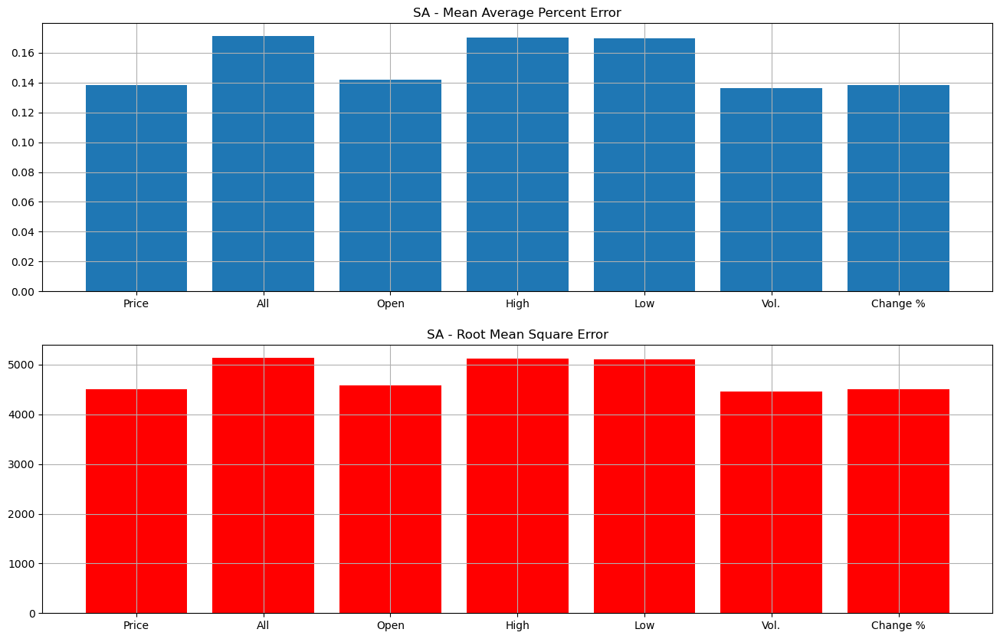


 <<< -------------------------------------------------- >>> 



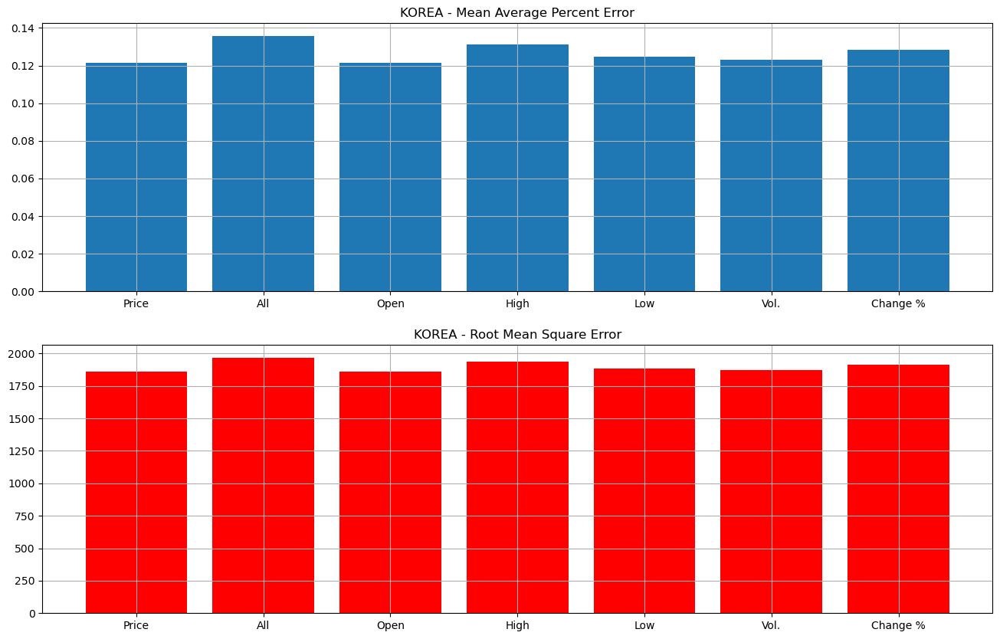


 <<< -------------------------------------------------- >>> 



In [35]:
for key in data.keys():
    tmp = ma_performance.loc[key]
    fig, axes = plt.subplots(2,1,figsize=(16,10))
    axes[0].bar(tmp.loc["mape"].index, tmp.loc["mape"].values)
    axes[0].set_title(f"{key.upper()} - Mean Average Percent Error")
    axes[0].grid()
    axes[1].bar(tmp.loc["rmse"].index, tmp.loc["rmse"].values, color="red")
    axes[1].set_title(f"{key.upper()} - Root Mean Square Error")
    axes[1].grid()
    plt.show()
    barrier()

**NOTE:**
- Using the `last moving average value` seems to have a **greater effect** on performance than using the `last value`.

### Rolling Forecast Origin - Exo - Last moving average

**NOTE:**
- First, we select the optimal combination of exogenous variables for each model.
- From the analysis of the above graphs, we notice that the two error measures we consider show the same ranking of features.

In [36]:
ma_performance

Price        All       Open       High        Low  \
Country   Error                                                          
russia    mape      0.0280     0.0274     0.0277     0.0269     0.0278   
          rmse     10.0860     9.7304     9.8983     9.3006     9.9309   
turkey    mape      0.0530     0.0881     0.0603     0.0845     0.0833   
          rmse      1.3809     2.2175     1.5552     2.1387      2.112   
egypt     mape      0.0260     0.0287     0.0276     0.0292       0.03   
          rmse      0.1207     0.1372     0.1306     0.1397      0.144   
brazil    mape      0.0538     0.0573     0.0475     0.0517     0.0545   
          rmse      0.5753      0.609     0.5158     0.5555     0.5828   
argentina mape      0.0629     0.0535     0.0587     0.0504     0.0536   
          rmse      6.3660     5.5222     6.0051     5.2148     5.5321   
colombia  mape      0.2236     0.2084     0.0479     0.0502     0.0544   
          rmse   1405.9817  1372.7772   382.3446   352.5542   392.0951   
sa        mape      0.1382     0.1712      0.142     0.1704     0.1697   
          rmse   4506.5862  5138.0917  4577.5643  5122.0918  5108.4634   
korea     mape      0.1216     0.1357     0.1215     0.1313     0.1248   
          rmse   1861.4729  1967.2777  1860.9817   1934.875  1886.9454   

                      Vol.   Change %  
Country   Error                        
russia    mape      0.0281     0.0276  
          rmse     10.1516     9.8625  
turkey    mape      0.0527     0.0534  
          rmse      1.3747     1.3916  
egypt     mape      0.0256     0.0256  
          rmse      0.1159     0.1162  
brazil    mape      0.0553     0.0646  
          rmse        0.59     0.6757  
argentina mape      0.0627     0.0643  
          rmse      6.3498     6.4776  
colombia  mape      0.0986     0.2279  
          rmse    632.1883  1425.4631  
sa        mape       0.136     0.1385  
          rmse   4465.1286  4512.4235  
korea     mape      0.1229     0.1284  
          rmse   1871.8792  1914.4544

In [37]:
ma_performance.loc[ma_performance.index.get_level_values("Error")=="mape"]

,,Price,All,Open,High,Low,Vol.,Change %
Country,Error,,,,,,,
russia,mape,0.0280,0.0274,0.0277,0.0269,0.0278,0.0281,0.0276
turkey,mape,0.0530,0.0881,0.0603,0.0845,0.0833,0.0527,0.0534
egypt,mape,0.0260,0.0287,0.0276,0.0292,0.03,0.0256,0.0256
brazil,mape,0.0538,0.0573,0.0475,0.0517,0.0545,0.0553,0.0646
argentina,mape,0.0629,0.0535,0.0587,0.0504,0.0536,0.0627,0.0643
colombia,mape,0.2236,0.2084,0.0479,0.0502,0.0544,0.0986,0.2279
sa,mape,0.1382,0.1712,0.142,0.1704,0.1697,0.136,0.1385
korea,mape,0.1216,0.1357,0.1215,0.1313,0.1248,0.1229,0.1284


In [38]:
ma_performance.loc[ma_performance.index.get_level_values("Error")=="mape"].info()

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 8 entries, ('russia', 'mape') to ('korea', 'mape')
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   Price     8 non-null      float64
 1   All       8 non-null      object 
 2   Open      8 non-null      object 
 3   High      8 non-null      object 
 4   Low       8 non-null      object 
 5   Vol.      8 non-null      object 
 6   Change %  8 non-null      object 
dtypes: float64(1), object(6)
memory usage: 1.0+ KB


In [39]:
for col in ma_performance.columns:
    ma_performance[col] = ma_performance[col].astype(float)

mask = ma_performance.index.get_level_values("Error")=="mape"
best_exo = ma_performance.loc[mask].apply(lambda x: x.idxmin(), axis=1)
best_exo = best_exo.reset_index(level="Error", drop=True)
best_exo

Country
russia       High
turkey       Vol.
egypt        Vol.
brazil       Open
argentina    High
colombia     Open
sa           Vol.
korea        Open
dtype: object

In [40]:
for key in data.keys():
    print(f"{key.upper()} optimal order is: {models_auto_arima[key].order}")

RUSSIA optimal order is: (3, 1, 2)
TURKEY optimal order is: (0, 1, 0)
EGYPT optimal order is: (2, 1, 2)
BRAZIL optimal order is: (2, 1, 2)
ARGENTINA optimal order is: (0, 1, 0)
COLOMBIA optimal order is: (3, 2, 2)
SA optimal order is: (0, 1, 0)
KOREA optimal order is: (0, 1, 0)


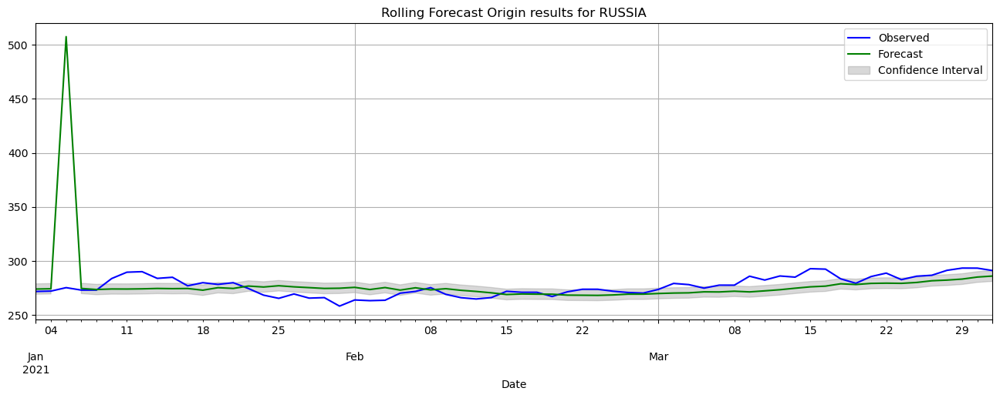

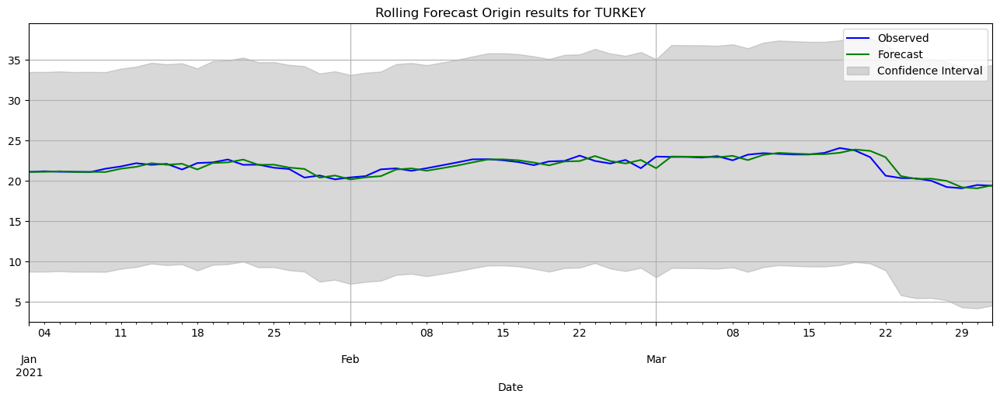

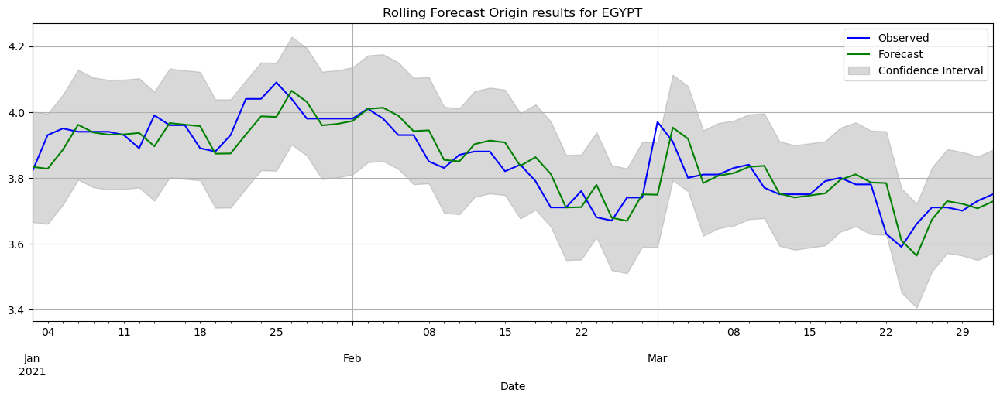

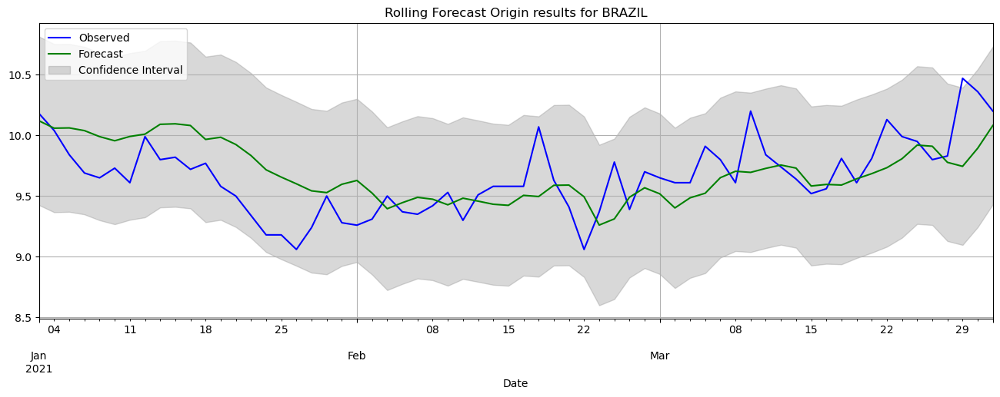

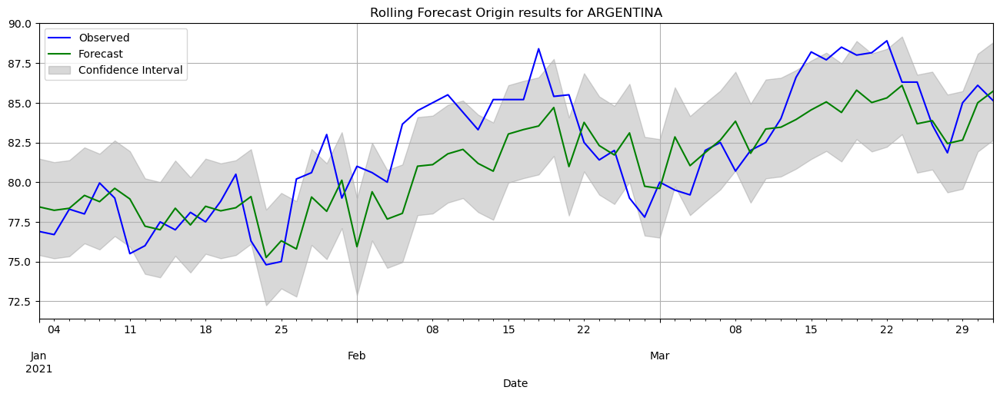

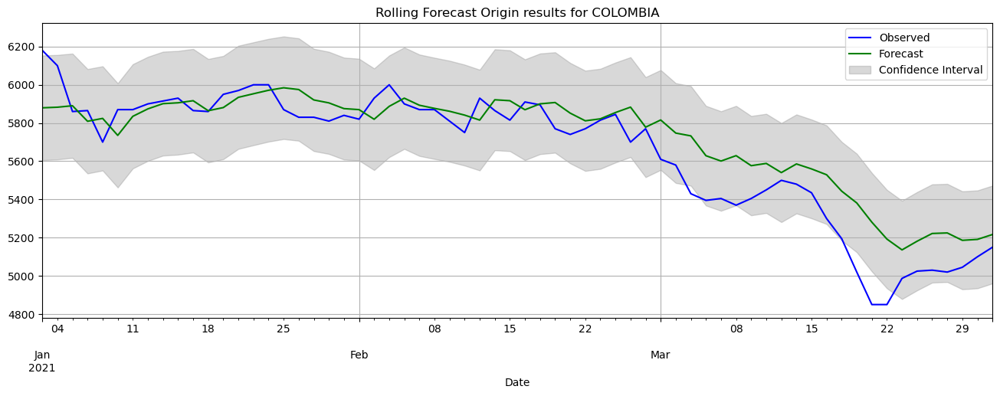

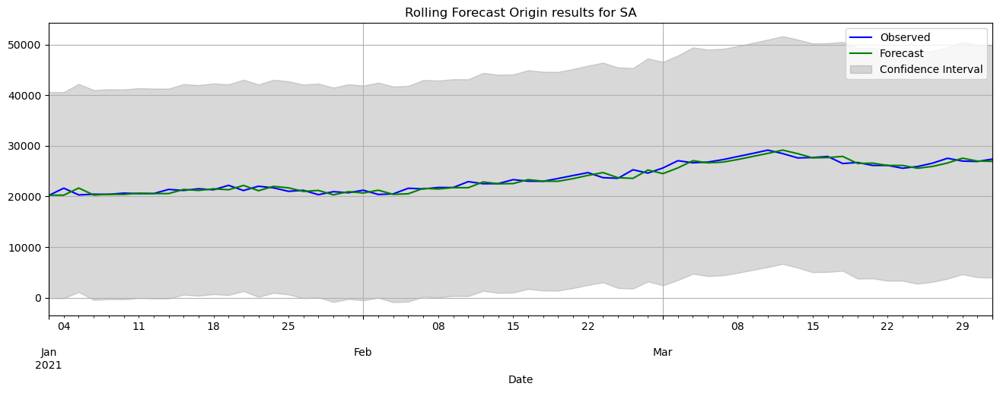

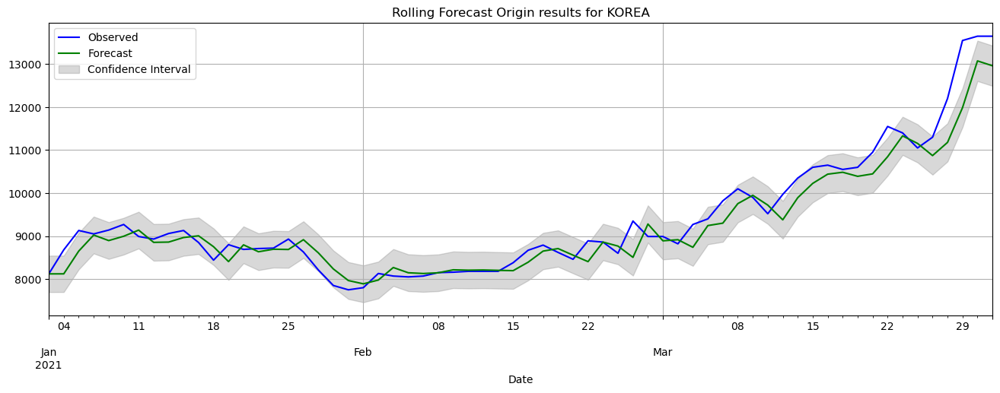

In [41]:
window_size = 20
plot = True
rfo_results = {}

for key in data.keys():
    # Initialize an empty DataFrame to store forecast results
    results = pd.DataFrame(columns=["Date", "Actual", "Forecast", "Conf Int low", "Conf Int high"])
    # Perform rolling forecasts
    for predicted_date in pd.date_range(start="2021-01-01", end="2021-03-31", freq="B"):
        # Split the data according to the new prediciton date
        curr_train_set = data[key]["Price"][:predicted_date-timedelta(days=1)]
        curr_test_set = data[key]["Price"][predicted_date:predicted_date]
        # Do the same thing for the exo variable
        if best_exo[key] == "All":
            curr_train_exo = data[key][:predicted_date-timedelta(days=1)]
            curr_train_exo = curr_train_exo.drop("Price", axis=1)
        else:
            curr_train_exo = data[key][best_exo[key]][:predicted_date-timedelta(days=1)]
        # Build the test exo_var using the last moving average value
        exo_rolling_mean = curr_train_exo.rolling(window=window_size).mean()
        curr_test_exo = exo_rolling_mean[-1]
        # Get the optimal order computed by auto ARIMA
        order = models_auto_arima[key].order
        # Create the model and fit it
        model = sm.tsa.SARIMAX(curr_train_set, order=order, exog=curr_train_exo)
        sarimax = model.fit()
        # Make predictions
        forecast_results = sarimax.get_forecast(steps=1, exog=curr_test_exo)
        forecast = forecast_results.predicted_mean
        conf_int = forecast_results.conf_int()
        # Concat the results to the dataframe
        curr_results = pd.DataFrame({"Date": predicted_date, "Actual": curr_test_set, "Forecast": forecast,
                                     "Conf Int low": conf_int["lower Price"], "Conf Int high": conf_int["upper Price"]})
        results = pd.concat((results, curr_results), ignore_index=True)
    # Once we have done the forecast of the full period, we save the results
    results.set_index("Date", inplace=True)
    rfo_results[key] = results
    # And we plot them if required
    if plot:
        results["Actual"].plot(label="Observed", color="blue", figsize=(16,5), grid="on")
        results["Forecast"].plot(label="Forecast", color="green", figsize=(16,5), grid="on")
        plt.fill_between(results.index, results["Conf Int low"], results["Conf Int high"], color="gray", alpha=0.3,
                         label="Confidence Interval")
        plt.grid(True)
        plt.legend()
        plt.title(f"Rolling Forecast Origin results for {key.upper()}")
        plt.show()

In [42]:
display_for_all_keys(rfo_results)

RUSSIA:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,271.65,273.889034,269.081132,278.696936
2021-01-04,272.00,274.169082,269.369837,278.968326
2021-01-05,275.20,507.562543,NaN,NaN
2021-01-06,272.93,274.451287,269.654412,279.248162
2021-01-07,272.93,273.470627,268.681762,278.259492


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,286.66,281.572298,276.608462,286.536134
2021-03-26,291.22,282.190178,277.223972,287.156384
2021-03-29,293.30,283.132963,278.170677,288.095248
2021-03-30,293.25,285.009932,280.047106,289.972759
2021-03-31,291.02,285.937537,280.982418,290.892655



 <<< -------------------------------------------------- >>> 

TURKEY:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,21.12,21.131333,8.764556,33.498110
2021-01-04,21.20,21.131460,8.764683,33.498237
2021-01-05,21.14,21.196451,8.829007,33.563895
2021-01-06,21.14,21.115874,8.747395,33.484354
2021-01-07,21.10,21.129954,8.761442,33.498465


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,20.02,20.282383,5.505113,35.059652
2021-03-26,19.25,20.007809,5.220718,34.794900
2021-03-29,19.10,19.212467,4.342593,34.082342
2021-03-30,19.50,19.088600,4.216712,33.960488
2021-03-31,19.41,19.467366,4.577237,34.357495



 <<< -------------------------------------------------- >>> 

EGYPT:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,3.82,3.833321,3.665416,4.001226
2021-01-04,3.93,3.827565,3.659992,3.995139
2021-01-05,3.95,3.885462,3.718112,4.052812
2021-01-06,3.94,3.961233,3.794040,4.128427
2021-01-07,3.94,3.937795,3.770889,4.104702


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,3.71,3.673023,3.515001,3.831045
2021-03-26,3.71,3.729126,3.571302,3.886950
2021-03-29,3.70,3.721001,3.563423,3.878580
2021-03-30,3.73,3.707282,3.549955,3.864610
2021-03-31,3.75,3.728166,3.571070,3.885261



 <<< -------------------------------------------------- >>> 

BRAZIL:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,10.18,10.119827,9.425489,10.814165
2021-01-04,10.04,10.059381,9.366296,10.752465
2021-01-05,9.84,10.061457,9.369693,10.753221
2021-01-06,9.69,10.039223,9.348675,10.729771
2021-01-07,9.65,9.989758,9.300457,10.679058


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,9.80,9.910363,9.261154,10.559572
2021-03-26,9.83,9.777710,9.128823,10.426598
2021-03-29,10.47,9.744856,9.096968,10.392744
2021-03-30,10.36,9.894252,9.243159,10.545344
2021-03-31,10.20,10.081676,9.431578,10.731775



 <<< -------------------------------------------------- >>> 

ARGENTINA:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,76.90,78.446448,75.411722,81.481173
2021-01-04,76.70,78.229371,75.200464,81.258277
2021-01-05,78.30,78.356805,75.333345,81.380265
2021-01-06,78.00,79.167306,76.147054,82.187559
2021-01-07,79.95,78.773932,75.759188,81.788676


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,83.60,83.871208,80.791202,86.951213
2021-03-26,81.85,82.434217,79.354371,85.514064
2021-03-29,85.00,82.652419,79.577334,85.727505
2021-03-30,86.10,85.000000,81.920587,88.079413
2021-03-31,85.15,85.714257,82.638983,88.789531



 <<< -------------------------------------------------- >>> 

COLOMBIA:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,6180.0,5879.473904,5605.637398,6153.310409
2021-01-04,6100.0,5882.611551,5609.265227,6155.957876
2021-01-05,5860.0,5890.348774,5617.565860,6163.131688
2021-01-06,5865.0,5809.046720,5535.937935,6082.155506
2021-01-07,5700.0,5824.082961,5551.500131,6096.665791


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,5030.0,5221.947430,4964.820480,5479.074380
2021-03-26,5020.0,5224.727153,4967.980556,5481.473749
2021-03-29,5045.0,5186.152242,4929.778981,5442.525502
2021-03-30,5100.0,5191.008454,4934.984075,5447.032832
2021-03-31,5150.0,5216.579814,4960.782311,5472.377317



 <<< -------------------------------------------------- >>> 

SA:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,20190.0,20242.758275,-125.174217,40610.690767
2021-01-04,21629.0,20237.638975,-130.293517,40605.571467
2021-01-05,20288.0,21649.188314,1092.404015,42205.972612
2021-01-06,20436.0,20270.768176,-462.572688,41004.109040
2021-01-07,20400.0,20425.696819,-309.899884,41161.293522


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,26564.0,25922.567059,3093.634051,48751.500066
2021-03-26,27533.0,26597.467084,3729.868028,49465.066139
2021-03-29,26980.0,27550.687616,4606.106365,50495.268867
2021-03-30,26898.0,26976.769770,4004.523495,49949.016045
2021-03-31,27373.0,26922.697340,3950.213601,49895.181079



 <<< -------------------------------------------------- >>> 

KOREA:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,8120.0,8120.733159,7697.330225,8544.136093
2021-01-04,8680.0,8121.184240,7698.573817,8543.794662
2021-01-05,9130.0,8650.874061,8224.248286,9077.499836
2021-01-06,9050.0,9024.460034,8596.255412,9452.664656
2021-01-07,9140.0,8895.298546,8467.536810,9323.060281


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,11300.0,10872.506729,10428.498310,11316.515149
2021-03-26,12200.0,11179.174756,10734.752289,11623.597222
2021-03-29,13550.0,11986.746725,11534.196984,12439.296466
2021-03-30,13650.0,13075.283437,12606.274131,13544.292742
2021-03-31,13650.0,12962.290680,12493.477108,13431.104253



 <<< -------------------------------------------------- >>> 



In [43]:
with open("../data/results_rfo_ma.pkl", "wb") as handle:
    pickle.dump(rfo_results, handle)

#### Performance analysis

- Compute the residuals and the error measures

In [44]:
for key in data.keys():
    tmp = rfo_results[key]
    residuals = tmp["Actual"] - tmp["Forecast"]
    # Compute and store the performance metrics
    mape = round(np.mean(abs(residuals/tmp["Actual"])), 4)
    rmse = round(np.sqrt(np.mean(residuals**2)), 4)
    print_bold_underline(f"Rolling Forecast Origin performance metrics for {key.upper()}:")
    print(f"- Mean Absolute Percent Error: {round(mape * 100, 3)} %")
    print(f"- Root Mean Square Error:    {round(rmse, 3)}")
    barrier()

Rolling Forecast Origin performance metrics for RUSSIA:
- Mean Absolute Percent Error: 3.71 %
- Root Mean Square Error:    30.12

 <<< -------------------------------------------------- >>> 

Rolling Forecast Origin performance metrics for TURKEY:
- Mean Absolute Percent Error: 1.68 %
- Root Mean Square Error:    0.528

 <<< -------------------------------------------------- >>> 

Rolling Forecast Origin performance metrics for EGYPT:
- Mean Absolute Percent Error: 1.08 %
- Root Mean Square Error:    0.06

 <<< -------------------------------------------------- >>> 

Rolling Forecast Origin performance metrics for BRAZIL:
- Mean Absolute Percent Error: 2.32 %
- Root Mean Square Error:    0.282

 <<< -------------------------------------------------- >>> 

Rolling Forecast Origin performance metrics for ARGENTINA:
- Mean Absolute Percent Error: 2.47 %
- Root Mean Square Error:    2.528

 <<< -------------------------------------------------- >>> 

Rolling Forecast Origin performance met

### Rolling Forecast Origin - Exo - Last value

In [45]:
display_for_all_keys(data)

RUSSIA:


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2020-01-03,255.00,255.99,258.19,253.70,35850000.0,0.0010
2020-01-06,253.90,254.75,254.84,251.40,22350000.0,-0.0043
2020-01-07,253.90,254.75,254.84,251.40,22350000.0,-0.0043
2020-01-08,259.15,253.57,259.15,253.03,40820000.0,0.0207
2020-01-09,257.99,259.40,261.76,257.01,38330000.0,-0.0045


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2021-03-25,286.66,286.50,287.03,283.85,35220000.0,0.0030
2021-03-26,291.22,288.63,292.75,288.32,56070000.0,0.0159
2021-03-29,293.30,289.72,294.09,289.26,43680000.0,0.0071
2021-03-30,293.25,294.86,295.72,291.50,38810000.0,-0.0002
2021-03-31,291.02,294.00,294.42,290.26,47000000.0,-0.0076



 <<< -------------------------------------------------- >>> 

TURKEY:


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2020-01-02,20.38,20.42,20.44,20.24,2530000.0,0.0030
2020-01-03,20.30,20.30,20.44,19.97,3310000.0,-0.0039
2020-01-06,20.08,20.34,20.34,19.97,1940000.0,-0.0108
2020-01-07,19.93,20.22,20.28,19.92,2890000.0,-0.0075
2020-01-08,19.94,19.89,19.95,19.66,2790000.0,0.0005


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2021-03-25,20.02,20.50,20.86,20.02,15930000.0,-0.0148
2021-03-26,19.25,20.28,20.36,19.10,21350000.0,-0.0385
2021-03-29,19.10,19.24,19.67,19.10,16560000.0,-0.0078
2021-03-30,19.50,19.12,19.81,19.03,21050000.0,0.0209
2021-03-31,19.41,19.42,19.63,19.27,13140000.0,-0.0046



 <<< -------------------------------------------------- >>> 

EGYPT:


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2020-01-02,4.81,4.81,4.87,4.78,241600.0,-0.0021
2020-01-03,4.81,4.81,4.87,4.78,241600.0,-0.0021
2020-01-06,4.28,4.16,4.44,4.12,2520000.0,-0.0295
2020-01-07,4.28,4.16,4.44,4.12,2520000.0,-0.0295
2020-01-08,4.41,4.19,4.59,4.15,3520000.0,0.0304


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2021-03-25,3.71,3.62,3.78,3.59,2500000.0,0.0137
2021-03-26,3.71,3.62,3.78,3.59,2500000.0,0.0137
2021-03-29,3.70,3.69,3.73,3.68,1250000.0,-0.0027
2021-03-30,3.73,3.71,3.76,3.67,3430000.0,0.0081
2021-03-31,3.75,3.74,3.82,3.71,1570000.0,0.0054



 <<< -------------------------------------------------- >>> 

BRAZIL:


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2020-01-02,12.57,12.88,12.99,12.57,5780000.0,-0.0210
2020-01-03,12.90,12.45,12.93,12.27,4880000.0,0.0263
2020-01-06,12.89,12.90,12.91,12.57,4170000.0,-0.0008
2020-01-07,13.48,13.03,13.48,13.03,8200000.0,0.0458
2020-01-08,13.63,13.50,13.68,13.18,6180000.0,0.0111


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2021-03-25,9.80,10.01,10.01,9.66,8880000.0,-0.0151
2021-03-26,9.83,9.80,9.94,9.70,5110000.0,0.0031
2021-03-29,10.47,9.85,10.50,9.81,22040000.0,0.0651
2021-03-30,10.36,10.41,10.62,10.30,9930000.0,-0.0105
2021-03-31,10.20,10.35,10.40,10.12,7770000.0,-0.0154



 <<< -------------------------------------------------- >>> 

ARGENTINA:


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2020-01-02,48.25,49.35,50.20,47.55,878500.0,-0.0292
2020-01-03,48.80,48.25,49.45,46.50,595360.0,0.0114
2020-01-06,48.50,48.40,48.70,47.00,719240.0,-0.0061
2020-01-07,47.60,48.35,49.00,46.90,901950.0,-0.0186
2020-01-08,46.50,47.50,47.50,46.00,1180000.0,-0.0231


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2021-03-25,83.60,85.20,87.30,82.10,389780.0,-0.0313
2021-03-26,81.85,84.00,84.60,80.70,462550.0,-0.0209
2021-03-29,85.00,80.00,86.00,79.00,371220.0,0.0385
2021-03-30,86.10,85.15,86.75,84.60,141400.0,0.0129
2021-03-31,85.15,86.50,88.10,85.15,564300.0,-0.0110



 <<< -------------------------------------------------- >>> 

COLOMBIA:


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2020-01-02,7120.0,7300.0,7300.0,7120.0,138960.0,-0.0247
2020-01-03,7000.0,7040.0,7100.0,6960.0,470770.0,-0.0169
2020-01-06,7000.0,7040.0,7100.0,6960.0,470770.0,-0.0169
2020-01-07,6950.0,6950.0,6950.0,6850.0,168710.0,-0.0071
2020-01-08,6880.0,6940.0,6950.0,6880.0,84930.0,-0.0101


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2021-03-25,5030.0,5035.0,5045.0,4950.0,317060.0,0.0010
2021-03-26,5020.0,5085.0,5085.0,4980.0,203460.0,-0.0020
2021-03-29,5045.0,5020.0,5045.0,5015.0,117540.0,0.0050
2021-03-30,5100.0,5010.0,5100.0,5010.0,583700.0,0.0109
2021-03-31,5150.0,5100.0,5170.0,5100.0,212440.0,0.0098



 <<< -------------------------------------------------- >>> 

SA:


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2020-01-02,14330.0,14525.0,14764.0,14325.0,2010000.0,-0.0015
2020-01-03,14843.0,14700.0,14884.0,14360.0,3190000.0,0.0358
2020-01-06,14620.0,14985.0,15045.0,14574.0,2610000.0,-0.0150
2020-01-07,14500.0,14688.0,14688.0,13940.0,3940000.0,-0.0082
2020-01-08,15290.0,14775.0,15465.0,14468.0,6240000.0,0.0545


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2021-03-25,26564.0,25954.0,27128.0,25954.0,2830000.0,0.0255
2021-03-26,27533.0,27083.0,28006.0,26728.0,3360000.0,0.0365
2021-03-29,26980.0,27800.0,28174.0,26614.0,4440000.0,-0.0201
2021-03-30,26898.0,26766.0,27443.0,26360.0,3020000.0,-0.0030
2021-03-31,27373.0,26980.0,27526.0,26657.0,2490000.0,0.0177



 <<< -------------------------------------------------- >>> 

KOREA:


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2020-01-02,5850.0,5930.0,5980.0,5820.0,239900.0,-0.0168
2020-01-03,5900.0,5870.0,5920.0,5830.0,230400.0,0.0085
2020-01-06,5730.0,5890.0,5890.0,5680.0,319880.0,-0.0288
2020-01-07,5690.0,5740.0,5770.0,5650.0,303890.0,-0.0070
2020-01-08,5430.0,5640.0,5640.0,5390.0,524100.0,-0.0457


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2021-03-25,11300.0,10950.0,11450.0,10900.0,828970.0,0.0226
2021-03-26,12200.0,11500.0,12300.0,11350.0,2340000.0,0.0796
2021-03-29,13550.0,12500.0,13800.0,12500.0,200.0,0.1107
2021-03-30,13650.0,13850.0,14200.0,13050.0,3170000.0,0.0074
2021-03-31,13650.0,13700.0,13750.0,13450.0,190.0,0.0000



 <<< -------------------------------------------------- >>> 



In [46]:
models_auto_arima

{'russia': ARIMA(order=(3, 1, 2), scoring_args={}, suppress_warnings=True,
       with_intercept=False),
 'turkey': ARIMA(order=(0, 1, 0), scoring_args={}, suppress_warnings=True,
       with_intercept=False),
 'egypt': ARIMA(order=(2, 1, 2), scoring_args={}, suppress_warnings=True,
       with_intercept=False),
 'brazil': ARIMA(order=(2, 1, 2), scoring_args={}, suppress_warnings=True,
       with_intercept=False),
 'argentina': ARIMA(order=(0, 1, 0), scoring_args={}, suppress_warnings=True,
       with_intercept=False),
 'colombia': ARIMA(order=(3, 2, 2), scoring_args={}, suppress_warnings=True,
       with_intercept=False),
 'sa': ARIMA(order=(0, 1, 0), scoring_args={}, suppress_warnings=True,
       with_intercept=False),
 'korea': ARIMA(order=(0, 1, 0), scoring_args={}, suppress_warnings=True,
       with_intercept=False)}

In [47]:
performance

Price        All       Open       High        Low  \
Country   Error                                                          
russia    mape      0.0280     0.0285     0.0282     0.0284     0.0278   
          rmse     10.0860    10.3025    10.1651    10.2637      9.942   
turkey    mape      0.0530      0.053      0.053      0.053      0.053   
          rmse      1.3809     1.3809     1.3809     1.3809     1.3809   
egypt     mape      0.0260     0.0259     0.0256     0.0263      0.026   
          rmse      0.1207     0.1192      0.117      0.123       0.12   
brazil    mape      0.0538     0.0565     0.0607     0.0597     0.0647   
          rmse      0.5753     0.6022     0.6399     0.6316      0.677   
argentina mape      0.0629     0.0629     0.0629     0.0629     0.0629   
          rmse      6.3660      6.366      6.366      6.366      6.366   
colombia  mape      0.2236      0.258     0.0975     0.1061     0.1013   
          rmse   1405.9817  1617.6368    621.141   669.4279   660.5879   
sa        mape      0.1382     0.1382     0.1382     0.1382     0.1382   
          rmse   4506.5862  4506.5862  4506.5862  4506.5862  4506.5862   
korea     mape      0.1216     0.1216     0.1216     0.1216     0.1216   
          rmse   1861.4729  1861.4729  1861.4729  1861.4729  1861.4729   

                      Vol.   Change %  
Country   Error                        
russia    mape      0.0281     0.0278  
          rmse     10.1807     9.9961  
turkey    mape       0.053      0.053  
          rmse      1.3809     1.3809  
egypt     mape      0.0256     0.0256  
          rmse      0.1172      0.116  
brazil    mape      0.0544      0.057  
          rmse      0.5816     0.6063  
argentina mape      0.0629     0.0629  
          rmse       6.366      6.366  
colombia  mape      0.0986     0.2241  
          rmse    632.0691  1407.0053  
sa        mape      0.1382     0.1382  
          rmse   4506.5862  4506.5862  
korea     mape      0.1216     0.1216  
          rmse   1861.4729  1861.4729

**NOTE:**
- First, we select the optimal combination of exogenous variables for each model.
- From the analysis of the above graphs, we notice that the two error measures we consider show the same ranking of features.

In [48]:
performance.loc[performance.index.get_level_values("Error")=="mape"].info()

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 8 entries, ('russia', 'mape') to ('korea', 'mape')
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   Price     8 non-null      float64
 1   All       8 non-null      object 
 2   Open      8 non-null      object 
 3   High      8 non-null      object 
 4   Low       8 non-null      object 
 5   Vol.      8 non-null      object 
 6   Change %  8 non-null      object 
dtypes: float64(1), object(6)
memory usage: 1.0+ KB


In [49]:
for col in performance.columns:
    performance[col] = performance[col].astype(float)
best_exo = performance.loc[performance.index.get_level_values("Error")=="mape"].apply(lambda x: x.idxmin(), axis=1)
best_exo = best_exo.reset_index(level="Error", drop=True)

In [50]:
best_exo

Country
russia         Low
turkey       Price
egypt         Open
brazil       Price
argentina    Price
colombia      Open
sa           Price
korea        Price
dtype: object

In [51]:
for key in data.keys():
    print(f"{key.upper()} optimal order is: {models_auto_arima[key].order}")

RUSSIA optimal order is: (3, 1, 2)
TURKEY optimal order is: (0, 1, 0)
EGYPT optimal order is: (2, 1, 2)
BRAZIL optimal order is: (2, 1, 2)
ARGENTINA optimal order is: (0, 1, 0)
COLOMBIA optimal order is: (3, 2, 2)
SA optimal order is: (0, 1, 0)
KOREA optimal order is: (0, 1, 0)


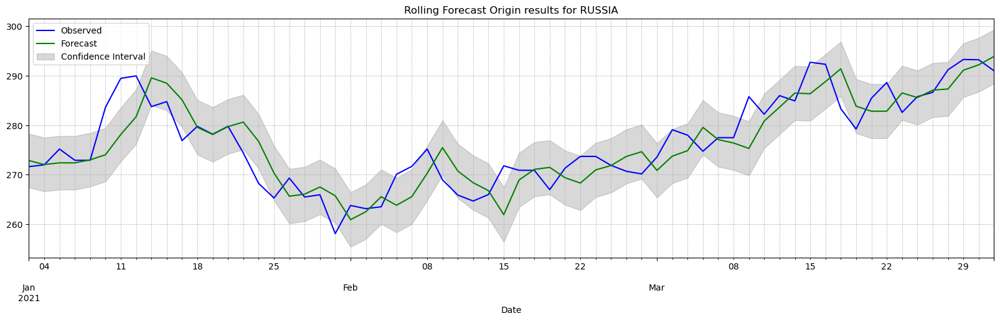

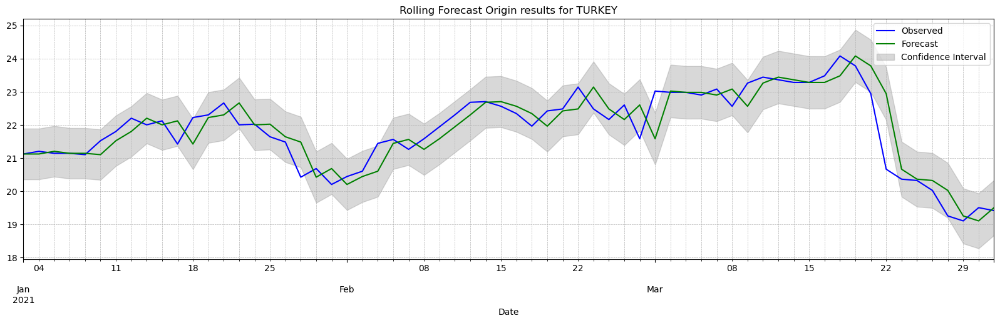

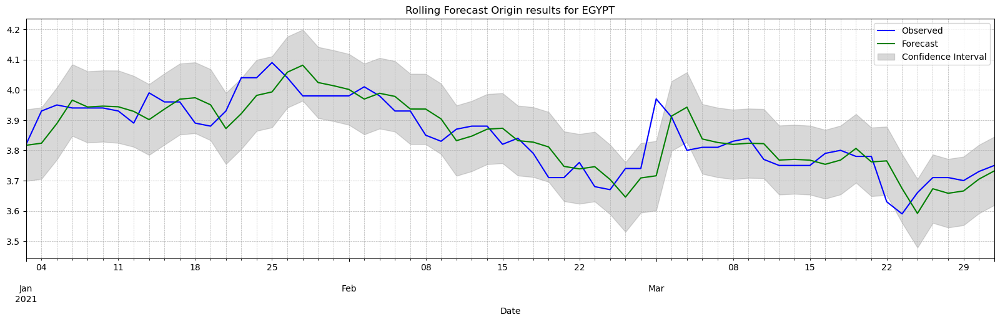

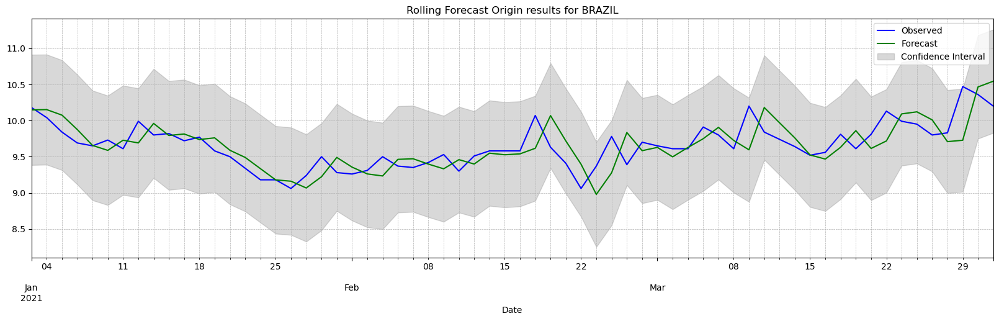

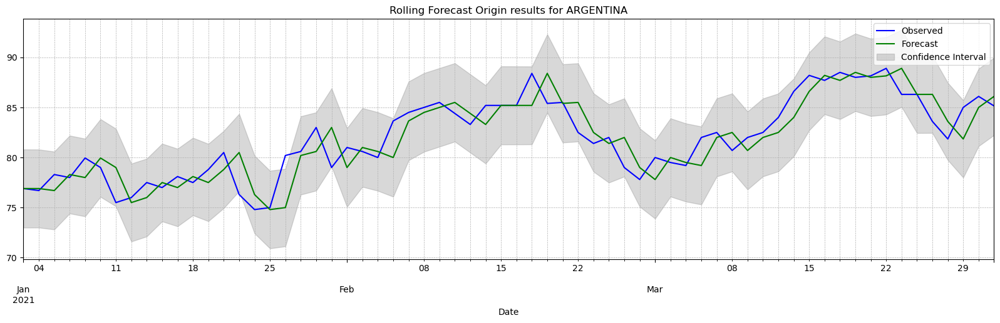

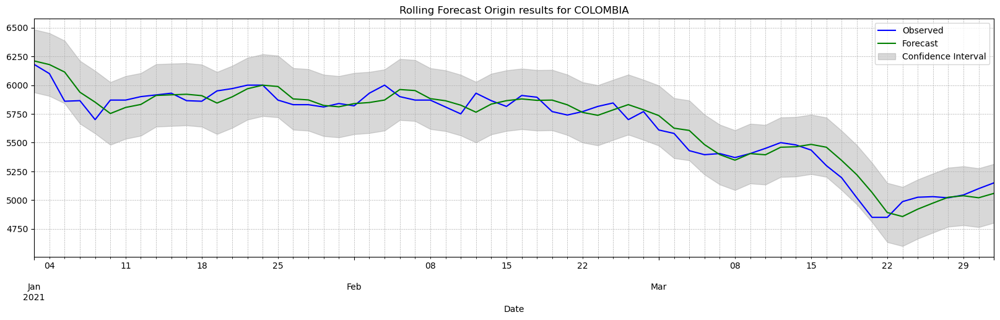

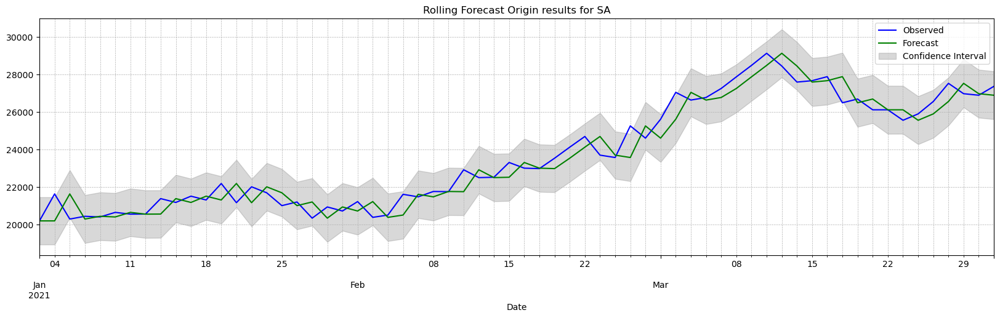

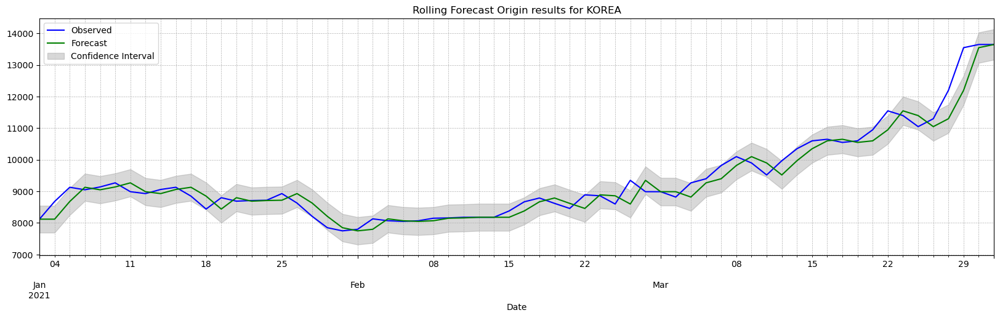

In [52]:
plot = True
rfo_results = {}

for key in data.keys():
    # Initialize an empty DataFrame to store forecast results
    results = pd.DataFrame(columns=["Date", "Actual", "Forecast", "Conf Int low", "Conf Int high"])
    # Perform rolling forecasts
    for predicted_date in pd.date_range(start="2021-01-01", end="2021-03-31", freq="B"):
        # Get the optimal order computed by auto ARIMA
        order = models_auto_arima[key].order
        # Split the data according to the new prediciton date
        curr_train_set = data[key]["Price"][:predicted_date-timedelta(days=1)]
        curr_test_set = data[key]["Price"][predicted_date:predicted_date]
        # If the best Exo variable is Price, then we do not use an exo variable
        if best_exo[key] == "Price":
            # Create the model and fit it
            model = sm.tsa.SARIMAX(curr_train_set, order=order)
            sarimax = model.fit()
            # Make predictions
            forecast_results = sarimax.get_forecast(steps=1)
        else:
            curr_train_exo = data[key][best_exo[key]][:predicted_date-timedelta(days=1)]
            curr_test_exo = curr_train_exo[-1]
            # Create the model and fit it
            model = sm.tsa.SARIMAX(curr_train_set, order=order, exog=curr_train_exo)
            sarimax = model.fit()
            # Make predictions
            forecast_results = sarimax.get_forecast(steps=1, exog=curr_test_exo)
        forecast = forecast_results.predicted_mean
        conf_int = forecast_results.conf_int()
        # Concat the results to the dataframe
        curr_results = pd.DataFrame({"Date":predicted_date, "Actual":curr_test_set, "Forecast":forecast,
                                     "Conf Int low":conf_int["lower Price"], "Conf Int high":conf_int["upper Price"]})
        results = pd.concat((results, curr_results), ignore_index=True)
    # Once we have done the forecast of the full period, we save the results
    results.set_index("Date", inplace=True)
    rfo_results[key] = results
    # And we plot them if required
    if plot:
        results["Actual"].plot(label="Observed", color="blue", figsize=(20,5), grid="on")
        results["Forecast"].plot(label="Forecast", color="green", figsize=(20,5), grid="on")
        plt.fill_between(results.index, results["Conf Int low"], results["Conf Int high"], color="gray", alpha=0.3,
                         label="Confidence Interval")
        plt.grid(True, which="both", linestyle="--", linewidth=0.5)
        plt.legend()
        plt.title(f"Rolling Forecast Origin results for {key.upper()}")
        plt.show()

In [53]:
display_for_all_keys(rfo_results)

RUSSIA:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,271.65,272.870382,267.425946,278.314818
2021-01-04,272.00,272.074975,266.638910,277.511040
2021-01-05,275.20,272.409133,266.983089,277.835176
2021-01-06,272.93,272.410079,266.981614,277.838545
2021-01-07,272.93,273.019983,267.601315,278.438651


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,286.66,287.102765,281.636299,292.569231
2021-03-26,291.22,287.336977,281.875140,292.798815
2021-03-29,293.30,291.127333,285.673817,296.580849
2021-03-30,293.25,292.217299,286.770579,297.664019
2021-03-31,291.02,293.909365,288.469920,299.348810



 <<< -------------------------------------------------- >>> 

TURKEY:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,21.12,21.12,20.351797,21.888203
2021-01-04,21.20,21.12,20.353270,21.886730
2021-01-05,21.14,21.20,20.434673,21.965327
2021-01-06,21.14,21.14,20.376095,21.903905
2021-01-07,21.10,21.14,20.377543,21.902457


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,20.02,20.32,19.490369,21.149631
2021-03-26,19.25,20.02,19.191014,20.848986
2021-03-29,19.10,19.25,18.418031,20.081969
2021-03-30,19.50,19.10,18.269163,19.930837
2021-03-31,19.41,19.50,18.669304,20.330696



 <<< -------------------------------------------------- >>> 

EGYPT:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,3.82,3.816753,3.698492,3.935014
2021-01-04,3.93,3.823625,3.705593,3.941658
2021-01-05,3.95,3.888522,3.769288,4.007756
2021-01-06,3.94,3.966015,3.847779,4.084251
2021-01-07,3.94,3.943267,3.825480,4.061055


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,3.71,3.673053,3.559955,3.786151
2021-03-26,3.71,3.658076,3.544740,3.771412
2021-03-29,3.70,3.665715,3.552372,3.779059
2021-03-30,3.73,3.704717,3.591530,3.817905
2021-03-31,3.75,3.731950,3.618933,3.844968



 <<< -------------------------------------------------- >>> 

BRAZIL:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,10.18,10.147301,9.384132,10.910469
2021-01-04,10.04,10.150965,9.389245,10.912685
2021-01-05,9.84,10.074623,9.314236,10.835010
2021-01-06,9.69,9.875876,9.116345,10.635407
2021-01-07,9.65,9.655535,8.897111,10.413959


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,9.80,10.009116,9.295394,10.722839
2021-03-26,9.83,9.708222,8.995271,10.421173
2021-03-29,10.47,9.727282,9.015292,10.439272
2021-03-30,10.36,10.464412,9.748930,11.179894
2021-03-31,10.20,10.543781,9.829290,11.258272



 <<< -------------------------------------------------- >>> 

ARGENTINA:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,76.90,76.9,72.996536,80.803464
2021-01-04,76.70,76.9,73.004021,80.795979
2021-01-05,78.30,76.7,72.811388,80.588612
2021-01-06,78.00,78.3,74.413974,82.186026
2021-01-07,79.95,78.0,74.121172,81.878828


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,83.60,86.30,82.447351,90.152649
2021-03-26,81.85,83.60,79.742017,87.457983
2021-03-29,85.00,81.85,77.993276,85.706724
2021-03-30,86.10,85.00,81.133930,88.866070
2021-03-31,85.15,86.10,82.238056,89.961944



 <<< -------------------------------------------------- >>> 

COLOMBIA:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,6180.0,6210.295161,5936.458656,6484.131666
2021-01-04,6100.0,6178.894583,5905.548258,6452.240907
2021-01-05,5860.0,6113.841861,5841.058946,6386.624775
2021-01-06,5865.0,5938.525281,5665.416495,6211.634067
2021-01-07,5700.0,5851.921470,5579.338639,6124.504300


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,5030.0,4974.250866,4717.123916,5231.377816
2021-03-26,5020.0,5025.120925,4768.374329,5281.867522
2021-03-29,5045.0,5037.805934,4781.432673,5294.179195
2021-03-30,5100.0,5020.471024,4764.446646,5276.495403
2021-03-31,5150.0,5058.575920,4802.778417,5314.373423



 <<< -------------------------------------------------- >>> 

SA:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,20190.0,20190.0,18925.550632,21454.449368
2021-01-04,21629.0,20190.0,18927.966010,21452.033990
2021-01-05,20288.0,21629.0,20357.418555,22900.581445
2021-01-06,20436.0,20288.0,19008.562065,21567.437935
2021-01-07,20400.0,20436.0,19158.854065,21713.145935


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,26564.0,25903.0,24624.053209,27181.946791
2021-03-26,27533.0,26564.0,25285.001194,27842.998806
2021-03-29,26980.0,27533.0,26251.610323,28814.389677
2021-03-30,26898.0,26980.0,25699.174859,28260.825141
2021-03-31,27373.0,26898.0,25619.121799,28176.878201



 <<< -------------------------------------------------- >>> 

KOREA:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,8120.0,8120.0,7693.665804,8546.334196
2021-01-04,8680.0,8120.0,7694.483317,8545.516683
2021-01-05,9130.0,8680.0,8249.917007,9110.082993
2021-01-06,9050.0,9130.0,8697.303981,9562.696019
2021-01-07,9140.0,9050.0,8618.016454,9481.983546


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,11300.0,11050.0,10600.309548,11499.690452
2021-03-26,12200.0,11300.0,10850.177978,11749.822022
2021-03-29,13550.0,12200.0,11740.214279,12659.785721
2021-03-30,13650.0,13550.0,13067.829088,14032.170912
2021-03-31,13650.0,13650.0,13168.452552,14131.547448



 <<< -------------------------------------------------- >>> 



In [54]:
with open("../data/results_rfo_last.pkl", "wb") as handle:
    pickle.dump(rfo_results, handle)

#### Performance analysis

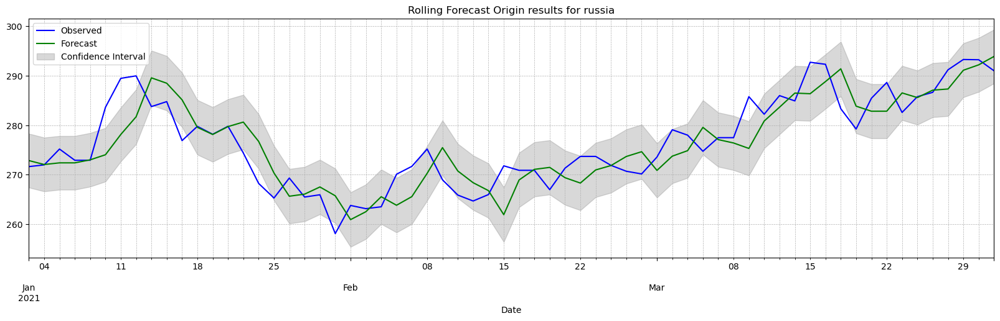

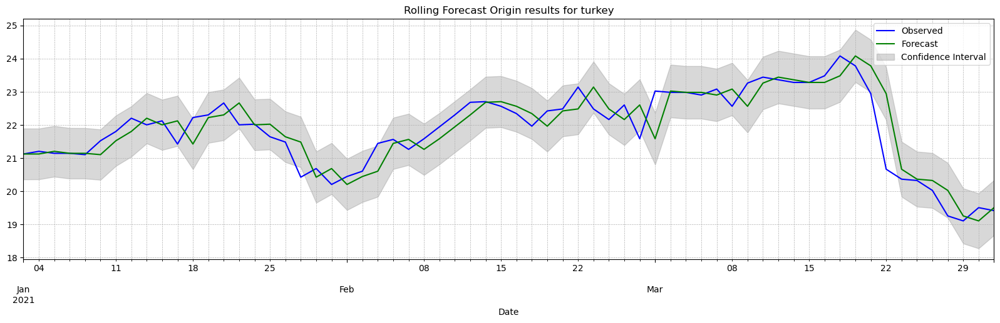

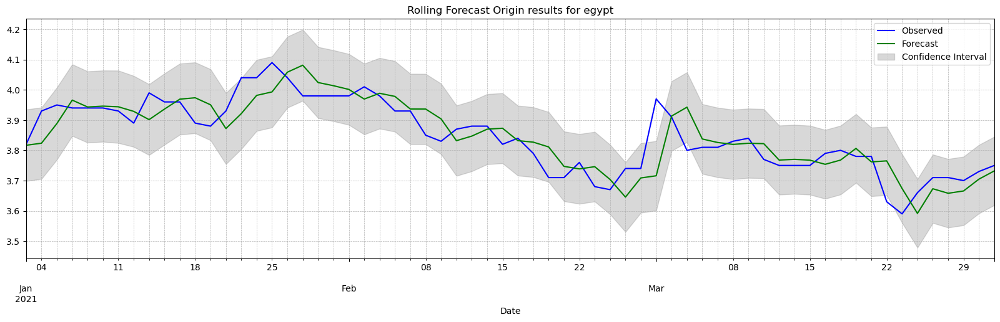

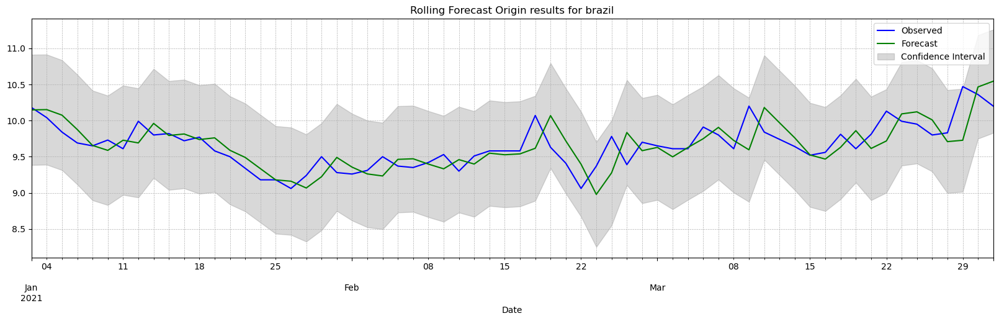

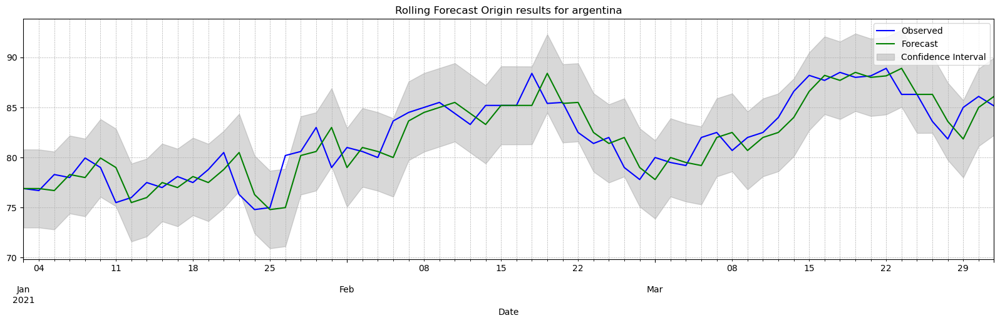

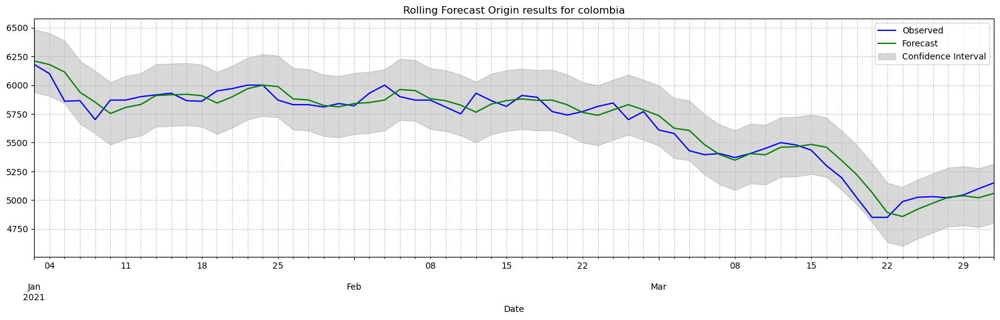

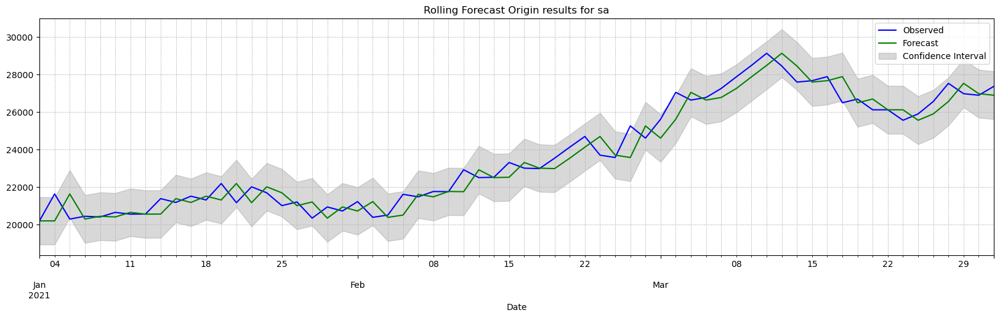

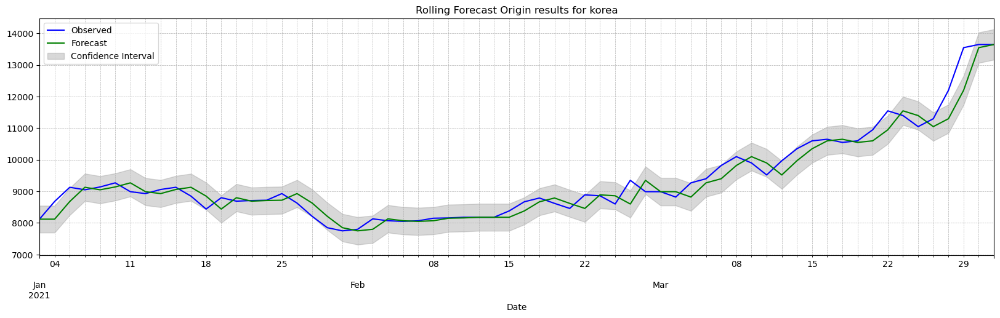

In [55]:
for key in data.keys():
    results = rfo_results[key]
    results["Actual"].plot(label="Observed", color="blue", figsize=(20,5), grid="on")
    results["Forecast"].plot(label="Forecast", color="green", figsize=(20,5), grid="on")
    plt.fill_between(results.index, results["Conf Int low"], results["Conf Int high"], color="gray", alpha=0.3,
                     label="Confidence Interval")
    plt.grid(True, which="both", linestyle="--", linewidth=0.5)
    plt.legend()
    plt.title(f"Rolling Forecast Origin results for {key}")
    plt.show()

**NOTE:**
- Compute the residuals and the error measures.

In [56]:
for key in data.keys():
    tmp = rfo_results[key]
    residuals = tmp["Actual"] - tmp["Forecast"]
    # Compute and store the performance metrics
    mape = round(np.mean(abs(residuals/tmp["Actual"])), 4)
    rmse = round(np.sqrt(np.mean(residuals**2)), 4)
    print_bold_underline(f"Rolling Forecast Origin performance metrics for {key.upper()}")
    print(f"Mean Absolute Percent Error: {round(mape*100, 3)}%")
    print(f"Root Mean Square Error:    {round(rmse, 3)}")
    barrier()

Rolling Forecast Origin performance metrics for RUSSIA
Mean Absolute Percent Error: 1.33%
Root Mean Square Error:    4.719

 <<< -------------------------------------------------- >>> 

Rolling Forecast Origin performance metrics for TURKEY
Mean Absolute Percent Error: 1.7%
Root Mean Square Error:    0.532

 <<< -------------------------------------------------- >>> 

Rolling Forecast Origin performance metrics for EGYPT
Mean Absolute Percent Error: 1.24%
Root Mean Square Error:    0.064

 <<< -------------------------------------------------- >>> 

Rolling Forecast Origin performance metrics for BRAZIL
Mean Absolute Percent Error: 1.89%
Root Mean Square Error:    0.238

 <<< -------------------------------------------------- >>> 

Rolling Forecast Origin performance metrics for ARGENTINA
Mean Absolute Percent Error: 1.76%
Root Mean Square Error:    1.87

 <<< -------------------------------------------------- >>> 

Rolling Forecast Origin performance metrics for COLOMBIA
Mean Absolute

**NOTE:**
- In general, using the **last value** increases the performance.
- The exceptions are:
    - South Africa performs at the same level
    - Turkey, the MAPE increased by 0.02%
    - Egypt, the MAPE passed from 1.08% to 1.25%
- Hence, for Turkey and Egypt we will stick to the moving average latest value, while for the other countries we will use the last available value.

In [57]:
with open("../data/results_rfo_ma.pkl", "rb") as handle:
    ma_results = pickle.load(handle)

In [58]:
display_for_all_keys(ma_results)

RUSSIA:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,271.65,273.889034,269.081132,278.696936
2021-01-04,272.00,274.169082,269.369837,278.968326
2021-01-05,275.20,507.562543,NaN,NaN
2021-01-06,272.93,274.451287,269.654412,279.248162
2021-01-07,272.93,273.470627,268.681762,278.259492


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,286.66,281.572298,276.608462,286.536134
2021-03-26,291.22,282.190178,277.223972,287.156384
2021-03-29,293.30,283.132963,278.170677,288.095248
2021-03-30,293.25,285.009932,280.047106,289.972759
2021-03-31,291.02,285.937537,280.982418,290.892655



 <<< -------------------------------------------------- >>> 

TURKEY:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,21.12,21.131333,8.764556,33.498110
2021-01-04,21.20,21.131460,8.764683,33.498237
2021-01-05,21.14,21.196451,8.829007,33.563895
2021-01-06,21.14,21.115874,8.747395,33.484354
2021-01-07,21.10,21.129954,8.761442,33.498465


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,20.02,20.282383,5.505113,35.059652
2021-03-26,19.25,20.007809,5.220718,34.794900
2021-03-29,19.10,19.212467,4.342593,34.082342
2021-03-30,19.50,19.088600,4.216712,33.960488
2021-03-31,19.41,19.467366,4.577237,34.357495



 <<< -------------------------------------------------- >>> 

EGYPT:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,3.82,3.833321,3.665416,4.001226
2021-01-04,3.93,3.827565,3.659992,3.995139
2021-01-05,3.95,3.885462,3.718112,4.052812
2021-01-06,3.94,3.961233,3.794040,4.128427
2021-01-07,3.94,3.937795,3.770889,4.104702


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,3.71,3.673023,3.515001,3.831045
2021-03-26,3.71,3.729126,3.571302,3.886950
2021-03-29,3.70,3.721001,3.563423,3.878580
2021-03-30,3.73,3.707282,3.549955,3.864610
2021-03-31,3.75,3.728166,3.571070,3.885261



 <<< -------------------------------------------------- >>> 

BRAZIL:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,10.18,10.119827,9.425489,10.814165
2021-01-04,10.04,10.059381,9.366296,10.752465
2021-01-05,9.84,10.061457,9.369693,10.753221
2021-01-06,9.69,10.039223,9.348675,10.729771
2021-01-07,9.65,9.989758,9.300457,10.679058


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,9.80,9.910363,9.261154,10.559572
2021-03-26,9.83,9.777710,9.128823,10.426598
2021-03-29,10.47,9.744856,9.096968,10.392744
2021-03-30,10.36,9.894252,9.243159,10.545344
2021-03-31,10.20,10.081676,9.431578,10.731775



 <<< -------------------------------------------------- >>> 

ARGENTINA:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,76.90,78.446448,75.411722,81.481173
2021-01-04,76.70,78.229371,75.200464,81.258277
2021-01-05,78.30,78.356805,75.333345,81.380265
2021-01-06,78.00,79.167306,76.147054,82.187559
2021-01-07,79.95,78.773932,75.759188,81.788676


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,83.60,83.871208,80.791202,86.951213
2021-03-26,81.85,82.434217,79.354371,85.514064
2021-03-29,85.00,82.652419,79.577334,85.727505
2021-03-30,86.10,85.000000,81.920587,88.079413
2021-03-31,85.15,85.714257,82.638983,88.789531



 <<< -------------------------------------------------- >>> 

COLOMBIA:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,6180.0,5879.473904,5605.637398,6153.310409
2021-01-04,6100.0,5882.611551,5609.265227,6155.957876
2021-01-05,5860.0,5890.348774,5617.565860,6163.131688
2021-01-06,5865.0,5809.046720,5535.937935,6082.155506
2021-01-07,5700.0,5824.082961,5551.500131,6096.665791


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,5030.0,5221.947430,4964.820480,5479.074380
2021-03-26,5020.0,5224.727153,4967.980556,5481.473749
2021-03-29,5045.0,5186.152242,4929.778981,5442.525502
2021-03-30,5100.0,5191.008454,4934.984075,5447.032832
2021-03-31,5150.0,5216.579814,4960.782311,5472.377317



 <<< -------------------------------------------------- >>> 

SA:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,20190.0,20242.758275,-125.174217,40610.690767
2021-01-04,21629.0,20237.638975,-130.293517,40605.571467
2021-01-05,20288.0,21649.188314,1092.404015,42205.972612
2021-01-06,20436.0,20270.768176,-462.572688,41004.109040
2021-01-07,20400.0,20425.696819,-309.899884,41161.293522


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,26564.0,25922.567059,3093.634051,48751.500066
2021-03-26,27533.0,26597.467084,3729.868028,49465.066139
2021-03-29,26980.0,27550.687616,4606.106365,50495.268867
2021-03-30,26898.0,26976.769770,4004.523495,49949.016045
2021-03-31,27373.0,26922.697340,3950.213601,49895.181079



 <<< -------------------------------------------------- >>> 

KOREA:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,8120.0,8120.733159,7697.330225,8544.136093
2021-01-04,8680.0,8121.184240,7698.573817,8543.794662
2021-01-05,9130.0,8650.874061,8224.248286,9077.499836
2021-01-06,9050.0,9024.460034,8596.255412,9452.664656
2021-01-07,9140.0,8895.298546,8467.536810,9323.060281


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,11300.0,10872.506729,10428.498310,11316.515149
2021-03-26,12200.0,11179.174756,10734.752289,11623.597222
2021-03-29,13550.0,11986.746725,11534.196984,12439.296466
2021-03-30,13650.0,13075.283437,12606.274131,13544.292742
2021-03-31,13650.0,12962.290680,12493.477108,13431.104253



 <<< -------------------------------------------------- >>> 



In [59]:
with open("../data/results_rfo_last.pkl", "rb") as handle:
    last_results = pickle.load(handle)

In [60]:
display_for_all_keys(last_results)

RUSSIA:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,271.65,272.870382,267.425946,278.314818
2021-01-04,272.00,272.074975,266.638910,277.511040
2021-01-05,275.20,272.409133,266.983089,277.835176
2021-01-06,272.93,272.410079,266.981614,277.838545
2021-01-07,272.93,273.019983,267.601315,278.438651


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,286.66,287.102765,281.636299,292.569231
2021-03-26,291.22,287.336977,281.875140,292.798815
2021-03-29,293.30,291.127333,285.673817,296.580849
2021-03-30,293.25,292.217299,286.770579,297.664019
2021-03-31,291.02,293.909365,288.469920,299.348810



 <<< -------------------------------------------------- >>> 

TURKEY:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,21.12,21.12,20.351797,21.888203
2021-01-04,21.20,21.12,20.353270,21.886730
2021-01-05,21.14,21.20,20.434673,21.965327
2021-01-06,21.14,21.14,20.376095,21.903905
2021-01-07,21.10,21.14,20.377543,21.902457


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,20.02,20.32,19.490369,21.149631
2021-03-26,19.25,20.02,19.191014,20.848986
2021-03-29,19.10,19.25,18.418031,20.081969
2021-03-30,19.50,19.10,18.269163,19.930837
2021-03-31,19.41,19.50,18.669304,20.330696



 <<< -------------------------------------------------- >>> 

EGYPT:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,3.82,3.816753,3.698492,3.935014
2021-01-04,3.93,3.823625,3.705593,3.941658
2021-01-05,3.95,3.888522,3.769288,4.007756
2021-01-06,3.94,3.966015,3.847779,4.084251
2021-01-07,3.94,3.943267,3.825480,4.061055


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,3.71,3.673053,3.559955,3.786151
2021-03-26,3.71,3.658076,3.544740,3.771412
2021-03-29,3.70,3.665715,3.552372,3.779059
2021-03-30,3.73,3.704717,3.591530,3.817905
2021-03-31,3.75,3.731950,3.618933,3.844968



 <<< -------------------------------------------------- >>> 

BRAZIL:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,10.18,10.147301,9.384132,10.910469
2021-01-04,10.04,10.150965,9.389245,10.912685
2021-01-05,9.84,10.074623,9.314236,10.835010
2021-01-06,9.69,9.875876,9.116345,10.635407
2021-01-07,9.65,9.655535,8.897111,10.413959


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,9.80,10.009116,9.295394,10.722839
2021-03-26,9.83,9.708222,8.995271,10.421173
2021-03-29,10.47,9.727282,9.015292,10.439272
2021-03-30,10.36,10.464412,9.748930,11.179894
2021-03-31,10.20,10.543781,9.829290,11.258272



 <<< -------------------------------------------------- >>> 

ARGENTINA:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,76.90,76.9,72.996536,80.803464
2021-01-04,76.70,76.9,73.004021,80.795979
2021-01-05,78.30,76.7,72.811388,80.588612
2021-01-06,78.00,78.3,74.413974,82.186026
2021-01-07,79.95,78.0,74.121172,81.878828


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,83.60,86.30,82.447351,90.152649
2021-03-26,81.85,83.60,79.742017,87.457983
2021-03-29,85.00,81.85,77.993276,85.706724
2021-03-30,86.10,85.00,81.133930,88.866070
2021-03-31,85.15,86.10,82.238056,89.961944



 <<< -------------------------------------------------- >>> 

COLOMBIA:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,6180.0,6210.295161,5936.458656,6484.131666
2021-01-04,6100.0,6178.894583,5905.548258,6452.240907
2021-01-05,5860.0,6113.841861,5841.058946,6386.624775
2021-01-06,5865.0,5938.525281,5665.416495,6211.634067
2021-01-07,5700.0,5851.921470,5579.338639,6124.504300


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,5030.0,4974.250866,4717.123916,5231.377816
2021-03-26,5020.0,5025.120925,4768.374329,5281.867522
2021-03-29,5045.0,5037.805934,4781.432673,5294.179195
2021-03-30,5100.0,5020.471024,4764.446646,5276.495403
2021-03-31,5150.0,5058.575920,4802.778417,5314.373423



 <<< -------------------------------------------------- >>> 

SA:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,20190.0,20190.0,18925.550632,21454.449368
2021-01-04,21629.0,20190.0,18927.966010,21452.033990
2021-01-05,20288.0,21629.0,20357.418555,22900.581445
2021-01-06,20436.0,20288.0,19008.562065,21567.437935
2021-01-07,20400.0,20436.0,19158.854065,21713.145935


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,26564.0,25903.0,24624.053209,27181.946791
2021-03-26,27533.0,26564.0,25285.001194,27842.998806
2021-03-29,26980.0,27533.0,26251.610323,28814.389677
2021-03-30,26898.0,26980.0,25699.174859,28260.825141
2021-03-31,27373.0,26898.0,25619.121799,28176.878201



 <<< -------------------------------------------------- >>> 

KOREA:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,8120.0,8120.0,7693.665804,8546.334196
2021-01-04,8680.0,8120.0,7694.483317,8545.516683
2021-01-05,9130.0,8680.0,8249.917007,9110.082993
2021-01-06,9050.0,9130.0,8697.303981,9562.696019
2021-01-07,9140.0,9050.0,8618.016454,9481.983546


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,11300.0,11050.0,10600.309548,11499.690452
2021-03-26,12200.0,11300.0,10850.177978,11749.822022
2021-03-29,13550.0,12200.0,11740.214279,12659.785721
2021-03-30,13650.0,13550.0,13067.829088,14032.170912
2021-03-31,13650.0,13650.0,13168.452552,14131.547448



 <<< -------------------------------------------------- >>> 



In [61]:
final_results = last_results.copy()
final_results["turkey"] = ma_results["turkey"]
final_results["egypt"] = ma_results["egypt"]
display_for_all_keys(final_results)

RUSSIA:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,271.65,272.870382,267.425946,278.314818
2021-01-04,272.00,272.074975,266.638910,277.511040
2021-01-05,275.20,272.409133,266.983089,277.835176
2021-01-06,272.93,272.410079,266.981614,277.838545
2021-01-07,272.93,273.019983,267.601315,278.438651


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,286.66,287.102765,281.636299,292.569231
2021-03-26,291.22,287.336977,281.875140,292.798815
2021-03-29,293.30,291.127333,285.673817,296.580849
2021-03-30,293.25,292.217299,286.770579,297.664019
2021-03-31,291.02,293.909365,288.469920,299.348810



 <<< -------------------------------------------------- >>> 

TURKEY:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,21.12,21.131333,8.764556,33.498110
2021-01-04,21.20,21.131460,8.764683,33.498237
2021-01-05,21.14,21.196451,8.829007,33.563895
2021-01-06,21.14,21.115874,8.747395,33.484354
2021-01-07,21.10,21.129954,8.761442,33.498465


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,20.02,20.282383,5.505113,35.059652
2021-03-26,19.25,20.007809,5.220718,34.794900
2021-03-29,19.10,19.212467,4.342593,34.082342
2021-03-30,19.50,19.088600,4.216712,33.960488
2021-03-31,19.41,19.467366,4.577237,34.357495



 <<< -------------------------------------------------- >>> 

EGYPT:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,3.82,3.833321,3.665416,4.001226
2021-01-04,3.93,3.827565,3.659992,3.995139
2021-01-05,3.95,3.885462,3.718112,4.052812
2021-01-06,3.94,3.961233,3.794040,4.128427
2021-01-07,3.94,3.937795,3.770889,4.104702


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,3.71,3.673023,3.515001,3.831045
2021-03-26,3.71,3.729126,3.571302,3.886950
2021-03-29,3.70,3.721001,3.563423,3.878580
2021-03-30,3.73,3.707282,3.549955,3.864610
2021-03-31,3.75,3.728166,3.571070,3.885261



 <<< -------------------------------------------------- >>> 

BRAZIL:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,10.18,10.147301,9.384132,10.910469
2021-01-04,10.04,10.150965,9.389245,10.912685
2021-01-05,9.84,10.074623,9.314236,10.835010
2021-01-06,9.69,9.875876,9.116345,10.635407
2021-01-07,9.65,9.655535,8.897111,10.413959


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,9.80,10.009116,9.295394,10.722839
2021-03-26,9.83,9.708222,8.995271,10.421173
2021-03-29,10.47,9.727282,9.015292,10.439272
2021-03-30,10.36,10.464412,9.748930,11.179894
2021-03-31,10.20,10.543781,9.829290,11.258272



 <<< -------------------------------------------------- >>> 

ARGENTINA:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,76.90,76.9,72.996536,80.803464
2021-01-04,76.70,76.9,73.004021,80.795979
2021-01-05,78.30,76.7,72.811388,80.588612
2021-01-06,78.00,78.3,74.413974,82.186026
2021-01-07,79.95,78.0,74.121172,81.878828


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,83.60,86.30,82.447351,90.152649
2021-03-26,81.85,83.60,79.742017,87.457983
2021-03-29,85.00,81.85,77.993276,85.706724
2021-03-30,86.10,85.00,81.133930,88.866070
2021-03-31,85.15,86.10,82.238056,89.961944



 <<< -------------------------------------------------- >>> 

COLOMBIA:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,6180.0,6210.295161,5936.458656,6484.131666
2021-01-04,6100.0,6178.894583,5905.548258,6452.240907
2021-01-05,5860.0,6113.841861,5841.058946,6386.624775
2021-01-06,5865.0,5938.525281,5665.416495,6211.634067
2021-01-07,5700.0,5851.921470,5579.338639,6124.504300


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,5030.0,4974.250866,4717.123916,5231.377816
2021-03-26,5020.0,5025.120925,4768.374329,5281.867522
2021-03-29,5045.0,5037.805934,4781.432673,5294.179195
2021-03-30,5100.0,5020.471024,4764.446646,5276.495403
2021-03-31,5150.0,5058.575920,4802.778417,5314.373423



 <<< -------------------------------------------------- >>> 

SA:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,20190.0,20190.0,18925.550632,21454.449368
2021-01-04,21629.0,20190.0,18927.966010,21452.033990
2021-01-05,20288.0,21629.0,20357.418555,22900.581445
2021-01-06,20436.0,20288.0,19008.562065,21567.437935
2021-01-07,20400.0,20436.0,19158.854065,21713.145935


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,26564.0,25903.0,24624.053209,27181.946791
2021-03-26,27533.0,26564.0,25285.001194,27842.998806
2021-03-29,26980.0,27533.0,26251.610323,28814.389677
2021-03-30,26898.0,26980.0,25699.174859,28260.825141
2021-03-31,27373.0,26898.0,25619.121799,28176.878201



 <<< -------------------------------------------------- >>> 

KOREA:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,8120.0,8120.0,7693.665804,8546.334196
2021-01-04,8680.0,8120.0,7694.483317,8545.516683
2021-01-05,9130.0,8680.0,8249.917007,9110.082993
2021-01-06,9050.0,9130.0,8697.303981,9562.696019
2021-01-07,9140.0,9050.0,8618.016454,9481.983546


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,11300.0,11050.0,10600.309548,11499.690452
2021-03-26,12200.0,11300.0,10850.177978,11749.822022
2021-03-29,13550.0,12200.0,11740.214279,12659.785721
2021-03-30,13650.0,13550.0,13067.829088,14032.170912
2021-03-31,13650.0,13650.0,13168.452552,14131.547448



 <<< -------------------------------------------------- >>> 



In [62]:
with open("../data/results_rfo_final.pkl", "wb") as handle:
    pickle.dump(final_results, handle)

## Investment strategy

### Bollinger Bands

In [63]:
display_for_all_keys(data)

RUSSIA:


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2020-01-03,255.00,255.99,258.19,253.70,35850000.0,0.0010
2020-01-06,253.90,254.75,254.84,251.40,22350000.0,-0.0043
2020-01-07,253.90,254.75,254.84,251.40,22350000.0,-0.0043
2020-01-08,259.15,253.57,259.15,253.03,40820000.0,0.0207
2020-01-09,257.99,259.40,261.76,257.01,38330000.0,-0.0045


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2021-03-25,286.66,286.50,287.03,283.85,35220000.0,0.0030
2021-03-26,291.22,288.63,292.75,288.32,56070000.0,0.0159
2021-03-29,293.30,289.72,294.09,289.26,43680000.0,0.0071
2021-03-30,293.25,294.86,295.72,291.50,38810000.0,-0.0002
2021-03-31,291.02,294.00,294.42,290.26,47000000.0,-0.0076



 <<< -------------------------------------------------- >>> 

TURKEY:


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2020-01-02,20.38,20.42,20.44,20.24,2530000.0,0.0030
2020-01-03,20.30,20.30,20.44,19.97,3310000.0,-0.0039
2020-01-06,20.08,20.34,20.34,19.97,1940000.0,-0.0108
2020-01-07,19.93,20.22,20.28,19.92,2890000.0,-0.0075
2020-01-08,19.94,19.89,19.95,19.66,2790000.0,0.0005


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2021-03-25,20.02,20.50,20.86,20.02,15930000.0,-0.0148
2021-03-26,19.25,20.28,20.36,19.10,21350000.0,-0.0385
2021-03-29,19.10,19.24,19.67,19.10,16560000.0,-0.0078
2021-03-30,19.50,19.12,19.81,19.03,21050000.0,0.0209
2021-03-31,19.41,19.42,19.63,19.27,13140000.0,-0.0046



 <<< -------------------------------------------------- >>> 

EGYPT:


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2020-01-02,4.81,4.81,4.87,4.78,241600.0,-0.0021
2020-01-03,4.81,4.81,4.87,4.78,241600.0,-0.0021
2020-01-06,4.28,4.16,4.44,4.12,2520000.0,-0.0295
2020-01-07,4.28,4.16,4.44,4.12,2520000.0,-0.0295
2020-01-08,4.41,4.19,4.59,4.15,3520000.0,0.0304


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2021-03-25,3.71,3.62,3.78,3.59,2500000.0,0.0137
2021-03-26,3.71,3.62,3.78,3.59,2500000.0,0.0137
2021-03-29,3.70,3.69,3.73,3.68,1250000.0,-0.0027
2021-03-30,3.73,3.71,3.76,3.67,3430000.0,0.0081
2021-03-31,3.75,3.74,3.82,3.71,1570000.0,0.0054



 <<< -------------------------------------------------- >>> 

BRAZIL:


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2020-01-02,12.57,12.88,12.99,12.57,5780000.0,-0.0210
2020-01-03,12.90,12.45,12.93,12.27,4880000.0,0.0263
2020-01-06,12.89,12.90,12.91,12.57,4170000.0,-0.0008
2020-01-07,13.48,13.03,13.48,13.03,8200000.0,0.0458
2020-01-08,13.63,13.50,13.68,13.18,6180000.0,0.0111


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2021-03-25,9.80,10.01,10.01,9.66,8880000.0,-0.0151
2021-03-26,9.83,9.80,9.94,9.70,5110000.0,0.0031
2021-03-29,10.47,9.85,10.50,9.81,22040000.0,0.0651
2021-03-30,10.36,10.41,10.62,10.30,9930000.0,-0.0105
2021-03-31,10.20,10.35,10.40,10.12,7770000.0,-0.0154



 <<< -------------------------------------------------- >>> 

ARGENTINA:


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2020-01-02,48.25,49.35,50.20,47.55,878500.0,-0.0292
2020-01-03,48.80,48.25,49.45,46.50,595360.0,0.0114
2020-01-06,48.50,48.40,48.70,47.00,719240.0,-0.0061
2020-01-07,47.60,48.35,49.00,46.90,901950.0,-0.0186
2020-01-08,46.50,47.50,47.50,46.00,1180000.0,-0.0231


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2021-03-25,83.60,85.20,87.30,82.10,389780.0,-0.0313
2021-03-26,81.85,84.00,84.60,80.70,462550.0,-0.0209
2021-03-29,85.00,80.00,86.00,79.00,371220.0,0.0385
2021-03-30,86.10,85.15,86.75,84.60,141400.0,0.0129
2021-03-31,85.15,86.50,88.10,85.15,564300.0,-0.0110



 <<< -------------------------------------------------- >>> 

COLOMBIA:


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2020-01-02,7120.0,7300.0,7300.0,7120.0,138960.0,-0.0247
2020-01-03,7000.0,7040.0,7100.0,6960.0,470770.0,-0.0169
2020-01-06,7000.0,7040.0,7100.0,6960.0,470770.0,-0.0169
2020-01-07,6950.0,6950.0,6950.0,6850.0,168710.0,-0.0071
2020-01-08,6880.0,6940.0,6950.0,6880.0,84930.0,-0.0101


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2021-03-25,5030.0,5035.0,5045.0,4950.0,317060.0,0.0010
2021-03-26,5020.0,5085.0,5085.0,4980.0,203460.0,-0.0020
2021-03-29,5045.0,5020.0,5045.0,5015.0,117540.0,0.0050
2021-03-30,5100.0,5010.0,5100.0,5010.0,583700.0,0.0109
2021-03-31,5150.0,5100.0,5170.0,5100.0,212440.0,0.0098



 <<< -------------------------------------------------- >>> 

SA:


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2020-01-02,14330.0,14525.0,14764.0,14325.0,2010000.0,-0.0015
2020-01-03,14843.0,14700.0,14884.0,14360.0,3190000.0,0.0358
2020-01-06,14620.0,14985.0,15045.0,14574.0,2610000.0,-0.0150
2020-01-07,14500.0,14688.0,14688.0,13940.0,3940000.0,-0.0082
2020-01-08,15290.0,14775.0,15465.0,14468.0,6240000.0,0.0545


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2021-03-25,26564.0,25954.0,27128.0,25954.0,2830000.0,0.0255
2021-03-26,27533.0,27083.0,28006.0,26728.0,3360000.0,0.0365
2021-03-29,26980.0,27800.0,28174.0,26614.0,4440000.0,-0.0201
2021-03-30,26898.0,26766.0,27443.0,26360.0,3020000.0,-0.0030
2021-03-31,27373.0,26980.0,27526.0,26657.0,2490000.0,0.0177



 <<< -------------------------------------------------- >>> 

KOREA:


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2020-01-02,5850.0,5930.0,5980.0,5820.0,239900.0,-0.0168
2020-01-03,5900.0,5870.0,5920.0,5830.0,230400.0,0.0085
2020-01-06,5730.0,5890.0,5890.0,5680.0,319880.0,-0.0288
2020-01-07,5690.0,5740.0,5770.0,5650.0,303890.0,-0.0070
2020-01-08,5430.0,5640.0,5640.0,5390.0,524100.0,-0.0457


,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
2021-03-25,11300.0,10950.0,11450.0,10900.0,828970.0,0.0226
2021-03-26,12200.0,11500.0,12300.0,11350.0,2340000.0,0.0796
2021-03-29,13550.0,12500.0,13800.0,12500.0,200.0,0.1107
2021-03-30,13650.0,13850.0,14200.0,13050.0,3170000.0,0.0074
2021-03-31,13650.0,13700.0,13750.0,13450.0,190.0,0.0000



 <<< -------------------------------------------------- >>> 



In [64]:
with open("../data/results_rfo_final.pkl", "rb") as handle:
    results = pickle.load(handle)

In [65]:
display_for_all_keys(results)

RUSSIA:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,271.65,272.870382,267.425946,278.314818
2021-01-04,272.00,272.074975,266.638910,277.511040
2021-01-05,275.20,272.409133,266.983089,277.835176
2021-01-06,272.93,272.410079,266.981614,277.838545
2021-01-07,272.93,273.019983,267.601315,278.438651


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,286.66,287.102765,281.636299,292.569231
2021-03-26,291.22,287.336977,281.875140,292.798815
2021-03-29,293.30,291.127333,285.673817,296.580849
2021-03-30,293.25,292.217299,286.770579,297.664019
2021-03-31,291.02,293.909365,288.469920,299.348810



 <<< -------------------------------------------------- >>> 

TURKEY:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,21.12,21.131333,8.764556,33.498110
2021-01-04,21.20,21.131460,8.764683,33.498237
2021-01-05,21.14,21.196451,8.829007,33.563895
2021-01-06,21.14,21.115874,8.747395,33.484354
2021-01-07,21.10,21.129954,8.761442,33.498465


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,20.02,20.282383,5.505113,35.059652
2021-03-26,19.25,20.007809,5.220718,34.794900
2021-03-29,19.10,19.212467,4.342593,34.082342
2021-03-30,19.50,19.088600,4.216712,33.960488
2021-03-31,19.41,19.467366,4.577237,34.357495



 <<< -------------------------------------------------- >>> 

EGYPT:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,3.82,3.833321,3.665416,4.001226
2021-01-04,3.93,3.827565,3.659992,3.995139
2021-01-05,3.95,3.885462,3.718112,4.052812
2021-01-06,3.94,3.961233,3.794040,4.128427
2021-01-07,3.94,3.937795,3.770889,4.104702


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,3.71,3.673023,3.515001,3.831045
2021-03-26,3.71,3.729126,3.571302,3.886950
2021-03-29,3.70,3.721001,3.563423,3.878580
2021-03-30,3.73,3.707282,3.549955,3.864610
2021-03-31,3.75,3.728166,3.571070,3.885261



 <<< -------------------------------------------------- >>> 

BRAZIL:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,10.18,10.147301,9.384132,10.910469
2021-01-04,10.04,10.150965,9.389245,10.912685
2021-01-05,9.84,10.074623,9.314236,10.835010
2021-01-06,9.69,9.875876,9.116345,10.635407
2021-01-07,9.65,9.655535,8.897111,10.413959


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,9.80,10.009116,9.295394,10.722839
2021-03-26,9.83,9.708222,8.995271,10.421173
2021-03-29,10.47,9.727282,9.015292,10.439272
2021-03-30,10.36,10.464412,9.748930,11.179894
2021-03-31,10.20,10.543781,9.829290,11.258272



 <<< -------------------------------------------------- >>> 

ARGENTINA:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,76.90,76.9,72.996536,80.803464
2021-01-04,76.70,76.9,73.004021,80.795979
2021-01-05,78.30,76.7,72.811388,80.588612
2021-01-06,78.00,78.3,74.413974,82.186026
2021-01-07,79.95,78.0,74.121172,81.878828


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,83.60,86.30,82.447351,90.152649
2021-03-26,81.85,83.60,79.742017,87.457983
2021-03-29,85.00,81.85,77.993276,85.706724
2021-03-30,86.10,85.00,81.133930,88.866070
2021-03-31,85.15,86.10,82.238056,89.961944



 <<< -------------------------------------------------- >>> 

COLOMBIA:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,6180.0,6210.295161,5936.458656,6484.131666
2021-01-04,6100.0,6178.894583,5905.548258,6452.240907
2021-01-05,5860.0,6113.841861,5841.058946,6386.624775
2021-01-06,5865.0,5938.525281,5665.416495,6211.634067
2021-01-07,5700.0,5851.921470,5579.338639,6124.504300


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,5030.0,4974.250866,4717.123916,5231.377816
2021-03-26,5020.0,5025.120925,4768.374329,5281.867522
2021-03-29,5045.0,5037.805934,4781.432673,5294.179195
2021-03-30,5100.0,5020.471024,4764.446646,5276.495403
2021-03-31,5150.0,5058.575920,4802.778417,5314.373423



 <<< -------------------------------------------------- >>> 

SA:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,20190.0,20190.0,18925.550632,21454.449368
2021-01-04,21629.0,20190.0,18927.966010,21452.033990
2021-01-05,20288.0,21629.0,20357.418555,22900.581445
2021-01-06,20436.0,20288.0,19008.562065,21567.437935
2021-01-07,20400.0,20436.0,19158.854065,21713.145935


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,26564.0,25903.0,24624.053209,27181.946791
2021-03-26,27533.0,26564.0,25285.001194,27842.998806
2021-03-29,26980.0,27533.0,26251.610323,28814.389677
2021-03-30,26898.0,26980.0,25699.174859,28260.825141
2021-03-31,27373.0,26898.0,25619.121799,28176.878201



 <<< -------------------------------------------------- >>> 

KOREA:


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-01-01,8120.0,8120.0,7693.665804,8546.334196
2021-01-04,8680.0,8120.0,7694.483317,8545.516683
2021-01-05,9130.0,8680.0,8249.917007,9110.082993
2021-01-06,9050.0,9130.0,8697.303981,9562.696019
2021-01-07,9140.0,9050.0,8618.016454,9481.983546


,Actual,Forecast,Conf Int low,Conf Int high
Date,,,,
2021-03-25,11300.0,11050.0,10600.309548,11499.690452
2021-03-26,12200.0,11300.0,10850.177978,11749.822022
2021-03-29,13550.0,12200.0,11740.214279,12659.785721
2021-03-30,13650.0,13550.0,13067.829088,14032.170912
2021-03-31,13650.0,13650.0,13168.452552,14131.547448



 <<< -------------------------------------------------- >>> 



RUSSIA:

 <<< -------------------------------------------------- >>> 



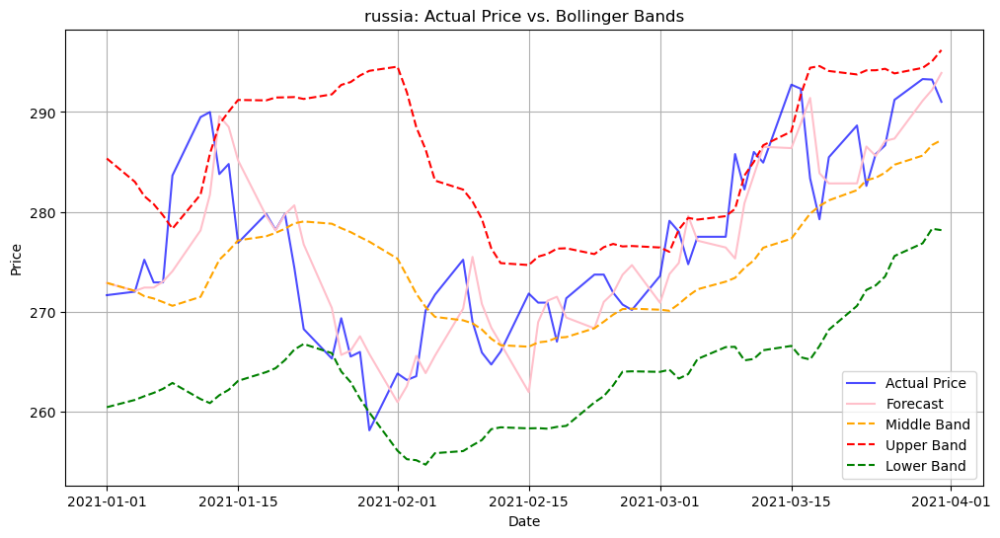

TURKEY:

 <<< -------------------------------------------------- >>> 



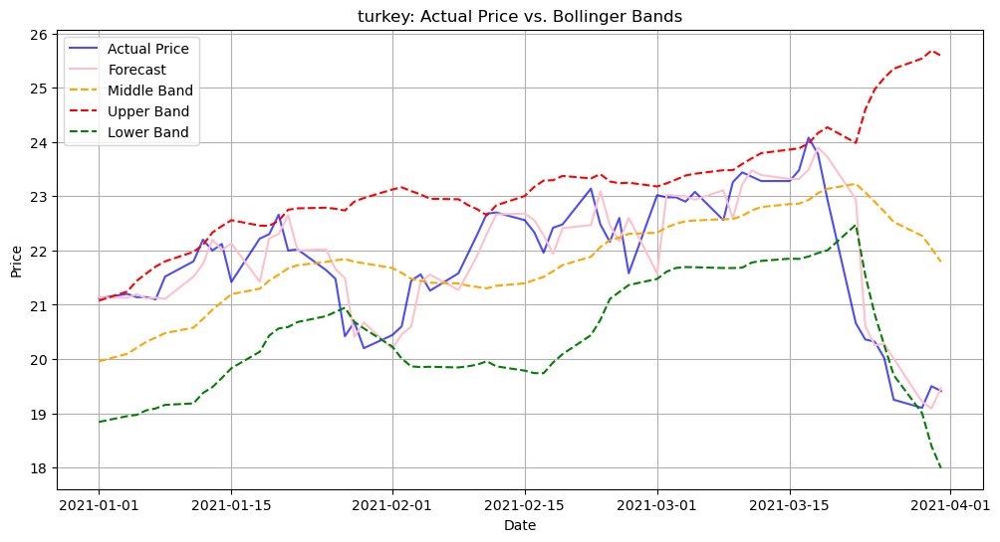

EGYPT:

 <<< -------------------------------------------------- >>> 



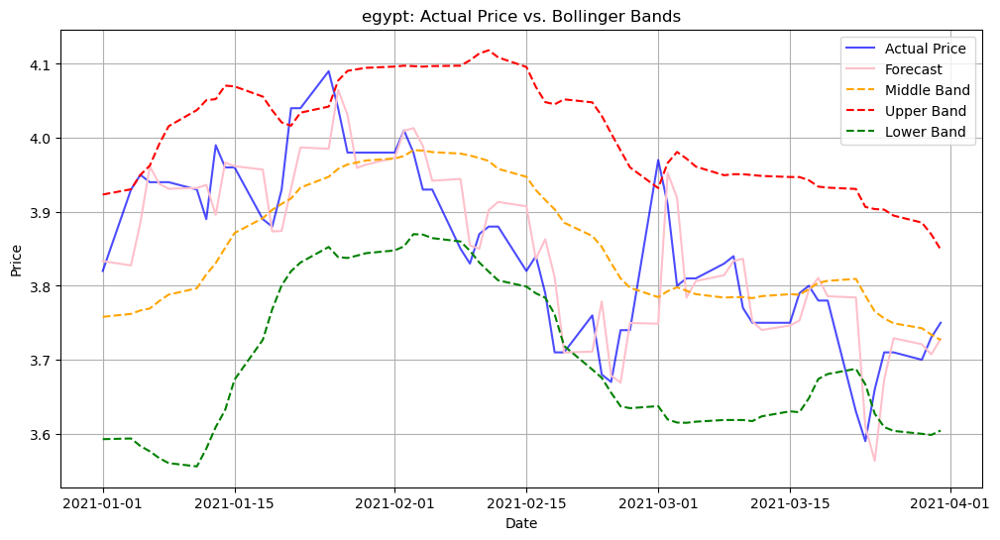

BRAZIL:

 <<< -------------------------------------------------- >>> 



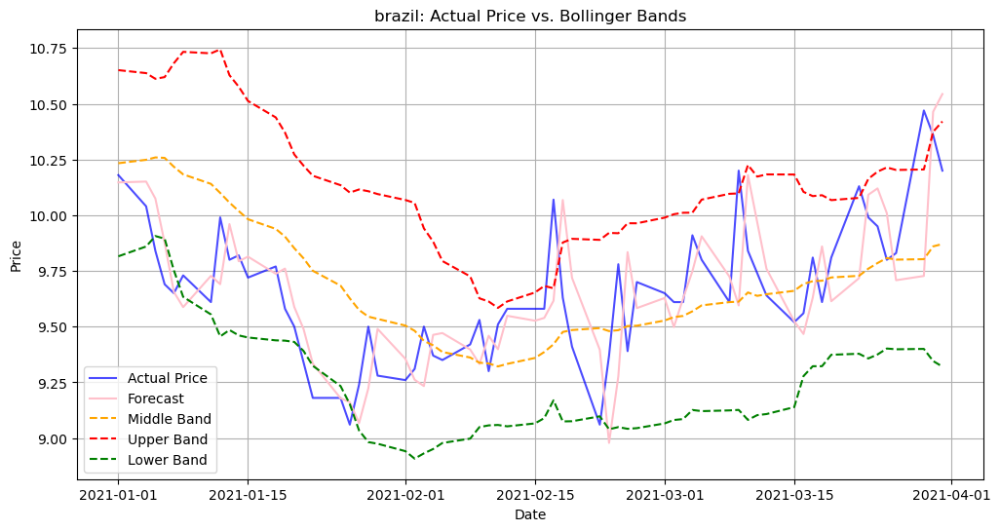

ARGENTINA:

 <<< -------------------------------------------------- >>> 



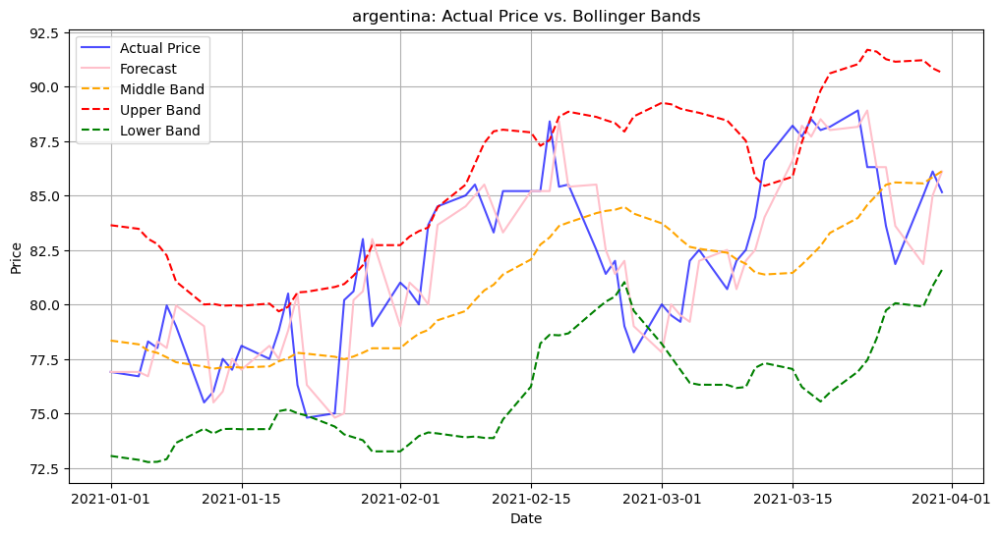

COLOMBIA:

 <<< -------------------------------------------------- >>> 



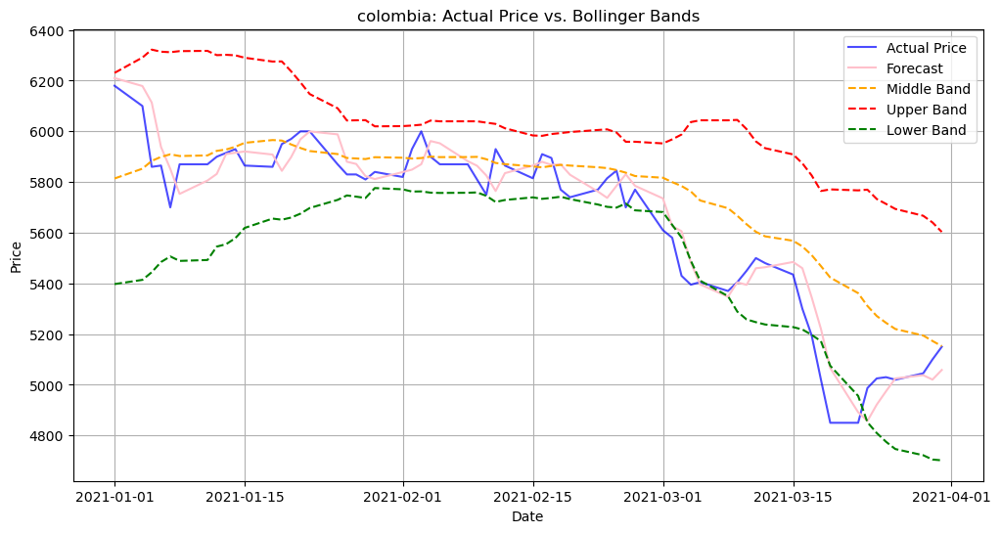

SA:

 <<< -------------------------------------------------- >>> 



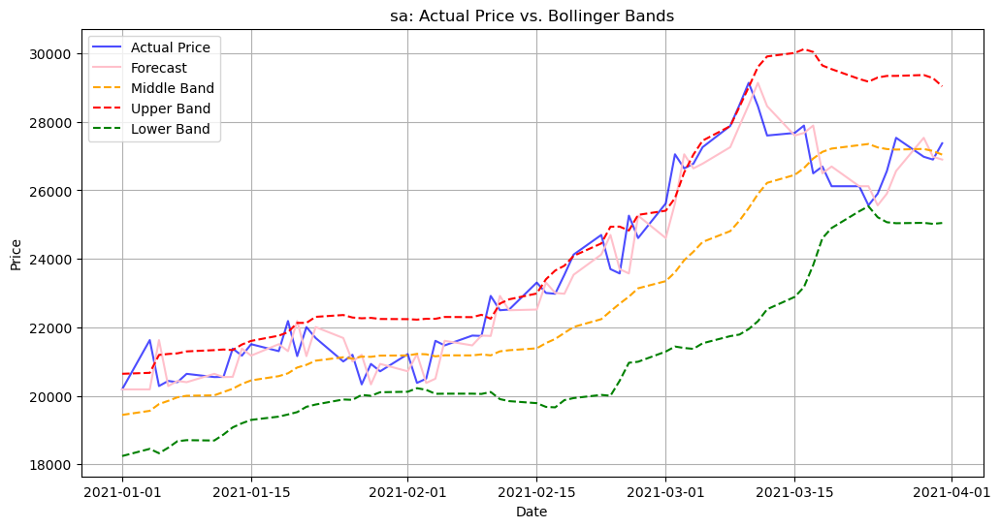

KOREA:

 <<< -------------------------------------------------- >>> 



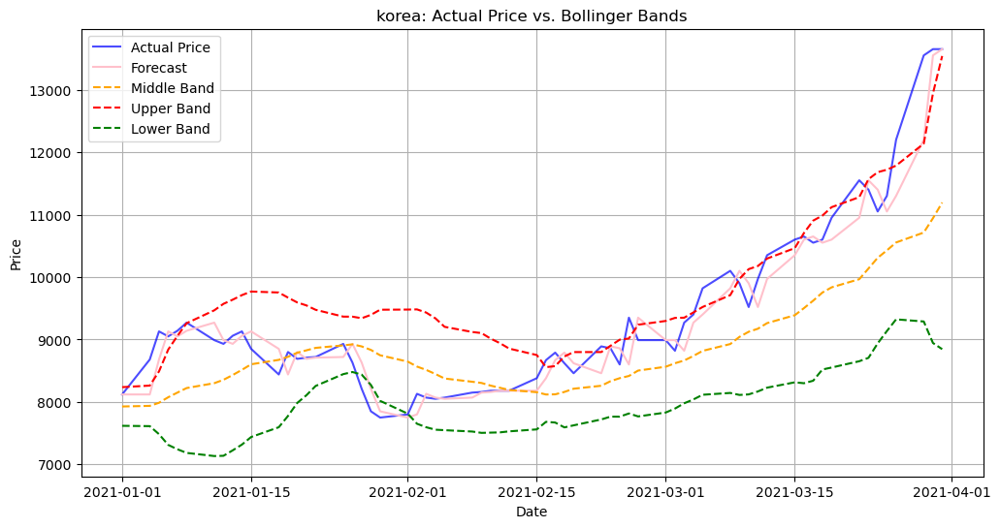

In [66]:
# Define the rolling window (typically 20 days) for the moving average and standard deviation
window = 15
plot = True

for key in data.keys():
    rslt = results[key]
    start_test = datetime(2021,1,1)
    end_test = datetime(2021,3,31)
    # Calculate the rolling mean (middle band) and rolling standard deviation
    tmp = data[key]["Price"].shift(1).rolling(window=window).mean()
    rslt["mid_band"] = tmp.loc[start_test:end_test]
    tmp = data[key]["Price"].shift(1).rolling(window=window).std()
    rslt["std_dev"] = tmp.loc[start_test:end_test]
    # Calculate the upper and lower bollinger Bands
    rslt["upper_band"] = rslt["mid_band"] + 2*rslt["std_dev"]
    rslt["lower_band"] = rslt["mid_band"] - 2*rslt["std_dev"]
    print_bold_underline(f"{key.upper()}:")
    barrier()
    if plot:
        date = rslt["mid_band"].index
        # Create a plot
        plt.figure(figsize=(12, 6))
        plt.plot(date, results[key]["Actual"], label="Actual Price", color="blue", alpha=0.7)
        plt.plot(date, results[key]["Forecast"], label="Forecast", color="pink")
        plt.plot(date, rslt["mid_band"], label="Middle Band", color="orange", linestyle="--")
        plt.plot(date, rslt["upper_band"], label="Upper Band", color="red", linestyle="--")
        plt.plot(date, rslt["lower_band"], label="Lower Band", color="green", linestyle="--")
        # Add labels and a legend
        plt.title(f"{key}: Actual Price vs. Bollinger Bands")
        plt.xlabel("Date")
        plt.ylabel("Price")
        plt.legend()
        # Show the plot
        plt.grid(True)
        plt.show()
    results[key] = rslt

In [67]:
display_for_all_keys(results)

RUSSIA:


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band
Date,,,,,,,,
2021-01-01,271.65,272.870382,267.425946,278.314818,272.885333,6.230736,285.346805,260.423862
2021-01-04,272.00,272.074975,266.638910,277.511040,272.080000,5.462207,283.004413,261.155587
2021-01-05,275.20,272.409133,266.983089,277.835176,271.550000,5.011101,281.572201,261.527799
2021-01-06,272.93,272.410079,266.981614,277.838545,271.316667,4.727874,280.772415,261.860918
2021-01-07,272.93,273.019983,267.601315,278.438651,270.955333,4.343433,279.642200,262.268467


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band
Date,,,,,,,,
2021-03-25,286.66,287.102765,281.636299,292.569231,283.926000,5.202032,294.330065,273.521935
2021-03-26,291.22,287.336977,281.875140,292.798815,284.720000,4.572239,293.864478,275.575522
2021-03-29,293.30,291.127333,285.673817,296.580849,285.634667,4.393563,294.421793,276.847540
2021-03-30,293.25,292.217299,286.770579,297.664019,286.688000,4.193442,295.074885,278.301115
2021-03-31,291.02,293.909365,288.469920,299.348810,287.185333,4.509773,296.204880,278.165787



 <<< -------------------------------------------------- >>> 

TURKEY:


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band
Date,,,,,,,,
2021-01-01,21.12,21.131333,8.764556,33.498110,19.958000,0.558802,21.075605,18.840395
2021-01-04,21.20,21.131460,8.764683,33.498237,20.096000,0.573944,21.243888,18.948112
2021-01-05,21.14,21.196451,8.829007,33.563895,20.206667,0.617468,21.441603,18.971731
2021-01-06,21.14,21.115874,8.747395,33.484354,20.314667,0.630327,21.575321,19.054012
2021-01-07,21.10,21.129954,8.761442,33.498465,20.396667,0.653503,21.703673,19.089660


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band
Date,,,,,,,,
2021-03-25,20.02,20.282383,5.505113,35.059652,22.718667,1.230760,25.180186,20.257147
2021-03-26,19.25,20.007809,5.220718,34.794900,22.526667,1.411780,25.350227,19.703106
2021-03-29,19.10,19.212467,4.342593,34.082342,22.271333,1.633493,25.538319,19.004348
2021-03-30,19.50,19.088600,4.216712,33.960488,22.040667,1.823107,25.686882,18.394452
2021-03-31,19.41,19.467366,4.577237,34.357495,21.790000,1.900335,25.590669,17.989331



 <<< -------------------------------------------------- >>> 

EGYPT:


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band
Date,,,,,,,,
2021-01-01,3.82,3.833321,3.665416,4.001226,3.758000,0.082652,3.923305,3.592695
2021-01-04,3.93,3.827565,3.659992,3.995139,3.762000,0.084194,3.930387,3.593613
2021-01-05,3.95,3.885462,3.718112,4.052812,3.766667,0.091626,3.949918,3.583416
2021-01-06,3.94,3.961233,3.794040,4.128427,3.769333,0.096545,3.962423,3.576243
2021-01-07,3.94,3.937795,3.770889,4.104702,3.779333,0.106131,3.991596,3.567071


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band
Date,,,,,,,,
2021-03-25,3.71,3.673023,3.515001,3.831045,3.756000,0.073465,3.902930,3.609070
2021-03-26,3.71,3.729126,3.571302,3.886950,3.749333,0.072749,3.894831,3.603836
2021-03-29,3.70,3.721001,3.563423,3.878580,3.742667,0.071361,3.885389,3.599945
2021-03-30,3.73,3.707282,3.549955,3.864610,3.734000,0.067802,3.869604,3.598396
2021-03-31,3.75,3.728166,3.571070,3.885261,3.726667,0.061140,3.848947,3.604387



 <<< -------------------------------------------------- >>> 

BRAZIL:


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band
Date,,,,,,,,
2021-01-01,10.18,10.147301,9.384132,10.910469,10.233333,0.208897,10.651128,9.815539
2021-01-04,10.04,10.150965,9.389245,10.912685,10.248667,0.194564,10.637795,9.859538
2021-01-05,9.84,10.074623,9.314236,10.835010,10.259333,0.176452,10.612237,9.906430
2021-01-06,9.69,9.875876,9.116345,10.635407,10.257333,0.181284,10.619901,9.894766
2021-01-07,9.65,9.655535,8.897111,10.413959,10.217333,0.232516,10.682366,9.752301


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band
Date,,,,,,,,
2021-03-25,9.80,10.009116,9.295394,10.722839,9.808000,0.203161,10.214321,9.401679
2021-03-26,9.83,9.708222,8.995271,10.421173,9.800667,0.201192,10.203050,9.398283
2021-03-29,10.47,9.727282,9.015292,10.439272,9.802667,0.201334,10.205334,9.399999
2021-03-30,10.36,10.464412,9.748930,11.179894,9.860000,0.257238,10.374476,9.345524
2021-03-31,10.20,10.543781,9.829290,11.258272,9.870667,0.275045,10.420756,9.320577



 <<< -------------------------------------------------- >>> 

ARGENTINA:


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band
Date,,,,,,,,
2021-01-01,76.90,76.9,72.996536,80.803464,78.340000,2.647114,83.634229,73.045771
2021-01-04,76.70,76.9,73.004021,80.795979,78.166667,2.650853,83.468373,72.864960
2021-01-05,78.30,76.7,72.811388,80.588612,77.886667,2.561840,83.010347,72.762987
2021-01-06,78.00,78.3,74.413974,82.186026,77.773333,2.498490,82.770313,72.776353
2021-01-07,79.95,78.0,74.121172,81.878828,77.573333,2.336578,82.246489,72.900178


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band
Date,,,,,,,,
2021-03-25,83.60,86.30,82.447351,90.152649,85.490000,2.881480,91.252961,79.727039
2021-03-26,81.85,83.60,79.742017,87.457983,85.596667,2.770538,91.137743,80.055591
2021-03-29,85.00,81.85,77.993276,85.706724,85.553333,2.826941,91.207215,79.899451
2021-03-30,86.10,85.00,81.133930,88.866070,85.840000,2.498585,90.837171,80.842829
2021-03-31,85.15,86.10,82.238056,89.961944,86.113333,2.261516,90.636364,81.590302



 <<< -------------------------------------------------- >>> 

COLOMBIA:


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band
Date,,,,,,,,
2021-01-01,6180.0,6210.295161,5936.458656,6484.131666,5814.000000,208.345523,6230.691047,5397.308953
2021-01-04,6100.0,6178.894583,5905.548258,6452.240907,5852.666667,219.324178,6291.315023,5414.018310
2021-01-05,5860.0,6113.841861,5841.058946,6386.624775,5883.333333,219.623596,6322.580525,5444.086142
2021-01-06,5865.0,5938.525281,5665.416495,6211.634067,5899.333333,207.475185,6314.283703,5484.382963
2021-01-07,5700.0,5851.921470,5579.338639,6124.504300,5909.333333,201.484373,6312.302078,5506.364588


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band
Date,,,,,,,,
2021-03-25,5030.0,4974.250866,4717.123916,5231.377816,5244.466667,234.651677,5713.770021,4775.163313
2021-03-26,5020.0,5025.120925,4768.374329,5281.867522,5220.133333,236.841377,5693.816088,4746.450578
2021-03-29,5045.0,5037.805934,4781.432673,5294.179195,5194.466667,236.236826,5666.940319,4721.993014
2021-03-30,5100.0,5020.471024,4764.446646,5276.495403,5172.800000,233.879762,5640.559523,4705.040477
2021-03-31,5150.0,5058.575920,4802.778417,5314.373423,5152.466667,225.353331,5603.173329,4701.760005



 <<< -------------------------------------------------- >>> 

SA:


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band
Date,,,,,,,,
2021-01-01,20190.0,20190.0,18925.550632,21454.449368,19445.000000,600.214366,20645.428733,18244.571267
2021-01-04,21629.0,20190.0,18927.966010,21452.033990,19563.866667,554.800076,20673.466818,18454.266516
2021-01-05,20288.0,21629.0,20357.418555,22900.581445,19760.866667,717.138248,21195.143163,18326.590171
2021-01-06,20436.0,20288.0,19008.562065,21567.437935,19855.333333,684.114095,21223.561524,18487.105143
2021-01-07,20400.0,20436.0,19158.854065,21713.145935,19959.666667,641.268237,21242.203142,18677.130192


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band
Date,,,,,,,,
2021-03-25,26564.0,25903.0,24624.053209,27181.946791,27204.333333,1067.600625,29339.534584,25069.132083
2021-03-26,27533.0,26564.0,25285.001194,27842.998806,27190.066667,1075.108265,29340.283196,25039.850137
2021-03-29,26980.0,27533.0,26251.610323,28814.389677,27208.266667,1078.681501,29365.629669,25050.903664
2021-03-30,26898.0,26980.0,25699.174859,28260.825141,27148.266667,1063.573254,29275.413175,25021.120159
2021-03-31,27373.0,26898.0,25619.121799,28176.878201,27042.066667,997.395069,29036.856805,25047.276529



 <<< -------------------------------------------------- >>> 

KOREA:


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band
Date,,,,,,,,
2021-01-01,8120.0,8120.0,7693.665804,8546.334196,7927.333333,154.756337,8236.846007,7617.820660
2021-01-04,8680.0,8120.0,7694.483317,8545.516683,7937.333333,162.369361,8262.072056,7612.594611
2021-01-05,9130.0,8680.0,8249.917007,9110.082993,7986.666667,251.301375,8489.269416,7484.063917
2021-01-06,9050.0,9130.0,8697.303981,9562.696019,8075.333333,381.591904,8838.517141,7312.149526
2021-01-07,9140.0,9050.0,8618.016454,9481.983546,8150.000000,453.856491,9057.712982,7242.287018


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band
Date,,,,,,,,
2021-03-25,11300.0,11050.0,10600.309548,11499.690452,10427.333333,645.837957,11719.009247,9135.657419
2021-03-26,12200.0,11300.0,10850.177978,11749.822022,10554.000000,615.569423,11785.138846,9322.861154
2021-03-29,13550.0,12200.0,11740.214279,12659.785721,10712.666667,712.033975,12136.734616,9288.598718
2021-03-30,13650.0,13550.0,13067.829088,14032.170912,10942.666667,999.267351,12941.201368,8944.131965
2021-03-31,13650.0,13650.0,13168.452552,14131.547448,11192.666667,1173.654042,13539.974750,8845.358583



 <<< -------------------------------------------------- >>> 



In [68]:
with open("../data/results_rfo_final_bb.pkl", "wb") as handle:
    pickle.dump(results, handle)

### Threshold tuning

- We want to tune the investment threshold in order to maximize profit.
- We are going to use the training data for this goal.

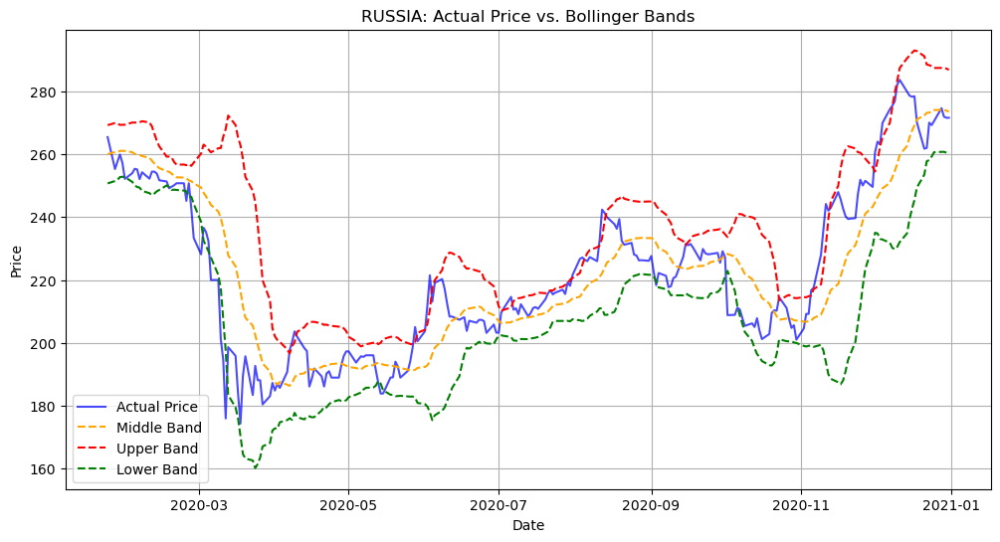

Best performance for RUSSIA:
Best threshold: 0.5
Best profit: 1163.7900000000081
Number of trades: 25

 <<< -------------------------------------------------- >>> 



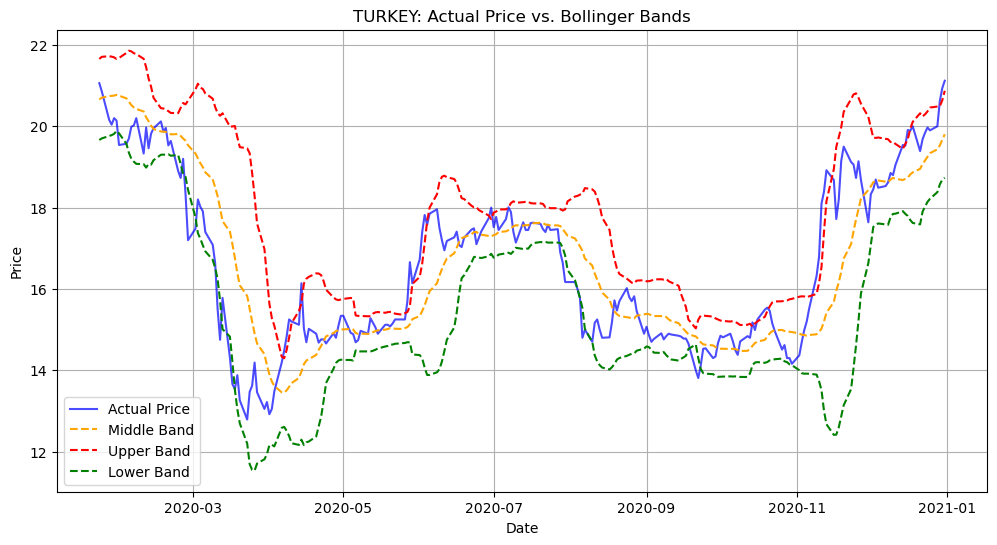

Best performance for TURKEY:
Best threshold: -0.5
Best profit: -20004.679999999993
Number of trades: 79

 <<< -------------------------------------------------- >>> 



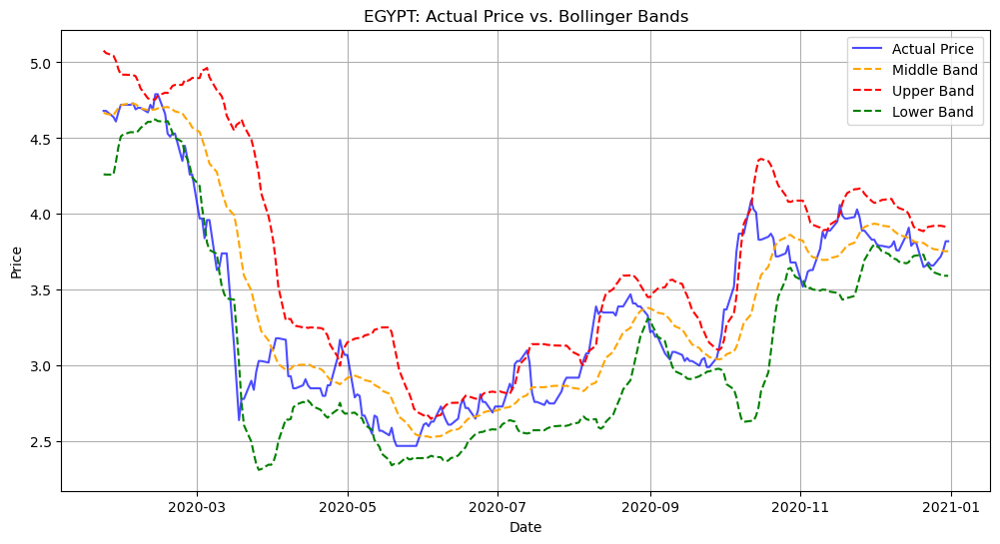

Best performance for EGYPT:
Best threshold: 0.0
Best profit: -12373.699999999997
Number of trades: 50

 <<< -------------------------------------------------- >>> 



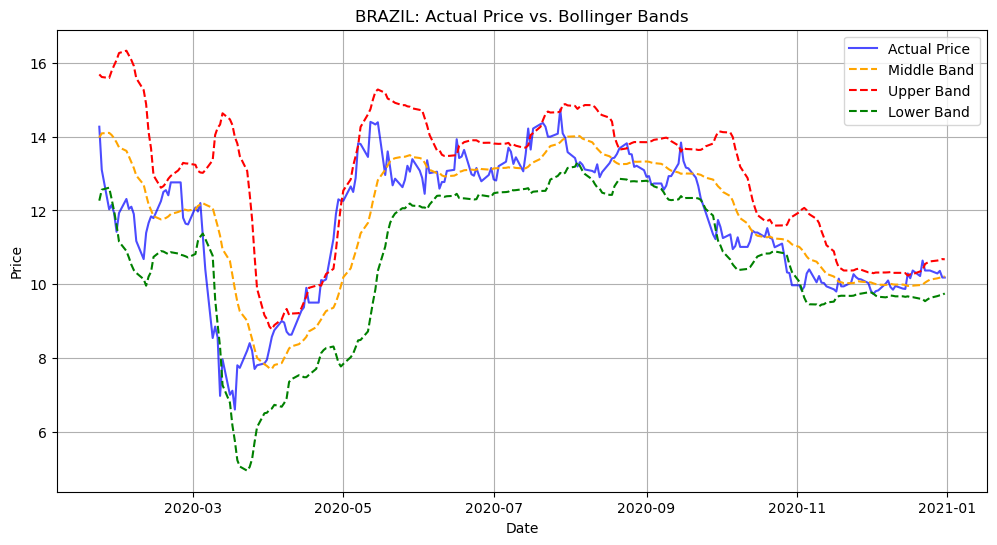

Best performance for BRAZIL:
Best threshold: 0.5
Best profit: -14709.119999999995
Number of trades: 19

 <<< -------------------------------------------------- >>> 



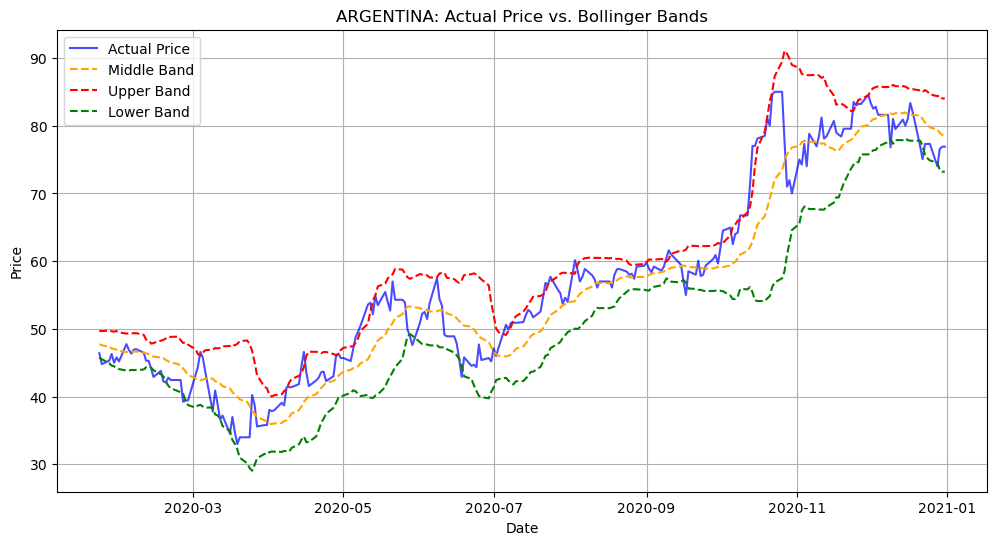

Best performance for ARGENTINA:
Best threshold: -0.3
Best profit: 68407.00000000006
Number of trades: 66

 <<< -------------------------------------------------- >>> 



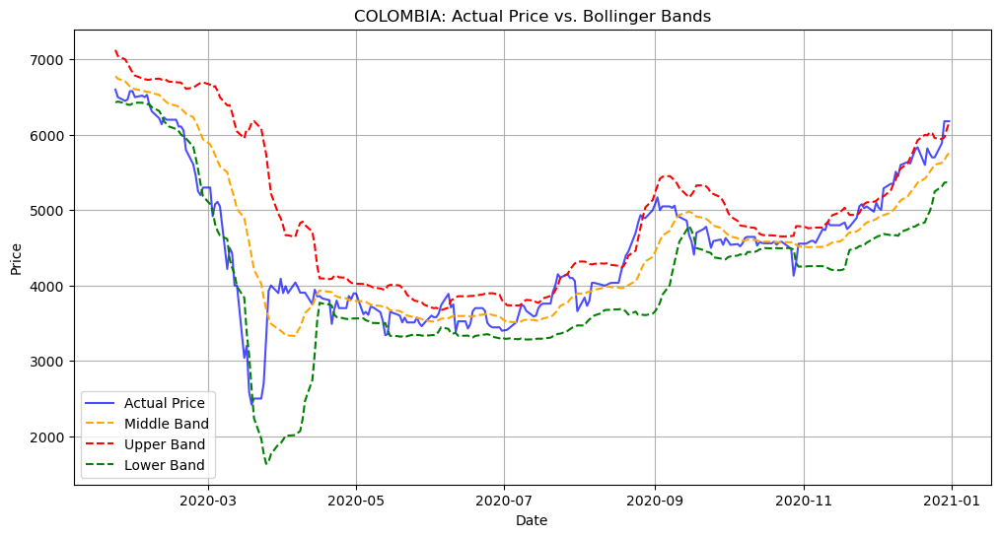

Best performance for COLOMBIA:
Best threshold: -0.3
Best profit: -32795.0
Number of trades: 62

 <<< -------------------------------------------------- >>> 



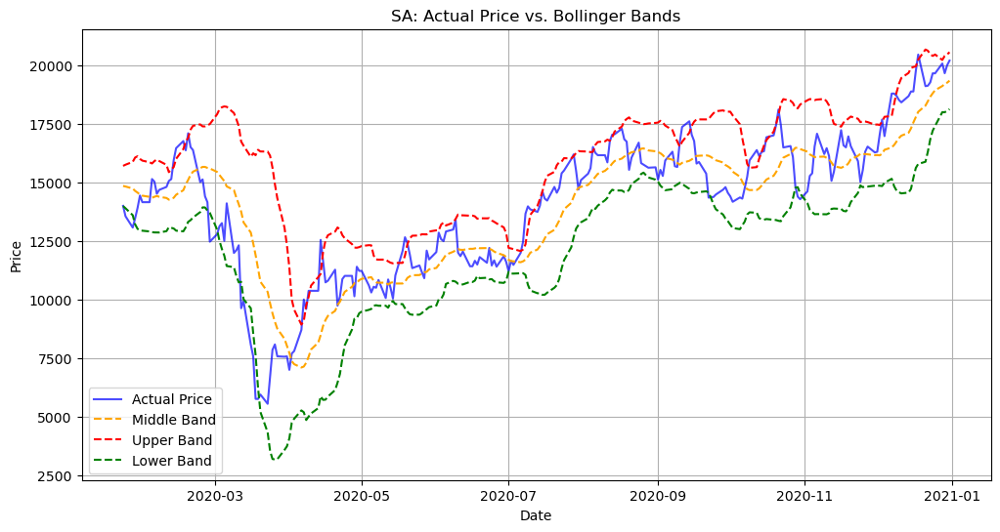

Best performance for SA:
Best threshold: -0.3
Best profit: 67641.0
Number of trades: 70

 <<< -------------------------------------------------- >>> 



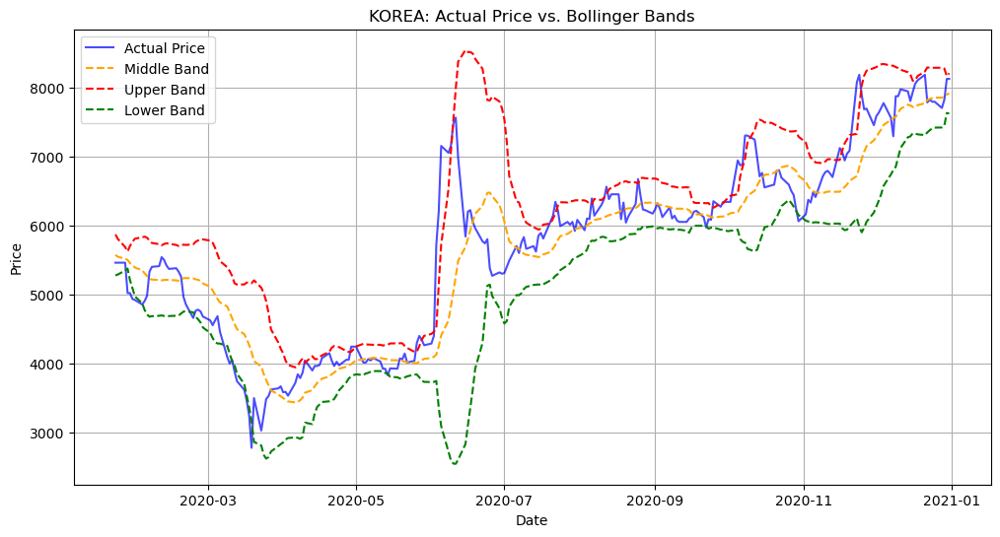

Best performance for KOREA:
Best threshold: -0.4
Best profit: 19615.0
Number of trades: 67

 <<< -------------------------------------------------- >>> 



In [69]:
# Define the rolling window (typically 20 days) for the moving average and standard deviation
plot = True
window = 15
thresholds = [-0.5, -0.4, -0.3, -0.2, -0.1, 0.0, 0.1, 0.2, 0.3, 0.4, 0.5]
end_train = datetime(2020,12,31)
best_thresh = {}

for key in data.keys():
    bands = {}
    best_profit = -100000000
    best_trades = -1
    true_price = data[key]["Price"]
    # Calculate the rolling mean (middle band) and rolling standard deviation
    tmp = true_price.shift(1).rolling(window=window).mean()
    bands["mid_band"] = tmp.loc[:end_train]
    tmp = true_price.shift(1).rolling(window=window).std()
    bands["std_dev"] = tmp.loc[:end_train]
    # Remove the NaN and align the different DFs
    nan_indices = np.isnan(bands["mid_band"])
    true_price = true_price.loc[:end_train]
    true_price = true_price[~nan_indices]
    bands["mid_band"] = bands["mid_band"][~nan_indices]
    bands["std_dev"] = bands["std_dev"][~nan_indices]
    # Calculate the upper and lower bollinger Bands
    bands["upper_band"] = bands["mid_band"] + 2*bands["std_dev"]
    bands["lower_band"] = bands["mid_band"] - 2*bands["std_dev"]
    if plot:
        date = bands["mid_band"].index
        # Create a plot
        plt.figure(figsize=(12, 6))
        plt.plot(date, true_price, label="Actual Price", color="blue", alpha=0.7)
        plt.plot(date, bands["mid_band"], label="Middle Band", color="orange", linestyle="--")
        plt.plot(date, bands["upper_band"], label="Upper Band", color="red", linestyle="--")
        plt.plot(date, bands["lower_band"], label="Lower Band", color="green", linestyle="--")
        # Add labels and a legend
        plt.title(f"{key.upper()}: Actual Price vs. Bollinger Bands")
        plt.xlabel("Date")
        plt.ylabel("Price")
        plt.legend()
        # Show the plot
        plt.grid(True)
        plt.show()
    # For each threshold value
    for thresh in thresholds:
        # Initialize variables for tracking trades and profit
        initial_cash = 100000 # Replace with your initial investment amount
        cash = initial_cash
        stocks = 0
        total_trades = 0
        profit = 0
        # Generate trading signals based on Price and Bollinger Bands & simulate an investment
        for i in range(len(bands["lower_band"])):
            # Investment strategy: we are using the true_price to test the investment strategy
            if true_price.iloc[i] > bands["upper_band"].iloc[i] + thresh*bands["std_dev"].iloc[i]:
                # Sell all owned stocks at the "Price" on that day
                cash += stocks*true_price.iloc[i]
                stocks = 0
                total_trades += 1
            elif true_price.iloc[i] < bands["lower_band"].iloc[i] - thresh*bands["std_dev"].iloc[i]:
                # Calculate how many stocks you can buy with available cash at the "Price" on that day
                num_stocks_bought = cash//true_price.iloc[i]
                stocks += num_stocks_bought
                cash -= num_stocks_bought*true_price.iloc[i]
                total_trades += 1
            else:
                # Hold
                pass
        # Calculate the final profit by considering the remaining stocks at the last day's price
        final_portfolio_value = cash + stocks*true_price[end_train]
        profit = final_portfolio_value - initial_cash
        if profit > best_profit:
            best_thresh[key] = thresh
            best_profit = profit
            best_trades = total_trades
    print_bold_underline(f"Best performance for {key.upper()}:")
    print(f"Best threshold: {best_thresh[key]}")
    print(f"Best profit: {best_profit}")
    print(f"Number of trades: {best_trades}")
    barrier()

In [70]:
best_thresh

{'russia': 0.5,
 'turkey': -0.5,
 'egypt': 0.0,
 'brazil': 0.5,
 'argentina': -0.3,
 'colombia': -0.3,
 'sa': -0.3,
 'korea': -0.4}

**NOTE:**
- The above tuning is not reliable.
- Hence, we do some manual tuning based on the Bollinger Bands computed on the test set.
- For example, we see that South Africa and Turkey stocks are for long periods of time on one external band.
- In order to generate meaningful signals we need to narrow down a lot the outer bands so that we can BUY and SELL (otherwise it would just be one of the two).
- On the other hand, some countries like Brazil or South Korea have the price close to the midband and oscillates quite a lot outside the outer bands. Hence, to make a meaningful investment signal we need to expand the bands.

### Evaluation

In [71]:
best_thresh = {"brazil":0.2,"sa":-0.5,"argentina":-0.3,"russia":-0.3,"turkey":-0.5,"egypt":-0.3,"korea":0.3,
               "colombia":0.3}

In [72]:
for key in data.keys():
    rslt = results[key]
    # Create a column to hold trading signals
    rslt["Signal"] = None
    # Initialize variables for tracking trades and profit
    initial_cash = 100000    # Replace with your initial investment amount
    cash = initial_cash
    stocks = 0
    total_trades = 0
    profit = 0
    # Generate trading signals based on forecasts and Bollinger Bands
    for i in range(len(rslt)):
        if rslt["Forecast"].iloc[i] > rslt["upper_band"].iloc[i] + best_thresh[key]*rslt["std_dev"].iloc[i]:
            rslt["Signal"].iloc[i] = "SELL"
            # Sell all owned stocks at the "Price" on that day
            cash += stocks*rslt["Actual"].iloc[i]
            stocks = 0
            total_trades += 1
        elif rslt["Forecast"].iloc[i] < rslt["lower_band"].iloc[i] - best_thresh[key]*rslt["std_dev"].iloc[i]:
            rslt["Signal"].iloc[i] = "BUY"
            # Calculate how many stocks you can buy with available cash at the "Price" on that day
            num_stocks_bought = cash//rslt["Actual"].iloc[i]
            stocks += num_stocks_bought
            cash -= num_stocks_bought*rslt["Actual"].iloc[i]
            total_trades += 1
        else:
                rslt["Signal"].iloc[i] = "HOLD"
                pass
    # Store the new dataframe with investment signals
    results[key] = rslt
    # Calculate the final profit by considering the remaining stocks at the last day's price
    final_portfolio_value = cash + stocks * rslt["Actual"].iloc[-1]
    profit = final_portfolio_value - initial_cash
    # Print the results
    print_bold_underline(f"For country {key.upper()}, the investment strategy performed as follow:")
    print(f"Total Profit: $ {round(profit, 2)}")
    print(f"Profit percent: {round((profit/initial_cash)*100, 2)}%")
    print(f"Total Trades: {total_trades}")
    barrier()

For country RUSSIA, the investment strategy performed as follow:
Total Profit: $ 2007.11
Profit percent: 2.01%
Total Trades: 6

 <<< -------------------------------------------------- >>> 

For country TURKEY, the investment strategy performed as follow:
Total Profit: $ 6191.32
Profit percent: 6.19%
Total Trades: 22

 <<< -------------------------------------------------- >>> 

For country EGYPT, the investment strategy performed as follow:
Total Profit: $ 6638.48
Profit percent: 6.64%
Total Trades: 10

 <<< -------------------------------------------------- >>> 

For country BRAZIL, the investment strategy performed as follow:
Total Profit: $ 10336.26
Profit percent: 10.34%
Total Trades: 6

 <<< -------------------------------------------------- >>> 

For country ARGENTINA, the investment strategy performed as follow:
Total Profit: $ 19403.2
Profit percent: 19.4%
Total Trades: 9

 <<< -------------------------------------------------- >>> 

For country COLOMBIA, the investment strateg

**NOTE:**
- All the investment strategies bring **positive returns**, many of which in the order of magnitude of 10%.

In [73]:
display_for_all_keys(results)

RUSSIA:


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band,Signal
Date,,,,,,,,,
2021-01-01,271.65,272.870382,267.425946,278.314818,272.885333,6.230736,285.346805,260.423862,HOLD
2021-01-04,272.00,272.074975,266.638910,277.511040,272.080000,5.462207,283.004413,261.155587,HOLD
2021-01-05,275.20,272.409133,266.983089,277.835176,271.550000,5.011101,281.572201,261.527799,HOLD
2021-01-06,272.93,272.410079,266.981614,277.838545,271.316667,4.727874,280.772415,261.860918,HOLD
2021-01-07,272.93,273.019983,267.601315,278.438651,270.955333,4.343433,279.642200,262.268467,HOLD


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band,Signal
Date,,,,,,,,,
2021-03-25,286.66,287.102765,281.636299,292.569231,283.926000,5.202032,294.330065,273.521935,HOLD
2021-03-26,291.22,287.336977,281.875140,292.798815,284.720000,4.572239,293.864478,275.575522,HOLD
2021-03-29,293.30,291.127333,285.673817,296.580849,285.634667,4.393563,294.421793,276.847540,HOLD
2021-03-30,293.25,292.217299,286.770579,297.664019,286.688000,4.193442,295.074885,278.301115,HOLD
2021-03-31,291.02,293.909365,288.469920,299.348810,287.185333,4.509773,296.204880,278.165787,HOLD



 <<< -------------------------------------------------- >>> 

TURKEY:


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band,Signal
Date,,,,,,,,,
2021-01-01,21.12,21.131333,8.764556,33.498110,19.958000,0.558802,21.075605,18.840395,SELL
2021-01-04,21.20,21.131460,8.764683,33.498237,20.096000,0.573944,21.243888,18.948112,SELL
2021-01-05,21.14,21.196451,8.829007,33.563895,20.206667,0.617468,21.441603,18.971731,SELL
2021-01-06,21.14,21.115874,8.747395,33.484354,20.314667,0.630327,21.575321,19.054012,HOLD
2021-01-07,21.10,21.129954,8.761442,33.498465,20.396667,0.653503,21.703673,19.089660,HOLD


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band,Signal
Date,,,,,,,,,
2021-03-25,20.02,20.282383,5.505113,35.059652,22.718667,1.230760,25.180186,20.257147,BUY
2021-03-26,19.25,20.007809,5.220718,34.794900,22.526667,1.411780,25.350227,19.703106,BUY
2021-03-29,19.10,19.212467,4.342593,34.082342,22.271333,1.633493,25.538319,19.004348,BUY
2021-03-30,19.50,19.088600,4.216712,33.960488,22.040667,1.823107,25.686882,18.394452,BUY
2021-03-31,19.41,19.467366,4.577237,34.357495,21.790000,1.900335,25.590669,17.989331,HOLD



 <<< -------------------------------------------------- >>> 

EGYPT:


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band,Signal
Date,,,,,,,,,
2021-01-01,3.82,3.833321,3.665416,4.001226,3.758000,0.082652,3.923305,3.592695,HOLD
2021-01-04,3.93,3.827565,3.659992,3.995139,3.762000,0.084194,3.930387,3.593613,HOLD
2021-01-05,3.95,3.885462,3.718112,4.052812,3.766667,0.091626,3.949918,3.583416,HOLD
2021-01-06,3.94,3.961233,3.794040,4.128427,3.769333,0.096545,3.962423,3.576243,SELL
2021-01-07,3.94,3.937795,3.770889,4.104702,3.779333,0.106131,3.991596,3.567071,HOLD


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band,Signal
Date,,,,,,,,,
2021-03-25,3.71,3.673023,3.515001,3.831045,3.756000,0.073465,3.902930,3.609070,HOLD
2021-03-26,3.71,3.729126,3.571302,3.886950,3.749333,0.072749,3.894831,3.603836,HOLD
2021-03-29,3.70,3.721001,3.563423,3.878580,3.742667,0.071361,3.885389,3.599945,HOLD
2021-03-30,3.73,3.707282,3.549955,3.864610,3.734000,0.067802,3.869604,3.598396,HOLD
2021-03-31,3.75,3.728166,3.571070,3.885261,3.726667,0.061140,3.848947,3.604387,HOLD



 <<< -------------------------------------------------- >>> 

BRAZIL:


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band,Signal
Date,,,,,,,,,
2021-01-01,10.18,10.147301,9.384132,10.910469,10.233333,0.208897,10.651128,9.815539,HOLD
2021-01-04,10.04,10.150965,9.389245,10.912685,10.248667,0.194564,10.637795,9.859538,HOLD
2021-01-05,9.84,10.074623,9.314236,10.835010,10.259333,0.176452,10.612237,9.906430,HOLD
2021-01-06,9.69,9.875876,9.116345,10.635407,10.257333,0.181284,10.619901,9.894766,HOLD
2021-01-07,9.65,9.655535,8.897111,10.413959,10.217333,0.232516,10.682366,9.752301,BUY


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band,Signal
Date,,,,,,,,,
2021-03-25,9.80,10.009116,9.295394,10.722839,9.808000,0.203161,10.214321,9.401679,HOLD
2021-03-26,9.83,9.708222,8.995271,10.421173,9.800667,0.201192,10.203050,9.398283,HOLD
2021-03-29,10.47,9.727282,9.015292,10.439272,9.802667,0.201334,10.205334,9.399999,HOLD
2021-03-30,10.36,10.464412,9.748930,11.179894,9.860000,0.257238,10.374476,9.345524,SELL
2021-03-31,10.20,10.543781,9.829290,11.258272,9.870667,0.275045,10.420756,9.320577,SELL



 <<< -------------------------------------------------- >>> 

ARGENTINA:


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band,Signal
Date,,,,,,,,,
2021-01-01,76.90,76.9,72.996536,80.803464,78.340000,2.647114,83.634229,73.045771,HOLD
2021-01-04,76.70,76.9,73.004021,80.795979,78.166667,2.650853,83.468373,72.864960,HOLD
2021-01-05,78.30,76.7,72.811388,80.588612,77.886667,2.561840,83.010347,72.762987,HOLD
2021-01-06,78.00,78.3,74.413974,82.186026,77.773333,2.498490,82.770313,72.776353,HOLD
2021-01-07,79.95,78.0,74.121172,81.878828,77.573333,2.336578,82.246489,72.900178,HOLD


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band,Signal
Date,,,,,,,,,
2021-03-25,83.60,86.30,82.447351,90.152649,85.490000,2.881480,91.252961,79.727039,HOLD
2021-03-26,81.85,83.60,79.742017,87.457983,85.596667,2.770538,91.137743,80.055591,HOLD
2021-03-29,85.00,81.85,77.993276,85.706724,85.553333,2.826941,91.207215,79.899451,HOLD
2021-03-30,86.10,85.00,81.133930,88.866070,85.840000,2.498585,90.837171,80.842829,HOLD
2021-03-31,85.15,86.10,82.238056,89.961944,86.113333,2.261516,90.636364,81.590302,HOLD



 <<< -------------------------------------------------- >>> 

COLOMBIA:


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band,Signal
Date,,,,,,,,,
2021-01-01,6180.0,6210.295161,5936.458656,6484.131666,5814.000000,208.345523,6230.691047,5397.308953,HOLD
2021-01-04,6100.0,6178.894583,5905.548258,6452.240907,5852.666667,219.324178,6291.315023,5414.018310,HOLD
2021-01-05,5860.0,6113.841861,5841.058946,6386.624775,5883.333333,219.623596,6322.580525,5444.086142,HOLD
2021-01-06,5865.0,5938.525281,5665.416495,6211.634067,5899.333333,207.475185,6314.283703,5484.382963,HOLD
2021-01-07,5700.0,5851.921470,5579.338639,6124.504300,5909.333333,201.484373,6312.302078,5506.364588,HOLD


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band,Signal
Date,,,,,,,,,
2021-03-25,5030.0,4974.250866,4717.123916,5231.377816,5244.466667,234.651677,5713.770021,4775.163313,HOLD
2021-03-26,5020.0,5025.120925,4768.374329,5281.867522,5220.133333,236.841377,5693.816088,4746.450578,HOLD
2021-03-29,5045.0,5037.805934,4781.432673,5294.179195,5194.466667,236.236826,5666.940319,4721.993014,HOLD
2021-03-30,5100.0,5020.471024,4764.446646,5276.495403,5172.800000,233.879762,5640.559523,4705.040477,HOLD
2021-03-31,5150.0,5058.575920,4802.778417,5314.373423,5152.466667,225.353331,5603.173329,4701.760005,HOLD



 <<< -------------------------------------------------- >>> 

SA:


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band,Signal
Date,,,,,,,,,
2021-01-01,20190.0,20190.0,18925.550632,21454.449368,19445.000000,600.214366,20645.428733,18244.571267,HOLD
2021-01-04,21629.0,20190.0,18927.966010,21452.033990,19563.866667,554.800076,20673.466818,18454.266516,HOLD
2021-01-05,20288.0,21629.0,20357.418555,22900.581445,19760.866667,717.138248,21195.143163,18326.590171,SELL
2021-01-06,20436.0,20288.0,19008.562065,21567.437935,19855.333333,684.114095,21223.561524,18487.105143,HOLD
2021-01-07,20400.0,20436.0,19158.854065,21713.145935,19959.666667,641.268237,21242.203142,18677.130192,HOLD


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band,Signal
Date,,,,,,,,,
2021-03-25,26564.0,25903.0,24624.053209,27181.946791,27204.333333,1067.600625,29339.534584,25069.132083,HOLD
2021-03-26,27533.0,26564.0,25285.001194,27842.998806,27190.066667,1075.108265,29340.283196,25039.850137,HOLD
2021-03-29,26980.0,27533.0,26251.610323,28814.389677,27208.266667,1078.681501,29365.629669,25050.903664,HOLD
2021-03-30,26898.0,26980.0,25699.174859,28260.825141,27148.266667,1063.573254,29275.413175,25021.120159,HOLD
2021-03-31,27373.0,26898.0,25619.121799,28176.878201,27042.066667,997.395069,29036.856805,25047.276529,HOLD



 <<< -------------------------------------------------- >>> 

KOREA:


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band,Signal
Date,,,,,,,,,
2021-01-01,8120.0,8120.0,7693.665804,8546.334196,7927.333333,154.756337,8236.846007,7617.820660,HOLD
2021-01-04,8680.0,8120.0,7694.483317,8545.516683,7937.333333,162.369361,8262.072056,7612.594611,HOLD
2021-01-05,9130.0,8680.0,8249.917007,9110.082993,7986.666667,251.301375,8489.269416,7484.063917,SELL
2021-01-06,9050.0,9130.0,8697.303981,9562.696019,8075.333333,381.591904,8838.517141,7312.149526,SELL
2021-01-07,9140.0,9050.0,8618.016454,9481.983546,8150.000000,453.856491,9057.712982,7242.287018,HOLD


,Actual,Forecast,Conf Int low,Conf Int high,mid_band,std_dev,upper_band,lower_band,Signal
Date,,,,,,,,,
2021-03-25,11300.0,11050.0,10600.309548,11499.690452,10427.333333,645.837957,11719.009247,9135.657419,HOLD
2021-03-26,12200.0,11300.0,10850.177978,11749.822022,10554.000000,615.569423,11785.138846,9322.861154,HOLD
2021-03-29,13550.0,12200.0,11740.214279,12659.785721,10712.666667,712.033975,12136.734616,9288.598718,HOLD
2021-03-30,13650.0,13550.0,13067.829088,14032.170912,10942.666667,999.267351,12941.201368,8944.131965,SELL
2021-03-31,13650.0,13650.0,13168.452552,14131.547448,11192.666667,1173.654042,13539.974750,8845.358583,HOLD



 <<< -------------------------------------------------- >>> 



In [74]:
with open("../data/results_rfo_final_bb_signal.pkl", "wb") as handle:
    pickle.dump(results, handle)

In [75]:
best_thresh

{'brazil': 0.2,
 'sa': -0.5,
 'argentina': -0.3,
 'russia': -0.3,
 'turkey': -0.5,
 'egypt': -0.3,
 'korea': 0.3,
 'colombia': 0.3}

In [76]:
with open("../data/best_thresh_bb.pkl", "wb") as handle:
    pickle.dump(best_thresh, handle)